In [15]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.


In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
from sklearn.preprocessing import StandardScaler

In [17]:
print(pd.__version__)
print(np.__version__)

2.2.3
2.1.2


In [18]:
path = r'K:\SPARTA\학습자료\Python\marketing_project'
os.chdir(path)

In [19]:
# 데이터 불러오기
data_cleaned_df = pd.read_csv('capstone_data_cleaned.csv')

In [20]:
# 데이터 상태 확인
data_cleaned_df.T

,0,1,2,3,4,5,6,7,8,9,...,119604,119605,119606,119607,119608,119609,119610,119611,119612,119613
order_id,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,69923a4e07ce446644394df37a710286,69923a4e07ce446644394df37a710286,128e10d95713541c87cd1a2e48201934,0e7e841ddf8f8f2de2bad69267ecfbcf,...,9b7fd5b0ef330dcbbb6397e5971faeec,aa07fc0f496d65986abc9044683b8800,5597332b7eded552f104108f22b023e4,add4f182072426430ee6c993eab97efe,87b4c933f31145a28413b39d880ad6c3,e8fd20068b9f7e6ec07068bb7537f781,e8fd20068b9f7e6ec07068bb7537f781,cfa78b997e329a5295b4ee6972c02979,9c5dedf39a927c1b2549525ed64a053c,66dea50a8b16d9b4dee7af250b4be1a5
customer_id,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,3a51803cc0d012c3b5dc8b7528cb05f7,ef0996a1a279c26e7ecbd737be23d235,...,45265f9d6c53836d632f904a3c1d0f1c,0b940c9e78e70637166bf09d0629dca2,8a898880a61e551c80bacadfb4356255,4515b05f3788bb7a5e66e63457aaf6ce,490c3c53ca927221bccbb00706afbcf9,fb9310710003399b031add3e55f34719,fb9310710003399b031add3e55f34719,a49e8e11e850592fe685ae3c64b40eca,6359f309b166b0196dbf7ad2ac62bb5a,60350aa974b26ff12caad89e55993bd6
order_purchase_timestamp,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,9/4/2017 11:26,9/4/2017 11:26,8/15/2017 18:29,8/2/2017 18:24,...,5/17/2017 15:48,8/19/2017 18:28,8/15/2018 13:03,1/24/2018 2:23,3/2/2018 17:12,8/10/2017 21:21,8/10/2017 21:21,12/20/2017 9:52,3/9/2017 9:54,3/8/2018 20:57
order_approved_at,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,9/4/2017 11:43,9/4/2017 11:43,8/15/2017 20:05,8/2/2017 18:43,...,5/17/2017 16:15,8/19/2017 18:44,8/15/2018 13:15,1/25/2018 2:58,3/2/2018 17:49,8/10/2017 21:35,8/10/2017 21:35,12/20/2017 10:09,3/9/2017 9:54,3/9/2018 11:20
order_delivered_timestamp,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,9/5/2017 19:20,9/5/2017 19:20,8/18/2017 14:44,8/7/2017 18:30,...,5/29/2017 15:18,8/25/2017 16:05,8/17/2018 16:06,1/29/2018 23:33,3/16/2018 17:21,8/23/2017 15:36,8/23/2017 15:36,1/26/2018 15:45,3/17/2017 15:08,3/16/2018 13:08
order_estimated_delivery_date,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,9/15/2017 0:00,9/15/2017 0:00,8/28/2017 0:00,8/15/2017 0:00,...,6/8/2017 0:00,9/21/2017 0:00,8/21/2018 0:00,2/8/2018 0:00,3/21/2018 0:00,8/31/2017 0:00,8/31/2017 0:00,1/18/2018 0:00,3/28/2017 0:00,4/3/2018 0:00
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,2,1,1,1
product_id,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,9abb00920aae319ef9eba674b7d2e6ff,9abb00920aae319ef9eba674b7d2e6ff,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,...,afb83a05bfcf46258f04ce060671d5b4,77feb885b9ca6c9b64934b33e3c0e15e,6db72cc3d861dbea370e6959aa850b8c,e68ede48908dfec1ba4abbcdb86b420f,cbaf5898b92064cd5e399c7cff291d0a,0df37da38a30a713453b03053d60d3f7,0df37da38a30a713453b03053d60d3f7,3d2c44374ee42b3003a470f3e937a2ea,ac35486adb7b02598c182c2ff2e05254,006619bbed68b000c8ba3f8725d5409e
seller_id,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,1771297ac436903d1dd6b0e9279aa505,1771297ac436903d1dd6b0e9279aa505,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,...,e2aee0892199b1d92530e371abd825bf,2f73e04d12cdf0c945ded66bb3fcf6c7,31561f325664a8a7aba4c8d0c3a9b3db,fa1c13f2614d7b

In [21]:
data_cleaned_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119614 entries, 0 to 119613
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       119614 non-null  object 
 1   customer_id                    119614 non-null  object 
 2   order_purchase_timestamp       119614 non-null  object 
 3   order_approved_at              119614 non-null  object 
 4   order_delivered_timestamp      119614 non-null  object 
 5   order_estimated_delivery_date  119614 non-null  object 
 6   order_item_id                  119614 non-null  int64  
 7   product_id                     119614 non-null  object 
 8   seller_id                      119614 non-null  object 
 9   price                          119614 non-null  float64
 10  shipping_charges               119614 non-null  float64
 11  payment_type                   119614 non-null  object 
 12  payment_installments          

# 전처리

## 1. 데이터 타입 변경

In [ ]:
#item_id, customer_zip_code_prefix 숫자에서 문자열로 변경
data_cleaned_df['order_item_id'] = data_cleaned_df['order_item_id'].astype(str)
data_cleaned_df['customer_zip_code_prefix'] = data_cleaned_df['customer_zip_code_prefix'].astype(str)

# to_datetime
data_cleaned_df['order_purchase_timestamp'] = pd.to_datetime(data_cleaned_df['order_purchase_timestamp'])
data_cleaned_df['order_delivered_timestamp'] = pd.to_datetime(data_cleaned_df['order_delivered_timestamp'])
data_cleaned_df['order_approved_at']=pd.to_datetime(data_cleaned_df['order_approved_at'])
data_cleaned_df['order_estimated_delivery_date'] = pd.to_datetime(data_cleaned_df['order_estimated_delivery_date'])

# to_numeric
data_cleaned_df['order_item_id'] = pd.to_numeric(data_cleaned_df['order_item_id'], errors='coerce').astype(int)

In [23]:
data_cleaned_df.T

,0,1,2,3,4,5,6,7,8,9,...,119604,119605,119606,119607,119608,119609,119610,119611,119612,119613
order_id,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,69923a4e07ce446644394df37a710286,69923a4e07ce446644394df37a710286,128e10d95713541c87cd1a2e48201934,0e7e841ddf8f8f2de2bad69267ecfbcf,...,9b7fd5b0ef330dcbbb6397e5971faeec,aa07fc0f496d65986abc9044683b8800,5597332b7eded552f104108f22b023e4,add4f182072426430ee6c993eab97efe,87b4c933f31145a28413b39d880ad6c3,e8fd20068b9f7e6ec07068bb7537f781,e8fd20068b9f7e6ec07068bb7537f781,cfa78b997e329a5295b4ee6972c02979,9c5dedf39a927c1b2549525ed64a053c,66dea50a8b16d9b4dee7af250b4be1a5
customer_id,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,3a51803cc0d012c3b5dc8b7528cb05f7,ef0996a1a279c26e7ecbd737be23d235,...,45265f9d6c53836d632f904a3c1d0f1c,0b940c9e78e70637166bf09d0629dca2,8a898880a61e551c80bacadfb4356255,4515b05f3788bb7a5e66e63457aaf6ce,490c3c53ca927221bccbb00706afbcf9,fb9310710003399b031add3e55f34719,fb9310710003399b031add3e55f34719,a49e8e11e850592fe685ae3c64b40eca,6359f309b166b0196dbf7ad2ac62bb5a,60350aa974b26ff12caad89e55993bd6
order_purchase_timestamp,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-09-04 11:26:00,2017-09-04 11:26:00,2017-08-15 18:29:00,2017-08-02 18:24:00,...,2017-05-17 15:48:00,2017-08-19 18:28:00,2018-08-15 13:03:00,2018-01-24 02:23:00,2018-03-02 17:12:00,2017-08-10 21:21:00,2017-08-10 21:21:00,2017-12-20 09:52:00,2017-03-09 09:54:00,2018-03-08 20:57:00
order_approved_at,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-09-04 11:43:00,2017-09-04 11:43:00,2017-08-15 20:05:00,2017-08-02 18:43:00,...,2017-05-17 16:15:00,2017-08-19 18:44:00,2018-08-15 13:15:00,2018-01-25 02:58:00,2018-03-02 17:49:00,2017-08-10 21:35:00,2017-08-10 21:35:00,2017-12-20 10:09:00,2017-03-09 09:54:00,2018-03-09 11:20:00
order_delivered_timestamp,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-09-05 19:20:00,2017-09-05 19:20:00,2017-08-18 14:44:00,2017-08-07 18:30:00,...,2017-05-29 15:18:00,2017-08-25 16:05:00,2018-08-17 16:06:00,2018-01-29 23:33:00,2018-03-16 17:21:00,2017-08-23 15:36:00,2017-08-23 15:36:00,2018-01-26 15:45:00,2017-03-17 15:08:00,2018-03-16 13:08:00
order_estimated_delivery_date,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-09-15 00:00:00,2017-09-15 00:00:00,2017-08-28 00:00:00,2017-08-15 00:00:00,...,2017-06-08 00:00:00,2017-09-21 00:00:00,2018-08-21 00:00:00,2018-02-08 00:00:00,2018-03-21 00:00:00,2017-08-31 00:00:00,2017-08-31 00:00:00,2018-01-18 00:00:00,2017-03-28 00:00:00,2018-04-03 00:00:00
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,2,1,1,1
product_id,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,9abb00920aae319ef9eba674b7d2e6ff,9abb00920aae319ef9eba674b7d2e6ff,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,...,afb83a05bfcf46258f04ce060671d5b4,77feb885b9ca6c9b64934b33e3c0e15e,6db72cc3d861dbea370e6959aa850b8c,e68ede48908dfec1ba4abbcdb86b420f,cbaf5898b92064cd5e399c7cff291d0a,0df37da38a30a713453b03053d60d3f7,0df37da38a30a713453b03053d60d3f7,3d2c44374ee42b3003a470f3e937a2ea,ac35486adb7b02598c182c2ff2e05254,006619bbed68b000c8ba3f8725d5409e
seller_id,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9

## 2. 파생변수 생성해서 컬럼 개수 줄이기

In [24]:
# payment
data_cleaned_df['total_payment'] = data_cleaned_df['price'] + data_cleaned_df['shipping_charges']

#ppu
data_cleaned_df['ppu'] =  round(( data_cleaned_df['price'] - data_cleaned_df['shipping_charges'] )/ data_cleaned_df['order_item_id'] , 2)


# volume
data_cleaned_df['volume'] = data_cleaned_df['product_height_cm'] * data_cleaned_df['product_length_cm'] * data_cleaned_df['product_width_cm']

#deliverd_hours
data_cleaned_df['delivery_hours'] = (data_cleaned_df['order_delivered_timestamp'] - data_cleaned_df['order_purchase_timestamp']).dt.total_seconds() //3600

# 가장 최근 구매 건을 기준으로 해당 아이템의 구매가 얼마나 오래 되었는지 나타내는 # Recency column 추가
max_date = max(data_cleaned_df['order_purchase_timestamp']) #최근 구매
data_cleaned_df['Diff_days'] = (max_date - data_cleaned_df['order_purchase_timestamp']).dt.days + 1


# 안 쓰는 행 삭제
columns_to_remove = ['order_delivered_timestamp', 'order_purchase_timestamp', 'order_estimated_delivery_date', 'price',
                    'payment_value','customer_city','order_approved_at','product_length_cm','product_height_cm','product_width_cm']
commerce_df = data_cleaned_df.drop(columns=columns_to_remove)

## 3. `product_category_name` 컬럼 값 범주화

In [25]:
commerce_df['product_category_name'].unique()

array(['housewares', 'baby', 'toys', 'audio', 'furniture_decor',
       'bed_bath_table', 'health_beauty', 'computers_accessories',
       'watches_gifts', 'electronics', 'air_conditioning',
       'sports_leisure', 'stationery', 'garden_tools',
       'construction_tools_construction', 'small_appliances', 'telephony',
       'luggage_accessories', 'construction_tools_safety', 'perfumery',
       'home_appliances_2', 'office_furniture', 'home_construction',
       'fashion_underwear_beach', 'musical_instruments', 'pet_shop',
       'costruction_tools_garden', 'cool_stuff', 'home_appliances',
       'auto', 'market_place', 'home_confort', 'party_supplies',
       'industry_commerce_and_business', 'fashion_bags_accessories',
       'fashion_shoes', 'fixed_telephony', 'books_general_interest',
       'consoles_games', 'furniture_living_room',
       'kitchen_dining_laundry_garden_furniture', 'food', 'drinks',
       'construction_tools_lights', 'christmas_supplies',
       'tablets_printi

In [26]:
# 카테고리 컬럼 변수 줄이기
electronics =  [
        "audio", "computers_accessories", "electronics",
        "telephony", "tablets_printing_image", "computers", "cine_photo",
        "dvds_blu_ray", "fixed_telephony","consoles_games"]


food = ["food", "drinks", "food_drink", "la_cuisine"]


toys = ["toys"]

home_appliances =[ "home_appliances", "home_appliances_2" ]

furniture = [
        "housewares", "furniture_decor", "bed_bath_table",
        "kitchen_dining_laundry_garden_furniture",
        "furniture_living_room", "furniture_bedroom",
        "furniture_mattress_and_upholstery", "home_confort", "home_comfort_2",
        "office_furniture"]

construction = ["costruction_tools_tools", "construction_tools_lights","construction_tools_safety", "home_construction", "construction_tools_construction"]

fashion_beauty = [
        "fashion_bags_accessories", "fashion_shoes", "fashion_male_clothing", "watches_gifts",
        "fashio_female_clothing", "fashion_childrens_clothes",
        "fashion_underwear_beach", "fashion_sport","cool_stuff", "health_beauty", "perfumery","luggage_accessories","sports_leisure"
    ]

baby_products = [ "baby","diapers_and_hygiene"]

arts_hobbies =  [ "art", "arts_and_craftmanship", "music", "musical_instruments",
                "books_general_interest", "books_technical", "books_imported",
        "christmas_supplies", "stationery", "party_supplies","garden_tools","flowers","costruction_tools_garden"]

industry = ["industry_commerce_and_business", "agro_industry_and_commerce", "market_place"]

security = ["signaling_and_security", "security_and_services" ]
others = ["pet_shop","auto"]


In [27]:
# retail['product_category_name'] 컬럼을 새로운 카테고리로 분류

def categorize_product(row):
    if row in electronics:
        return 'electronics'
    elif row in food:
        return 'food'
    elif row in toys:
        return 'toys'
    elif row in home_appliances:
        return 'home_appliances'
    elif row in furniture:
        return 'furniture'
    elif row in construction:
        return 'construction'
    elif row in fashion_beauty:
        return 'fashion_beauty'
    elif row in baby_products:
        return 'baby_products'
    elif row in arts_hobbies:
        return 'arts_hobbies'
    elif row in industry:
        return 'industry'
    elif row in security:
        return 'security'
    else:
        return 'others'

# categorize_product 적용
commerce_df['category'] = commerce_df['product_category_name'].apply(categorize_product)
commerce_df = commerce_df.drop(columns='product_category_name')

In [28]:
commerce_df['category'].unique()

array(['furniture', 'baby_products', 'toys', 'electronics',
       'fashion_beauty', 'others', 'arts_hobbies', 'construction',
       'home_appliances', 'industry', 'food', 'security'], dtype=object)

## 4. `payment_type` 컬럼 범주화

In [30]:
# payment_type unique value 리스트
payment_list = sorted(commerce_df['payment_type'].unique())
payment_list

['credit_card', 'debit_card', 'voucher', 'wallet']

>
    1. commerce_df의 `order_id`, `payment_type` 컬럼만 뽑아서
    2. `order_id` 로 그룹하고
    3. id 별로 묶인`payment_type`들을 set() 에 넣어서 중복 없게 만들고
    4. 위에서 만든 payment_type 순으로 정렬
    5. '/'.join 으로 이어 붙임

In [31]:
# 그룹화된 payment_type을 sorted된 순서로 결합
payment_type_df = (
    commerce_df[['order_id', 'payment_type']]
    .groupby('order_id')['payment_type']
    .apply(lambda x: '/'.join(sorted(set(x), key=lambda y: payment_list.index(y))))
    .reset_index()
)
payment_type_df

,order_id,payment_type
0,00010242fe8c5a6d1ba2dd792cb16214,credit_card
1,000229ec398224ef6ca0657da4fc703e,credit_card
2,00024acbcdf0a6daa1e931b038114c75,credit_card
3,00042b26cf59d7ce69dfabb4e55b4fd9,credit_card
4,00048cc3ae777c65dbb7d2a0634bc1ea,wallet
...,...,...
92923,fffc94f6ce00a00581880bf54a75a037,wallet
92924,fffcd46ef2263f404302a634eb57f7eb,wallet
92925,fffce4705a9662cd70adb13d4a31832d,credit_card
92926,fffe18544ffabc95dfada21779c9644f,credit_card


In [32]:
# payment_type 잘 바뀌었는지 확인
payment_type_df['payment_type'].unique()

array(['credit_card', 'wallet', 'credit_card/voucher', 'debit_card',
       'voucher', 'credit_card/debit_card'], dtype=object)

In [33]:
# id 별 payment_type 테이블 완성
payment_type_df

,order_id,payment_type
0,00010242fe8c5a6d1ba2dd792cb16214,credit_card
1,000229ec398224ef6ca0657da4fc703e,credit_card
2,00024acbcdf0a6daa1e931b038114c75,credit_card
3,00042b26cf59d7ce69dfabb4e55b4fd9,credit_card
4,00048cc3ae777c65dbb7d2a0634bc1ea,wallet
...,...,...
92923,fffc94f6ce00a00581880bf54a75a037,wallet
92924,fffcd46ef2263f404302a634eb57f7eb,wallet
92925,fffce4705a9662cd70adb13d4a31832d,credit_card
92926,fffe18544ffabc95dfada21779c9644f,credit_card


In [34]:
# commerce_df 에 있는 payment_type 을 지우고 order_id로 groupby
temp = commerce_df.drop(columns='payment_type')
grouped_by_id_commerce = temp.groupby('order_id').first().reset_index()

# 아까 만든 id 별 payment_type 테이블과 join
merged_df = payment_type_df.merge(grouped_by_id_commerce, on='order_id', how='left')

# 결과 확인
merged_df.T

,0,1,2,3,4,5,6,7,8,9,...,92918,92919,92920,92921,92922,92923,92924,92925,92926,92927
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00042b26cf59d7ce69dfabb4e55b4fd9,00048cc3ae777c65dbb7d2a0634bc1ea,00054e8431b9d7675808bcb819fb4a32,000576fe39319847cbb9d288c5617fa6,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,...,fffa82886406ccf10c7b4e35c4ff2788,fffb0b1a50e65c449020434fa835e078,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe18544ffabc95dfada21779c9644f,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,wallet,credit_card,credit_card,credit_card,credit_card,credit_card,...,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,64b576fb70d441e8f1b2d7d446e483c5,85c835d128beae5b4ce8602c491bf385,635d9ac1680f03288e72ada3a1035803,fda4476abb6307ab3c415b7e6d026526,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,...,2a3ab9bf9639491997586882c502540a,b2d2b4204f7fc4b4aeca38e3cd680a7e,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,eb803377c9315b564bdedad672039306,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,ac6c3623068f30de03045865e4e10089,ef92defde845ab8450f9d70c526ef70f,8d4f2bb7e93e6710a28f34fa83ee7d28,557d850972a7d6f792fd18ae1400d9b6,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,...,bbe7651fef80287a816ead73f065fc4b,e7be84ea9462aac5e2b0b08eb35ba7f1,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,9c422a519119dcad7575db5af1ba540e,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,df560393f3a51e74553ab94004ba5c87,6426d21aca402a131fc0a5d0960a3c90,7040e82f899a04d1b434b795a43b4617,5996cddab893a4652a15592fb58ab8db,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,...,8f2ce03f928b567e3d56181ae20ae952,36a968b544695394e4e9d7572688598f,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,2b3e4a2a3ea8e01938cabda2a3e5cc79,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,18.14,12.69,11.85,70.75,11.65,11.4,8.88,...,44.02,10.96,22.06,34.19,20.03,43.41,36.53,16.95,8.72,12.79
payment_installments,2,5,2,3,1,1,10,3,1,3,...,7,1,1,1,3,1,1,3,3,1
product_weight_g,650.0,3050.0,200.0,3750.0,450.0,200.0,13805.0,2000.0,850.0,950.0,...,2700.0,100.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,100.0,600.0
customer_zip_code_prefix,28013,35661,12952,13226,38017,16700,11702,11075,6636,13419,...,59955,13083,28540,56912,39401,65077,81690,4039,13289,18605


## 5. 분석 대상을 최근 구매 1년 이하 고객들로 축소

In [35]:
merged_df =merged_df[merged_df['Diff_days'] <= 365 ]
merged_df.T

,0,1,2,5,6,7,8,9,10,11,...,92916,92917,92918,92920,92921,92922,92923,92924,92925,92927
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00054e8431b9d7675808bcb819fb4a32,000576fe39319847cbb9d288c5617fa6,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,00063b381e2406b52ad429470734ebd5,0006ec9db01a64e59a68b2c340bf65a7,...,fff8287bbae429a99bb7e8c21d151c41,fff90cdcb3b2e6cfb397d05d562fd3fe,fffa82886406ccf10c7b4e35c4ff2788,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,...,credit_card,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,635d9ac1680f03288e72ada3a1035803,fda4476abb6307ab3c415b7e6d026526,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,3fb97204945ca0c01bcf3eee6031c5f1,7ed0ea20347f67fe61d1c99fdf8556ae,...,028c09f007292c4e3a3b10d296e47987,0e1dad535a5b2359a2ff0a7d475ffb86,2a3ab9bf9639491997586882c502540a,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,8d4f2bb7e93e6710a28f34fa83ee7d28,557d850972a7d6f792fd18ae1400d9b6,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,f177554ea93259a5b282f24e33f65ab6,99a4788cb24856965c36a24e339b6058,...,bee2e070c39f3dd2f6883a17a5f0da45,764292b2b0f73f77a0272be03fdd45f3,bbe7651fef80287a816ead73f065fc4b,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,7040e82f899a04d1b434b795a43b4617,5996cddab893a4652a15592fb58ab8db,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,8602a61d680a10a82cceeeda0d99ea3d,4a3ca9315b744ce9f8e9374361493884,...,4e922959ae960d389249c378d1c939f5,bd23da7354813347129d751591d1a6e2,8f2ce03f928b567e3d56181ae20ae952,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,11.85,70.75,11.65,11.4,8.88,12.98,23.32,...,48.14,11.83,44.02,22.06,34.19,20.03,43.41,36.53,16.95,12.79
payment_installments,2,5,2,1,10,3,1,3,5,4,...,4,1,7,1,1,3,1,1,3,1
product_weight_g,650.0,3050.0,200.0,200.0,13805.0,2000.0,850.0,950.0,200.0,1383.0,...,175.0,750.0,2700.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,600.0
customer_zip_code_prefix,28013,35661,12952,16700,11702,11075,6636,13419,15910,21810,...,58075,4119,59955,28540,56912,39401,65077,81690,4039,18605


# 이상치 제거

## orders 테이블에서 `물건구매`가 되기 전 `주문 승인`이 된 건을 이상치로 판단하고 제거.
1. 물건구매가 일어나기 전 주문 승인이 된 건의 주문ID를 구한다
2. 해당 아이디를 merged_df table 에서 제거한다.

In [36]:
orders = pd.read_csv('orders.csv')
orders.dropna(subset=['order_approved_at','order_delivered_timestamp'],inplace=True)

# 데이터 형식 바꾸기
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'], errors = 'coerce')
orders['order_approved_at'] = pd.to_datetime(orders['order_approved_at'], errors = 'coerce')
orders['order_delivered_timestamp'] = pd.to_datetime(orders['order_delivered_timestamp'], errors = 'coerce')
orders['order_estimated_delivery_date'] = pd.to_datetime(orders['order_estimated_delivery_date'], errors = 'coerce')


# 날짜 데이터 이상치확인
# 역방향이면 이상치로 의심
Check_date_outliers = orders[
    (orders['order_purchase_timestamp'] > orders['order_approved_at']) |
    (orders['order_approved_at'] > orders['order_delivered_timestamp'])
]

#이상치 개수 확인
print(len(Check_date_outliers))

61


In [37]:
out_ids = Check_date_outliers['order_id'].unique().tolist()
out_ids[:5]

['58d4c4747ee059eeeb865b349b41f53a',
 '4df92d82d79c3b52c7138679fa9b07fc',
 '6e57e23ecac1ae881286657694444267',
 'f222c56f035b47dfa1e069a88235d730',
 'cf72398d0690f841271b695bbfda82d2']

In [38]:
# 'order_id' 열의 값이 out_ids에 포함된 행 삭제
merged_cleaned_df = merged_df[~merged_df['order_id'].isin(out_ids)].reset_index(drop=True)
merged_cleaned_df.T


,0,1,2,3,4,5,6,7,8,9,...,71984,71985,71986,71987,71988,71989,71990,71991,71992,71993
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00054e8431b9d7675808bcb819fb4a32,000576fe39319847cbb9d288c5617fa6,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,00063b381e2406b52ad429470734ebd5,0006ec9db01a64e59a68b2c340bf65a7,...,fff8287bbae429a99bb7e8c21d151c41,fff90cdcb3b2e6cfb397d05d562fd3fe,fffa82886406ccf10c7b4e35c4ff2788,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,...,credit_card,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,635d9ac1680f03288e72ada3a1035803,fda4476abb6307ab3c415b7e6d026526,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,3fb97204945ca0c01bcf3eee6031c5f1,7ed0ea20347f67fe61d1c99fdf8556ae,...,028c09f007292c4e3a3b10d296e47987,0e1dad535a5b2359a2ff0a7d475ffb86,2a3ab9bf9639491997586882c502540a,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,8d4f2bb7e93e6710a28f34fa83ee7d28,557d850972a7d6f792fd18ae1400d9b6,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,f177554ea93259a5b282f24e33f65ab6,99a4788cb24856965c36a24e339b6058,...,bee2e070c39f3dd2f6883a17a5f0da45,764292b2b0f73f77a0272be03fdd45f3,bbe7651fef80287a816ead73f065fc4b,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,7040e82f899a04d1b434b795a43b4617,5996cddab893a4652a15592fb58ab8db,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,8602a61d680a10a82cceeeda0d99ea3d,4a3ca9315b744ce9f8e9374361493884,...,4e922959ae960d389249c378d1c939f5,bd23da7354813347129d751591d1a6e2,8f2ce03f928b567e3d56181ae20ae952,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,11.85,70.75,11.65,11.4,8.88,12.98,23.32,...,48.14,11.83,44.02,22.06,34.19,20.03,43.41,36.53,16.95,12.79
payment_installments,2,5,2,1,10,3,1,3,5,4,...,4,1,7,1,1,3,1,1,3,1
product_weight_g,650.0,3050.0,200.0,200.0,13805.0,2000.0,850.0,950.0,200.0,1383.0,...,175.0,750.0,2700.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,600.0
customer_zip_code_prefix,28013,35661,12952,16700,11702,11075,6636,13419,15910,21810,...,58075,4119,59955,28540,56912,39401,65077,81690,4039,18605


생각나는 가설
- 물건 형태에 따라서 구매하는 고객이 달라지냐?
- 구매 경향 파악은 두 번 이상 구매구매 고객으로 걸러야.?
-

***
***

# Runtime 5분!!!!!
주석처리 해놓고 넘어가기!

***
***

In [183]:
# Let's see our data in a detailed way with pairplot
#sns.pairplot(merged_cleaned_df.drop('customer_id', axis=1), hue='category', aspect=1.5)
#plt.show()

# 군집분석

## 1. 분석 진행할 컬럼 선택, 범주형 데이터 인코딩

In [39]:
# 클러스터링 할 컬럼 지정
#feature_names = ['payment_type','product_weight_g', 'total_payment', 'volume', 'category', 'Diff_days']
#feature_names = ['payment_type','Diff_days', 'total_payment', 'volume', 'category', 'Diff_days']
#feature_names = ['payment_type','product_weight_g', 'total_payment', 'volume', 'category', 'Diff_days']
feature_names = ['product_weight_g', 'total_payment', 'volume', 'Diff_days']
feature_names = ['Diff_days', 'shipping_charges', 'volume', 'delivery_hours']
feature_names = ['Diff_days', 'volume', 'delivery_hours','ppu']


#벡터기반 뉴클리드 거리 기반으로 속성 6개 따오는 거니까 컬럼 6개, pCA 6개 다르다
# 지정된 컬럼으로 새로운 dataframe 생성
#from sklearn.preprocessing import OneHotEncoder

#merged_df_f = pd.DataFrame(merged_cleaned_df , columns=feature_names)
#encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
#columns_to_encode = ['category']


# 원-핫 인코딩 수행
#encoded_data = encoder.fit_transform(merged_df_f[columns_to_encode])

# 원-핫 인코딩된 컬럼 이름 생성
#encoded_columns = encoder.get_feature_names_out(columns_to_encode)

# 결과를 DataFrame으로 변환
#encoded_df = pd.DataFrame(encoded_data, columns=encoded_columns)

# 기존 컬럼과 병합 (인코딩 제외한 나머지 컬럼 추가)
#merged_result = pd.concat([merged_df_f.drop(columns=columns_to_encode).reset_index(drop=True), encoded_df], axis=1)
merged_result = merged_cleaned_df[feature_names].reset_index(drop=True)

In [40]:
merged_result

,Diff_days,volume,delivery_hours,ppu
0,351,3528.0,182.0,45.61
1,228,14157.0,190.0,181.13
2,22,2400.0,147.0,0.20
3,263,2700.0,202.0,8.05
4,57,118125.0,121.0,739.25
...,...,...,...,...
71989,72,5120.0,392.0,99.82
71990,129,53400.0,416.0,256.58
71991,47,44460.0,226.0,313.47
71992,310,9576.0,115.0,82.95


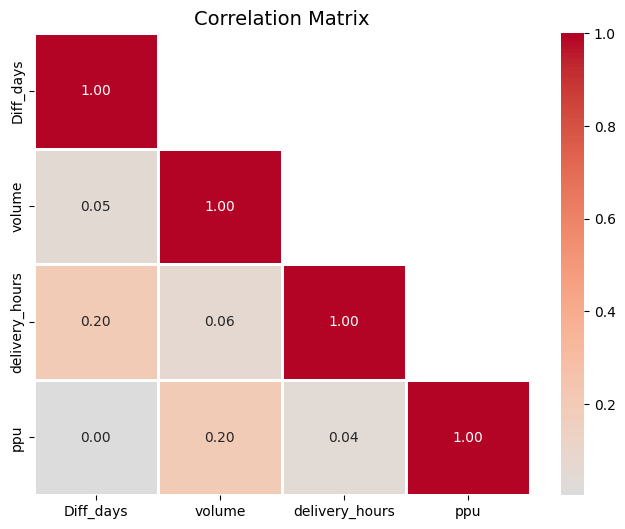

In [41]:
corr = merged_result.corr()

# Create a mask to only show the lower triangle of the matrix (since it's mirrored around its
# top-left to bottom-right diagonal)
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, k=1)] = True

# Plot the heatmap with the default colormap
plt.figure(figsize=(8, 6))
sns.heatmap(corr, mask=mask, cmap='coolwarm', annot=True, center=0, fmt='.2f', linewidths=2)
plt.title('Correlation Matrix', fontsize=14)
plt.show()

## 2. 수치형 변수 스케일링

In [42]:
# StandardScaler 초기화 및 스케일링
scaler = StandardScaler()
scaled_data = scaler.fit_transform(merged_result)

# 스케일링 결과를 DataFrame으로 변환
scaled_df = pd.DataFrame(scaled_data, columns=merged_result.columns, index=merged_result.index)


print('feature 들의 평균 값')
print(scaled_df.mean())
print('feature 들의 분산 값')
print(scaled_df.var())

feature 들의 평균 값
Diff_days        -9.869472e-18
volume            4.816302e-17
delivery_hours    5.566382e-17
ppu               1.500160e-17
dtype: float64
feature 들의 분산 값
Diff_days         1.000014
volume            1.000014
delivery_hours    1.000014
ppu               1.000014
dtype: float64


C:\Users\조성용\AppData\Local\Temp\ipykernel_15496\921255058.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(x0, kde=False, rug=False, fit =scipy.stats.norm, ax = ax[0]) #커널 밀도 함수, 러그밀도함수 는 안보이고(False) / 정규분포만 보이게(Fit)
C:\Users\조성용\AppData\Local\Temp\ipykernel_15496\921255058.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed29744

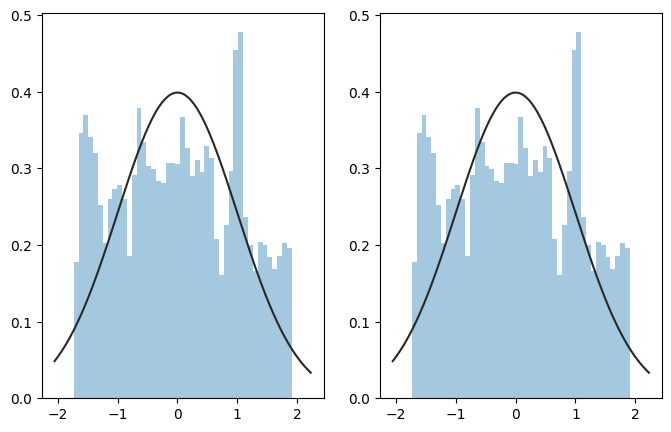

In [43]:
import scipy

# 각 값들의 정규 분포 모양 비교비교
f,ax = plt.subplots(1,2,figsize=(8,5))

# 표준화 전 정규분포
x0 = scaled_df['Diff_days'].dropna().values
sns.distplot(x0, kde=False, rug=False, fit =scipy.stats.norm, ax = ax[0]) #커널 밀도 함수, 러그밀도함수 는 안보이고(False) / 정규분포만 보이게(Fit)

# 표준화 이후 정규 분포
x1 = scaled_df['Diff_days'].values
sns.distplot(x1, kde=False, rug=False, fit =scipy.stats.norm, ax = ax[1])
plt.show()

In [44]:
# check Z score
df_Zscore = pd.DataFrame()
outlier_dict = {}
outlier_idx_list = []

for one_col in scaled_df.columns:
    print("Check",one_col)
    df_Zscore[f'{one_col}_Zscore'] = scipy.stats.zscore(scaled_df[one_col])
    outlier_dict[one_col] = df_Zscore[f'{one_col}_Zscore'][(df_Zscore[f'{one_col}_Zscore']>2)|(df_Zscore[f'{one_col}_Zscore']<-2)]
    outlier_idx_list.append(list(outlier_dict[one_col].index))
    if len(outlier_dict[one_col]):
        print(one_col,'Has outliers\n', outlier_dict[one_col])
    else:
        print(one_col,"Has Not outlier")
    print()


print("Before", scaled_df.shape)
all_outlier_idx = sum(outlier_idx_list,[])
df_droped = scaled_df.drop(all_outlier_idx)
print("After (drop outlier)", df_droped.shape)

Check Diff_days
Diff_days Has Not outlier

Check volume
volume Has outliers
 4        6.282021
17       2.606368
39       2.180387
65       2.204218
90       2.639136
           ...   
71933    4.696954
71963    2.819061
71966    4.070195
71978    2.819061
71990    2.425847
Name: volume_Zscore, Length: 3848, dtype: float64

Check delivery_hours
delivery_hours Has outliers
 45       2.004557
56       3.158950
58       4.002545
73       4.433222
76       2.399714
           ...   
71883    2.337555
71907    2.040076
71936    2.324235
71944    3.998105
71979    2.741592
Name: delivery_hours_Zscore, Length: 3164, dtype: float64

Check ppu
ppu Has outliers
 4        5.966450
12       4.942967
23       2.601311
41       2.493634
49       3.507303
           ...   
71851    3.187665
71862    7.271140
71935    5.954434
71946    2.278922
71991    2.061275
Name: ppu_Zscore, Length: 3122, dtype: float64

Before (71994, 4)
After (drop outlier) (62736, 4)


In [46]:
#reset_index안해서 아직 살아있음
df_droped

,Diff_days,volume,delivery_hours,ppu
0,1.767165,-0.545418,-0.526228,-0.395487
1,0.536938,0.087835,-0.490708,0.847477
2,-1.523444,-0.612621,-0.681627,-0.811979
3,0.887002,-0.594748,-0.437429,-0.739980
5,-0.113183,-0.412440,-0.273150,0.417961
...,...,...,...,...
71987,-0.223203,-0.621558,0.481646,-0.851968
71988,1.317082,-0.608808,0.912323,-0.622948
71989,-1.023351,-0.450570,0.406166,0.101717
71992,1.357089,-0.185091,-0.823706,-0.053011


In [47]:
from sklearn.preprocessing import MinMaxScaler

# MinMaxScaler 객체 생성
scaler = MinMaxScaler(feature_range=(0, 1))

# 먼저 fit()을 호출하여 scaler에 데이터를 학습시킴
scaler.fit(df_droped)

# 그 후 transform()을 사용하여 데이터를 변환
df_scaled = scaler.transform(df_droped)

# transform()으로 반환된 데이터는 numpy ndarry 형식이므로 DataFrame으로 변환
df_scaled = pd.DataFrame(data=df_scaled, columns=scaled_df.columns)

# 변환된 feature들의 최소, 최대 값 출력
print('feature들의 최소 값')
print(df_scaled.min())

print('\nfeature들의 최대 값')
print(df_scaled.max())

feature들의 최소 값
Diff_days         0.0
volume            0.0
delivery_hours    0.0
ppu               0.0
dtype: float64

feature들의 최대 값
Diff_days         1.0
volume            1.0
delivery_hours    1.0
ppu               1.0
dtype: float64


In [48]:
# 스케일링된 데이터와 원핫 인코딩된 데이터 병합
#final_result = pd.concat([scaled_df, merged_result[encoded_columns]], axis=1)
#final_result = pd.concat([scaled_df, merged_result[encoded_columns]], axis=1)

final_result = df_scaled
final_result.T # 최종 결과 출력 (전치하여 확인)

#클러스터 번호 나왔을 건데. 이 데이터 프레임의 맨 마지막 컬럼에 클러스터 번호를 붙여주세요

,0,1,2,3,4,5,6,7,8,9,...,62726,62727,62728,62729,62730,62731,62732,62733,62734,62735
Diff_days,0.961538,0.623626,0.057692,0.719780,0.445055,0.159341,0.431319,0.087912,0.096154,0.538462,...,0.956044,0.153846,0.453297,0.763736,0.695055,0.414835,0.837912,0.195055,0.848901,0.219780
volume,0.072914,0.303568,0.048435,0.054946,0.121349,0.036001,0.376112,0.057463,0.430363,0.426023,...,0.038887,0.014062,0.169958,0.211189,0.289310,0.045180,0.049824,0.107461,0.204158,0.033462
delivery_hours,0.221918,0.232877,0.173973,0.249315,0.300000,0.042466,0.105479,0.328767,0.180822,0.387671,...,0.179452,0.060274,0.658904,0.127397,0.664384,0.532877,0.665753,0.509589,0.130137,0.136986
ppu,0.312011,0.669047,0.192376,0.213057,0.545670,0.304055,0.326501,0.276207,0.325368,0.288089,...,0.671786,0.217430,0.539242,0.397529,0.681561,0.180889,0.246674,0.454830,0.410385,0.271439


## 3. PCA 진행

In [49]:
from sklearn.decomposition import PCA

# 주성분 개수를 판단하기 위한 pca임의 시행

# pca = PCA(n_components=2)
pca = PCA(n_components=2)
pca.fit(final_result)

# 설정한 주성분의 갯수로 전체 데이터 분산을 얼만큼 설명 가능한지
pca.explained_variance_ratio_.sum()

np.float64(0.6734699697303899)

In [50]:
# pca 시행
pca_df = pca.fit_transform(final_result)
pca_df = pd.DataFrame(data = pca_df, columns = ['PC1','PC2'])
#pca_df = pd.DataFrame(data = pca_df, columns = ['PC1','PC2','PC3','PC4','PC5','PC6'])
#pca_df = pd.DataFrame(data = pca_df, columns = ['PC1','PC2','PC3'])

# Show the first 5 firms
pca_df.head()

,PC1,PC2
0,0.407220,-0.226623
1,0.125270,0.142751
2,-0.459588,-0.154997
3,0.186398,-0.232254
4,-0.039495,-0.028683


## scree plot으로 초기 K값 참고

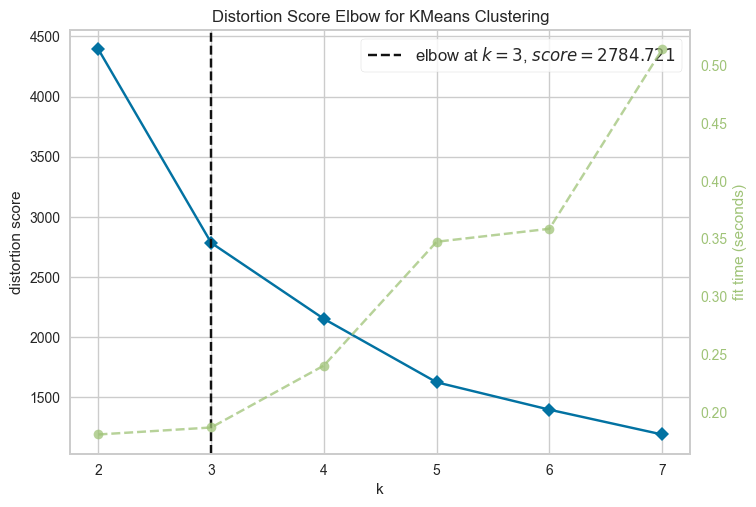

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [51]:
# k-means 알고리즘 활용을 위한 라이브러리 import
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

# 초기 k 값 참고를 위한 scree plot 을 그리고, 군집이 나뉘는 시간까지 고려한 k 값 확인
model = KMeans(n_init= 20, random_state=42)

# k 값의 범위를 조정해 줄 수 있습니다.
visualizer = KElbowVisualizer(model, k=(2,8))

# 데이터 적용
visualizer.fit(pca_df)
visualizer.show()

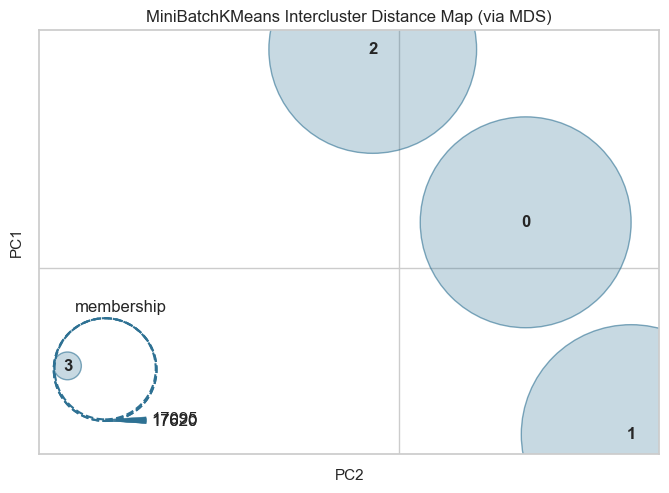

InterclusterDistance(ax=<Axes: title={'center': 'MiniBatchKMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=MiniBatchKMeans(n_clusters=4, random_state=42))

In [52]:
# 초기 k 값 참고를 위한 distance map 라이브러리 import
from yellowbrick.cluster import intercluster_distance
from sklearn.cluster import MiniBatchKMeans

#그룹의 갯수를 지정해 줄 수 있습니다. 저는 7로 적어두었습니다.
intercluster_distance(MiniBatchKMeans(4, random_state=42), pca_df)

In [53]:
#  KMEANS
# 군집개수(n_cluster)는 7,초기 중심 설정방식 랜덤,
kmeans = KMeans(n_clusters=4, random_state=42, init='random')

# pca df 를 이용한 kmeans 알고리즘 적용
kmeans.fit(pca_df)

# 클러스터 번호 가져오기
labels = kmeans.labels_

# 이제 pca_df의 마지막 컬럼(Cluster)에는 각 데이터 포인트가 속한 클러스터 번호가 포함되어 있습니다.
kmeans_df = pd.concat([pca_df, pd.DataFrame({'Cluster':labels})],axis = 1)

# PCA 데이터프레임에 클러스터 번호 추가
pca_df['Cluster'] = labels

In [54]:
pca_df

,PC1,PC2,Cluster
0,0.407220,-0.226623,1
1,0.125270,0.142751,3
2,-0.459588,-0.154997,0
3,0.186398,-0.232254,1
4,-0.039495,-0.028683,0
...,...,...,...
62731,-0.004367,-0.170677,1
62732,0.438379,-0.194386,1
62733,-0.205663,-0.004768,0
62734,0.285698,-0.069886,1


In [55]:
pca_df

,PC1,PC2,Cluster
0,0.407220,-0.226623,1
1,0.125270,0.142751,3
2,-0.459588,-0.154997,0
3,0.186398,-0.232254,1
4,-0.039495,-0.028683,0
...,...,...,...
62731,-0.004367,-0.170677,1
62732,0.438379,-0.194386,1
62733,-0.205663,-0.004768,0
62734,0.285698,-0.069886,1


In [58]:
# 군집별 비중 확인
clusters = pca_df['Cluster'].value_counts().to_dict()

for i,j in clusters.items():
    print("{} : {}%".format(i,round(j/len(pca_df)*100,2)))

1 : 39.93%
0 : 37.66%
3 : 11.39%
2 : 11.01%


In [59]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import itertools

def perform_kmeans_clustering(data, feature_names, random_state=42):
    # k_range를 고정
    k_range = [4, 5, 6]
    
    # 결과 저장용 딕셔너리
    results = {}
    
    # feature_names의 모든 조합 (최소 3개 이상의 feature)
    feature_combinations = []
    for r in range(3, len(feature_names) + 1):  # 최소 3개의 feature부터 모든 조합
        feature_combinations.extend(itertools.combinations(feature_names, r))
    
    # 각 feature 조합에 대해 반복 수행
    for features in feature_combinations:
        print(f"Features: {features}에 대해 클러스터링 진행 중...")
        
        # 스케일링
        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(data[list(features)])
        
        # PCA 적용 전, feature 개수가 2개 이상일 때만 PCA 수행
        if len(features) > 1:
            # PCA 변환
            pca = PCA(n_components=2)
            pca_data = pca.fit_transform(scaled_data)
            pca_df = pd.DataFrame(pca_data, columns=['PC1', 'PC2'])
            pca_applied = True
        else:
            pca_df = pd.DataFrame(scaled_data, columns=features)
            pca_applied = False
        
        for k in k_range:
            print(f"K={k}에 대한 클러스터링 진행 중...")
            # KMeans 클러스터링
            kmeans = KMeans(n_clusters=k, random_state=random_state, init='random')
            labels = kmeans.fit_predict(pca_df)
            
            # 결과 저장
            if features not in results:
                results[features] = {}
            results[features][k] = {
                'kmeans_model': kmeans,
                'labels': labels,
                'cluster_centers': kmeans.cluster_centers_
            }
            
            # 클러스터링 결과 시각화
            plt.figure(figsize=(8, 6))
            if pca_applied:
                sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue=labels, palette='tab10')
            else:
                sns.scatterplot(data=pca_df, x=features[0], y=features[0], hue=labels, palette='tab10')
            plt.title(f'Clusters with K={k} for Features {features}')
            plt.legend(title='Cluster')
            plt.show()
            
            # 클러스터 별 평균 계산
            clustered_data = pd.DataFrame(scaled_data, columns=features)
            clustered_data['Cluster'] = labels
            cluster_means = clustered_data.groupby('Cluster').mean()
            
            # 평균 값 시각화
            plt.figure(figsize=(10, 6))
            sns.lineplot(data=cluster_means.T)
            plt.title(f'Cluster Means for K={k} for Features {features}')
            plt.xticks(rotation=90)
            plt.show()
            
            # 군집별 비중 계산 및 시각화
            cluster_counts = clustered_data['Cluster'].value_counts()
            cluster_percentages = (cluster_counts / len(clustered_data) * 100).sort_index()

            print(f"Cluster Percentages for K={k} for Features {features}:")
            print(cluster_percentages)

            plt.figure(figsize=(8, 6))
            cluster_percentages.plot(kind='bar', color='skyblue')
            plt.title(f'Cluster Proportions for K={k} for Features {features}')
            plt.xlabel('Cluster')
            plt.ylabel('Percentage (%)')
            plt.xticks(rotation=0)
            plt.show()
    
    return results


Features: ('delivery_hours', 'volume', 'Diff_days')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


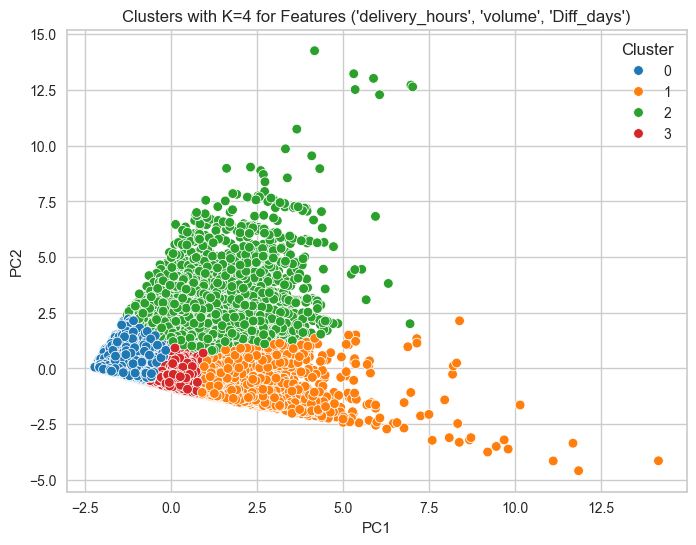

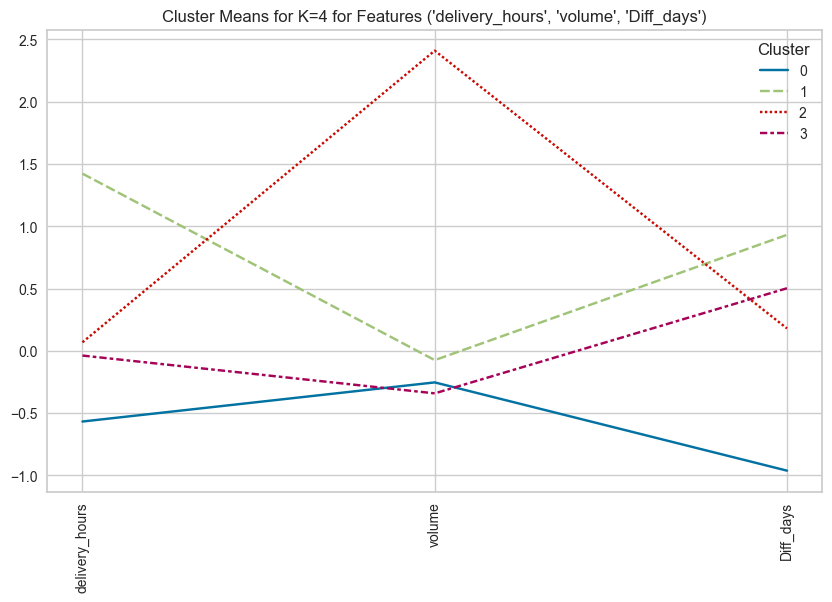

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'Diff_days'):
Cluster
0    36.590240
1    15.161272
2     9.774885
3    38.473602
Name: count, dtype: float64


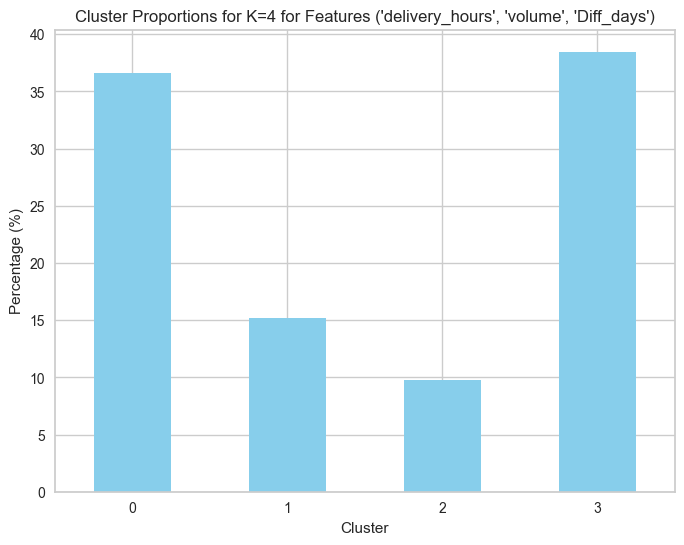

K=5에 대한 클러스터링 진행 중...


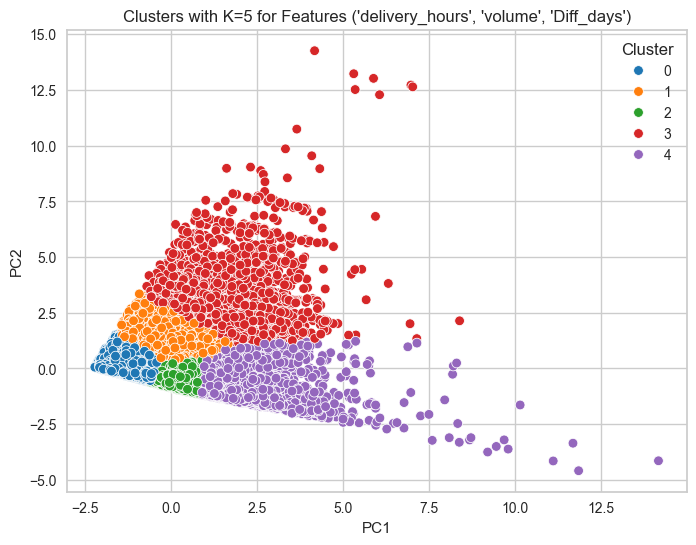

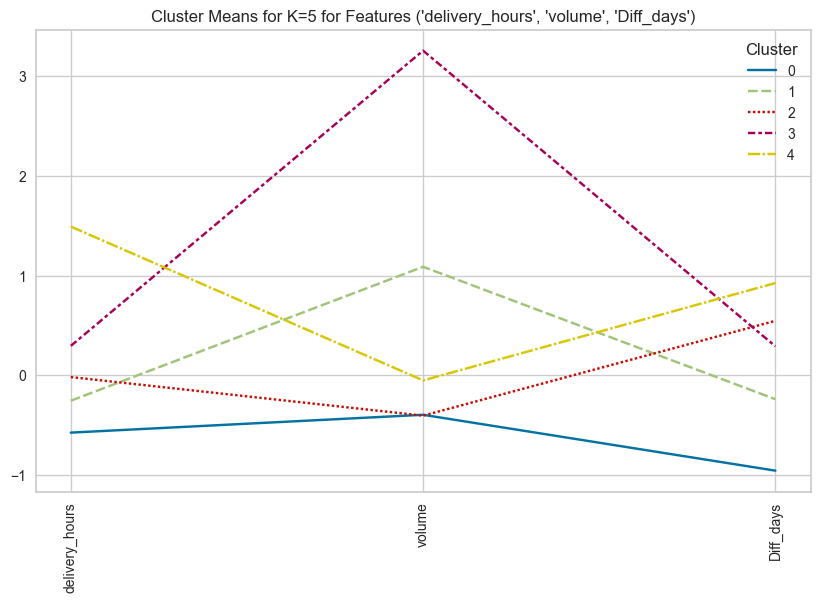

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'Diff_days'):
Cluster
0    33.008105
1    11.562483
2    36.312663
3     4.910343
4    14.206406
Name: count, dtype: float64


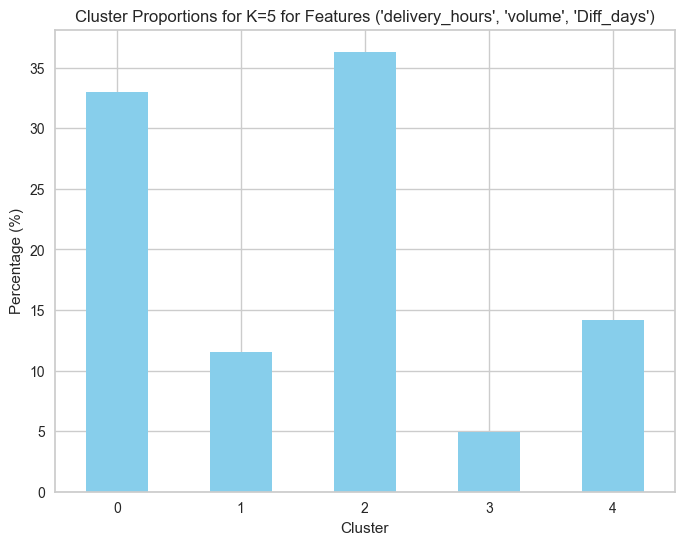

K=6에 대한 클러스터링 진행 중...


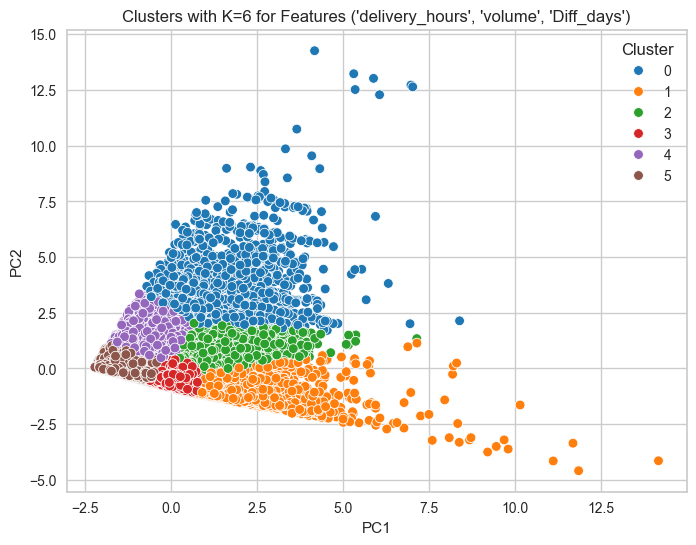

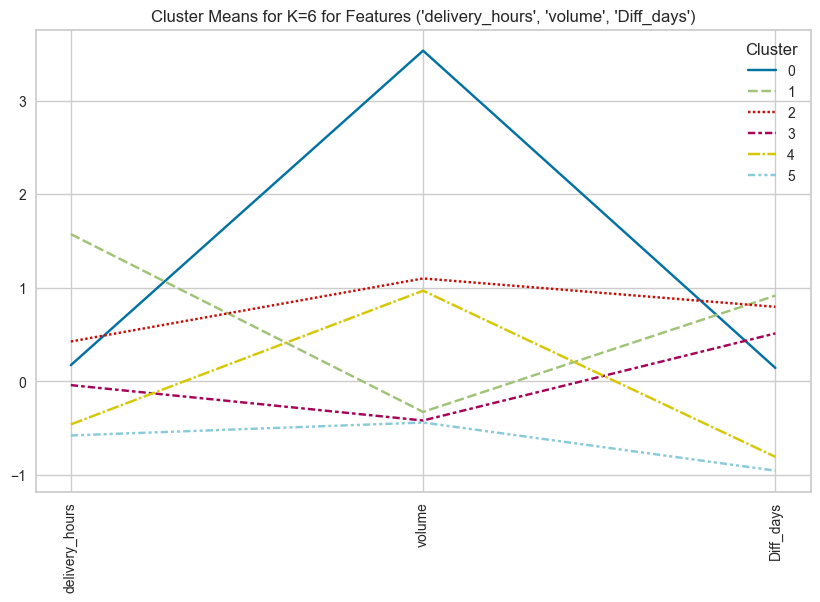

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'Diff_days'):
Cluster
0     3.908288
1    11.980236
2     8.974074
3    35.175984
4     8.801976
5    31.159440
Name: count, dtype: float64


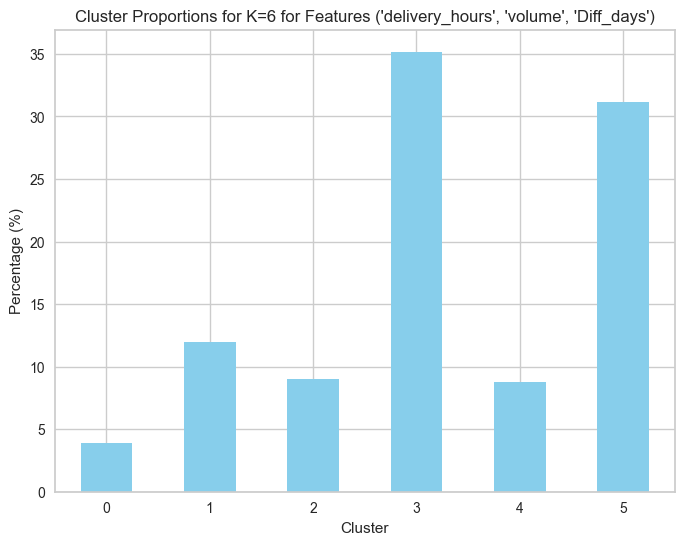

Features: ('delivery_hours', 'volume', 'ppu')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


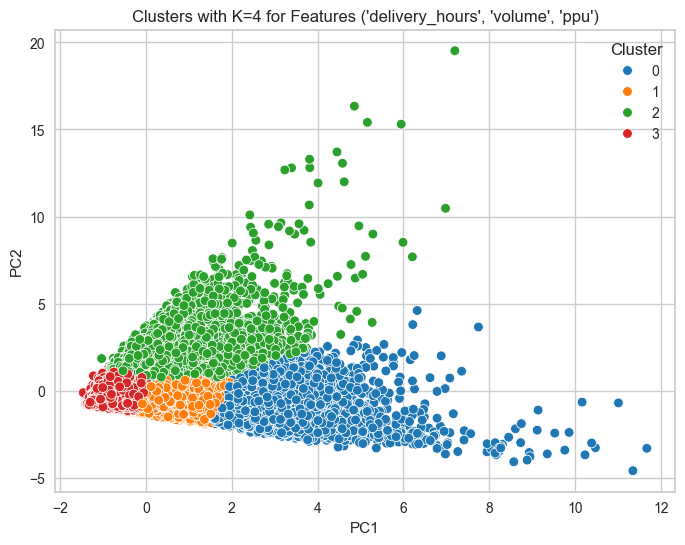

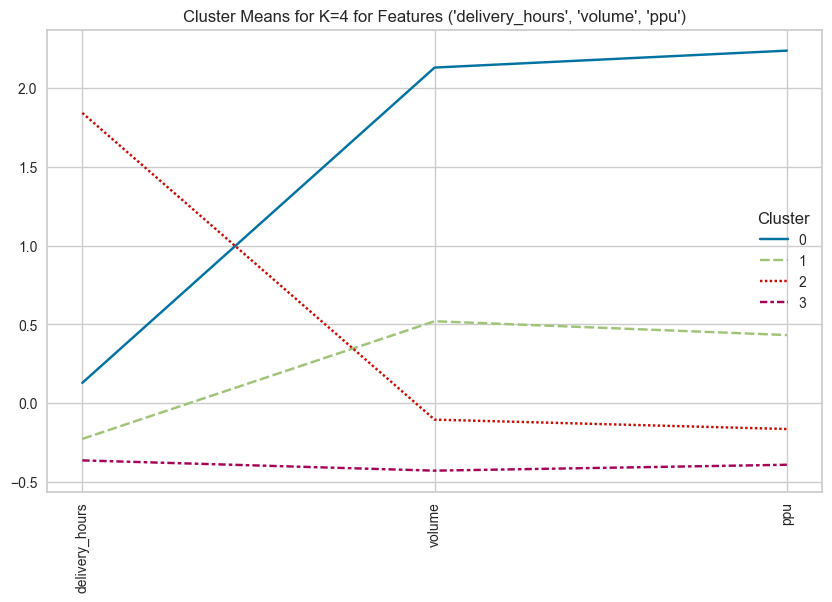

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'ppu'):
Cluster
0     6.535558
1    22.997280
2    13.637373
3    56.829790
Name: count, dtype: float64


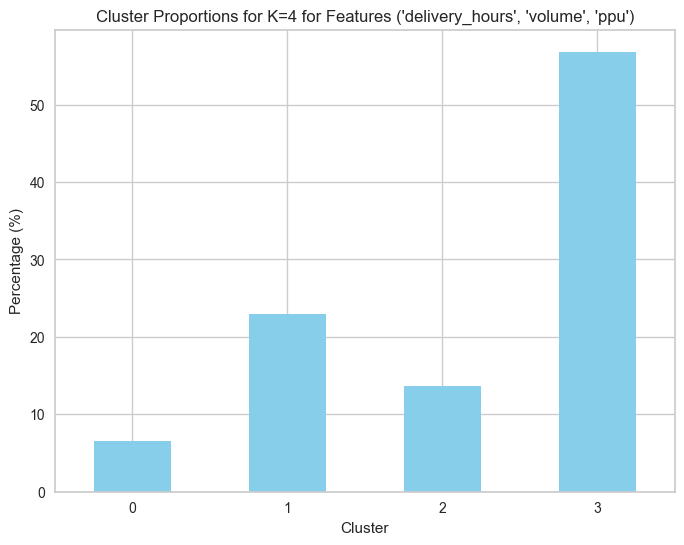

K=5에 대한 클러스터링 진행 중...


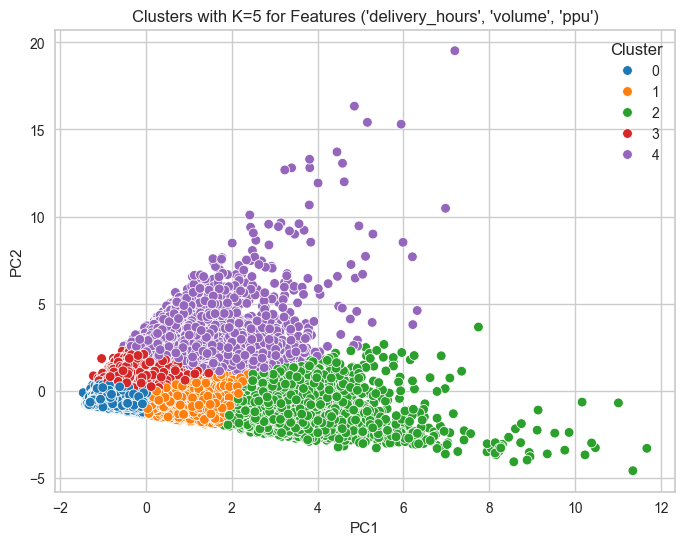

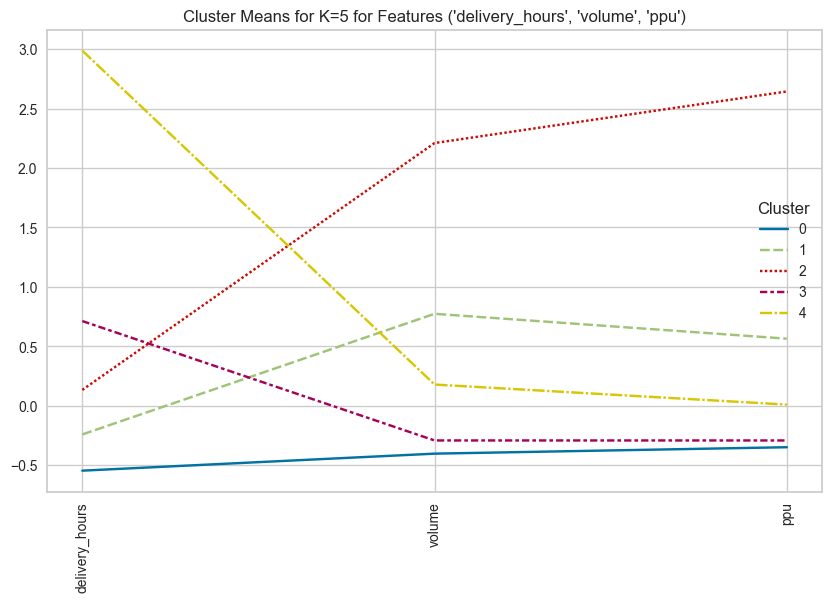

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'ppu'):
Cluster
0    48.946594
1    18.841947
2     4.888136
3    22.429634
4     4.893688
Name: count, dtype: float64


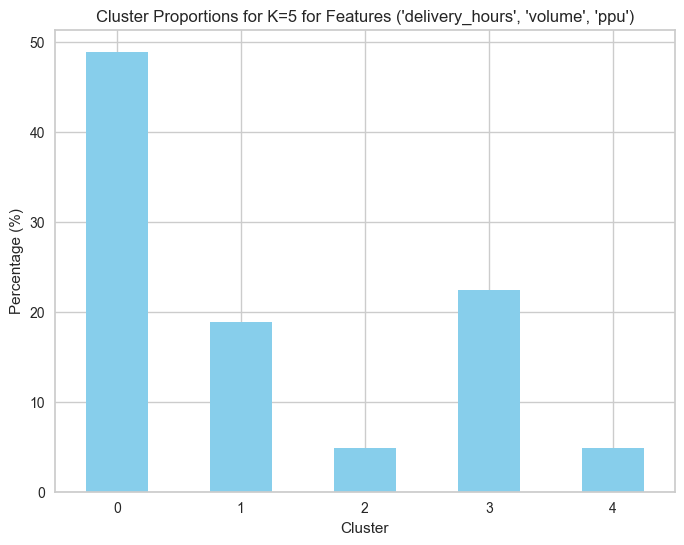

K=6에 대한 클러스터링 진행 중...


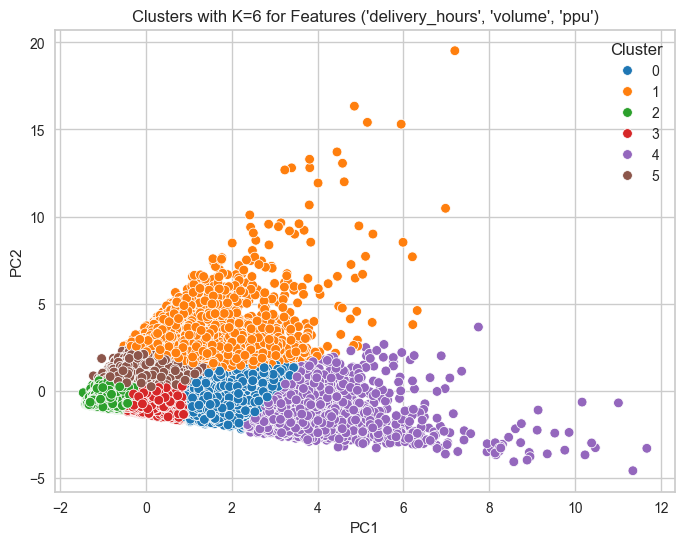

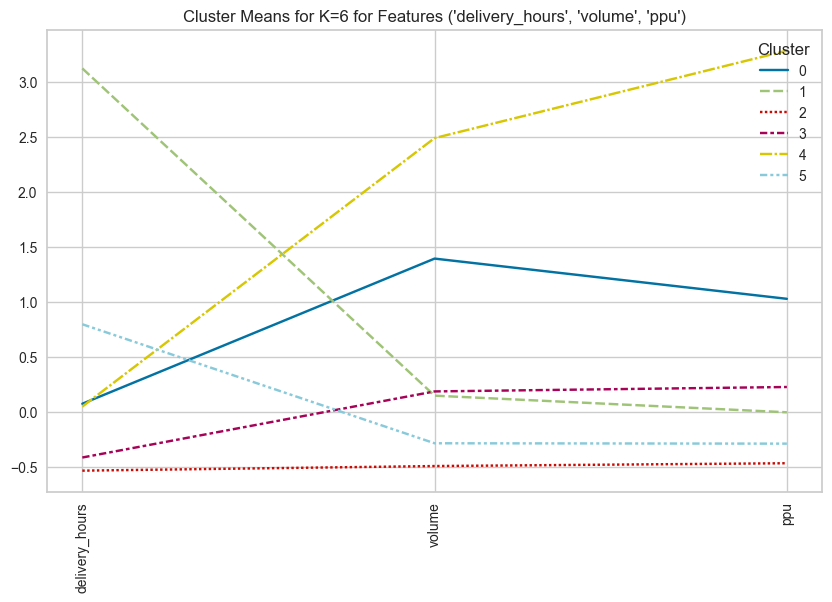

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'ppu'):
Cluster
0     9.566702
1     4.371843
2    39.409038
3    23.223505
4     2.875701
5    20.553212
Name: count, dtype: float64


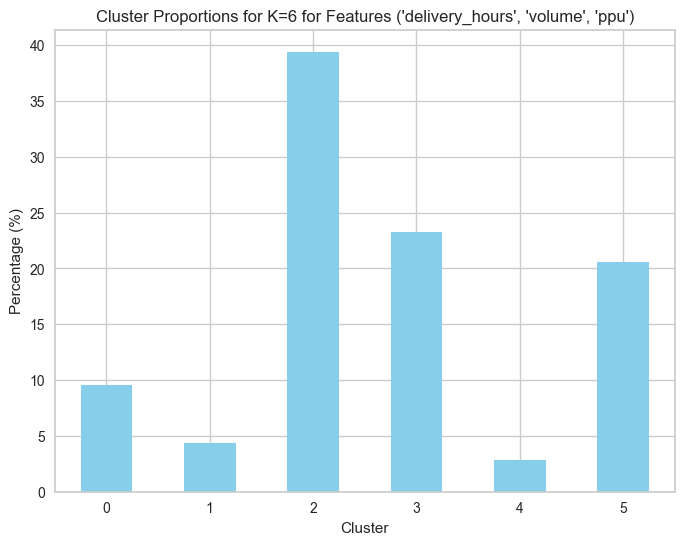

Features: ('delivery_hours', 'volume', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


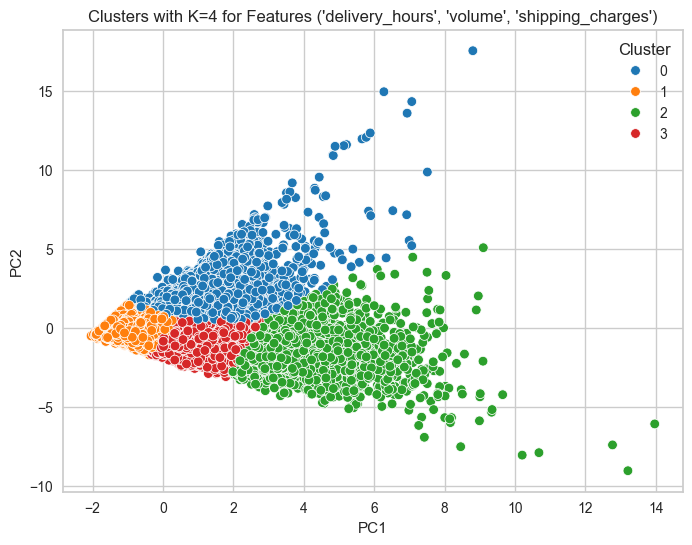

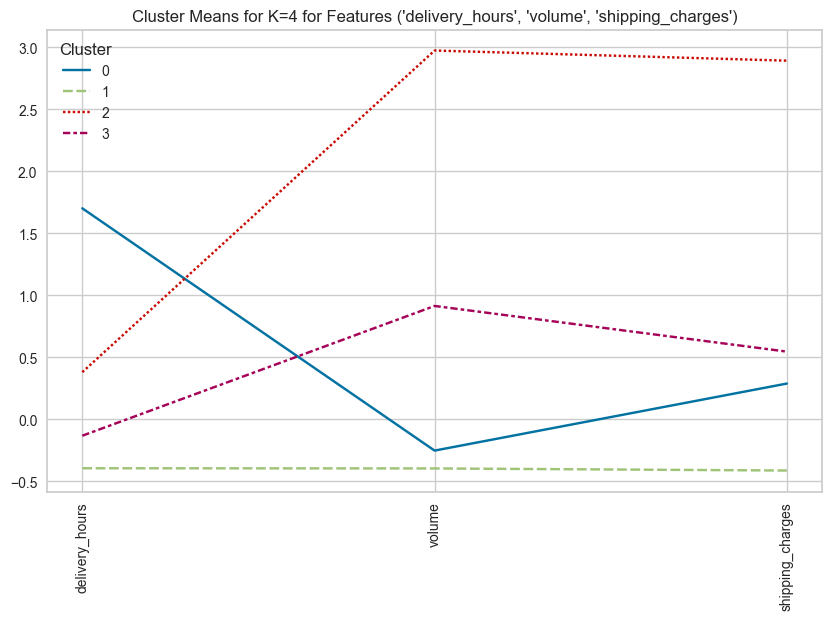

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'shipping_charges'):
Cluster
0    15.073836
1    62.563149
2     3.973519
3    18.389496
Name: count, dtype: float64


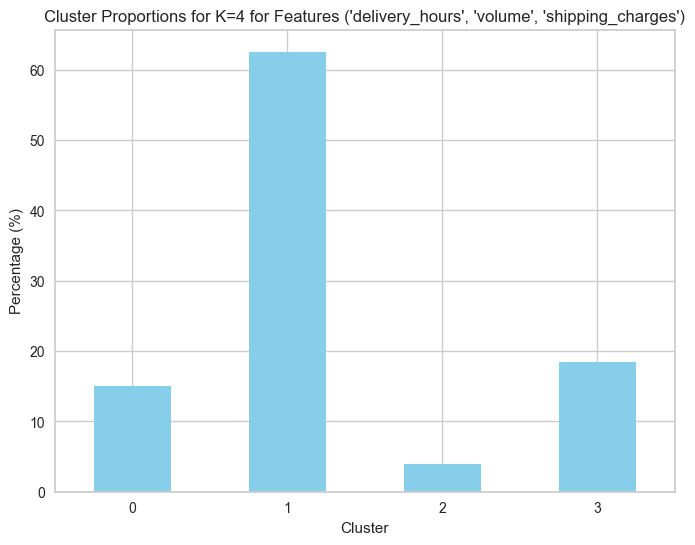

K=5에 대한 클러스터링 진행 중...


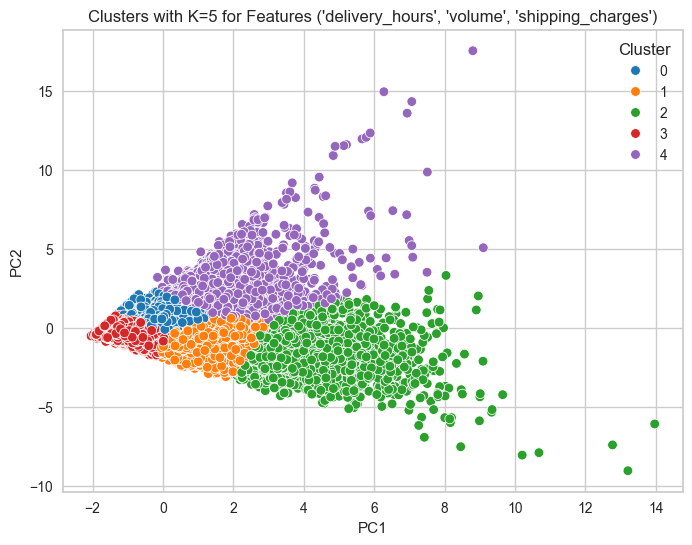

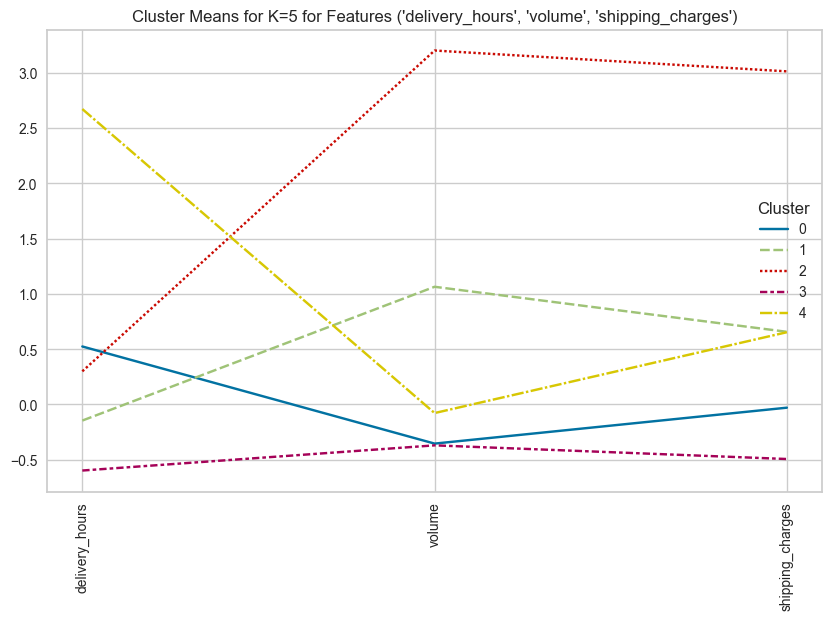

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'shipping_charges'):
Cluster
0    26.559984
1    15.880198
2     3.378116
3    48.129129
4     6.052573
Name: count, dtype: float64


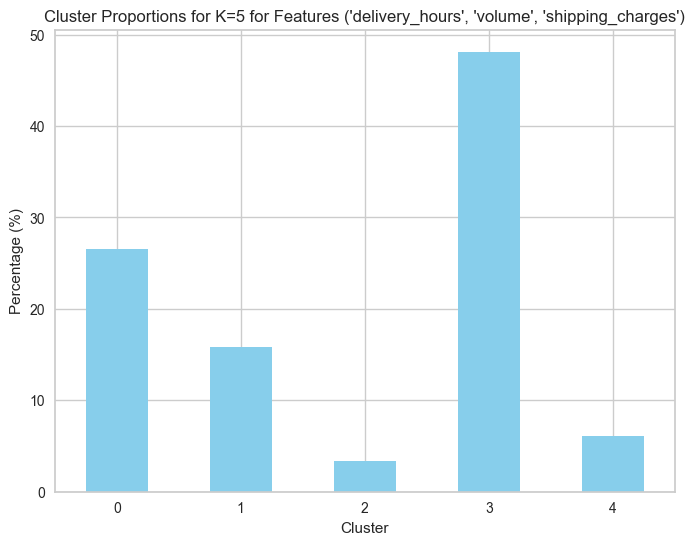

K=6에 대한 클러스터링 진행 중...


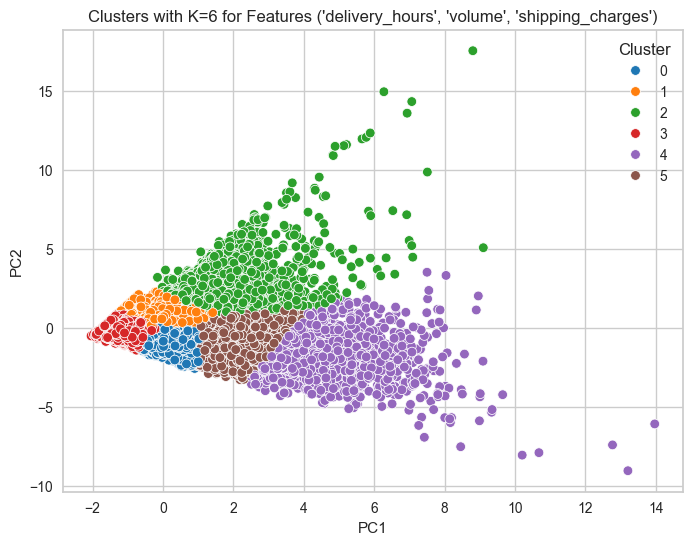

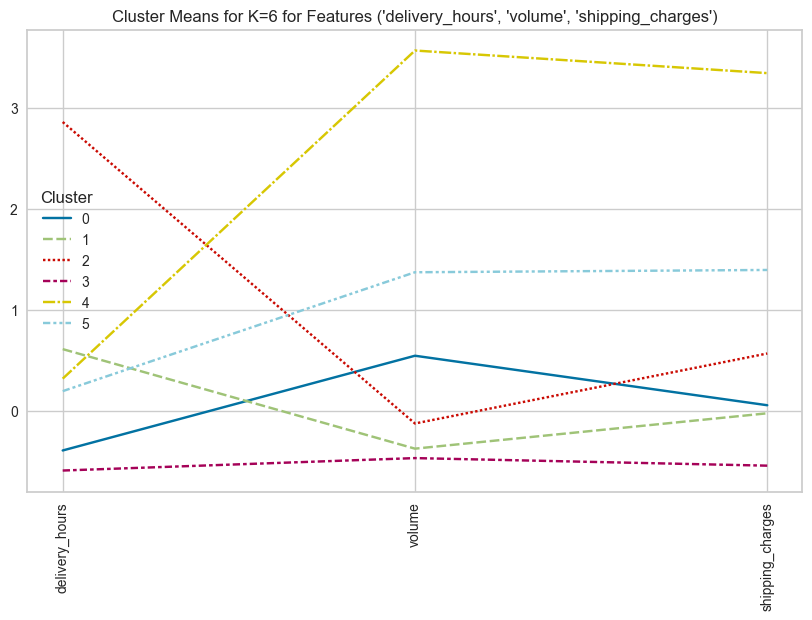

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'shipping_charges'):
Cluster
0    17.440182
1    24.261644
2     5.174041
3    42.329151
4     2.451008
5     8.343974
Name: count, dtype: float64


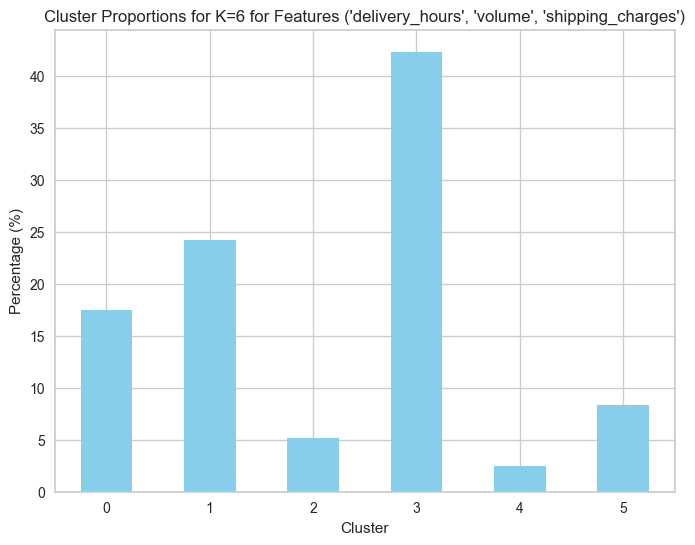

Features: ('delivery_hours', 'Diff_days', 'ppu')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


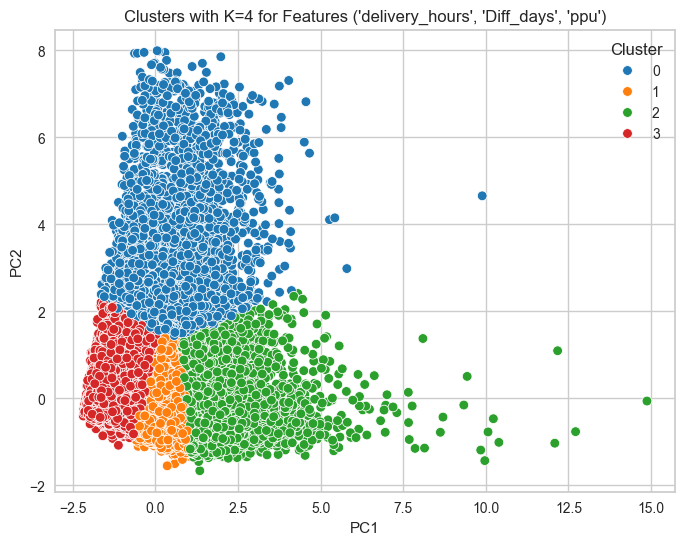

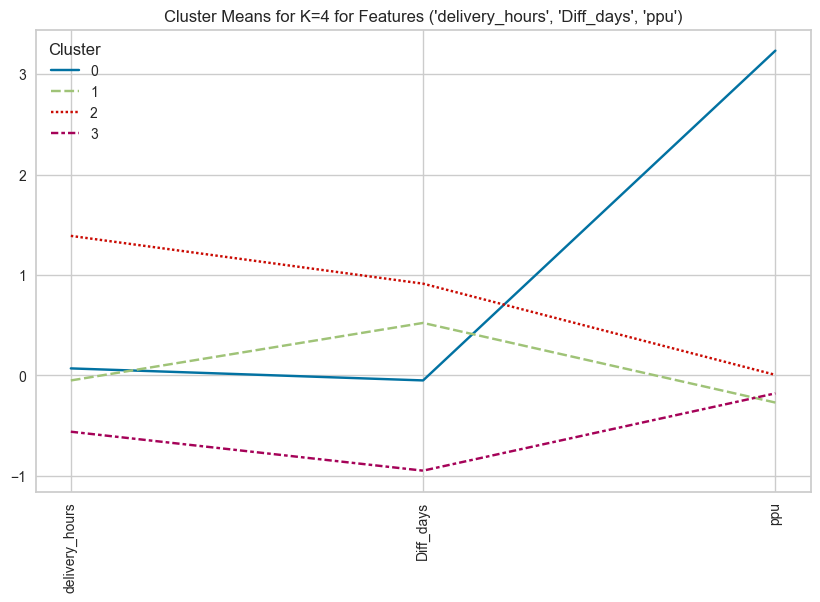

Cluster Percentages for K=4 for Features ('delivery_hours', 'Diff_days', 'ppu'):
Cluster
0     5.433576
1    40.361128
2    16.429801
3    37.775495
Name: count, dtype: float64


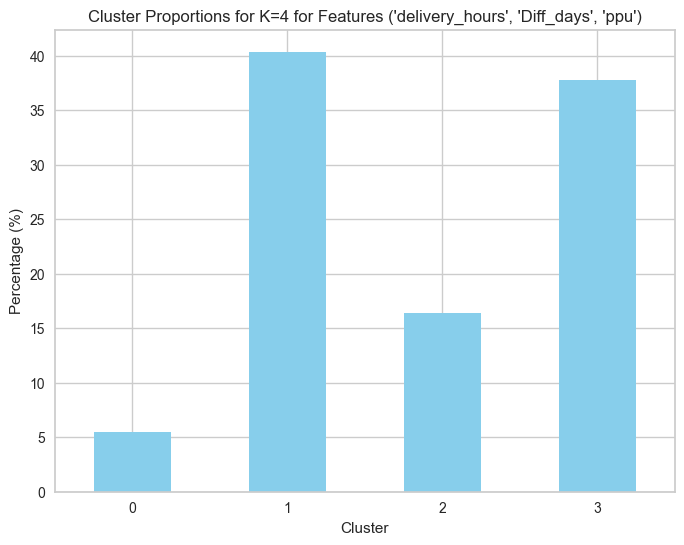

K=5에 대한 클러스터링 진행 중...


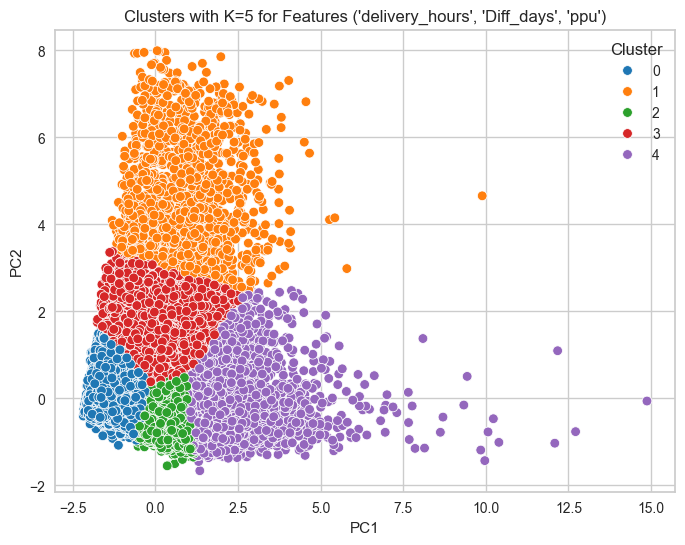

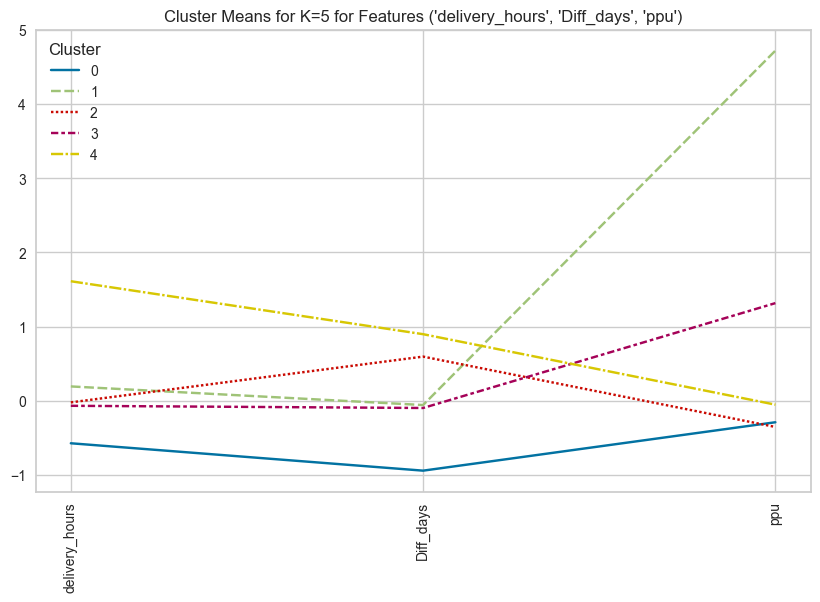

Cluster Percentages for K=5 for Features ('delivery_hours', 'Diff_days', 'ppu'):
Cluster
0    35.789430
1     2.280298
2    38.240437
3    10.374452
4    13.315383
Name: count, dtype: float64


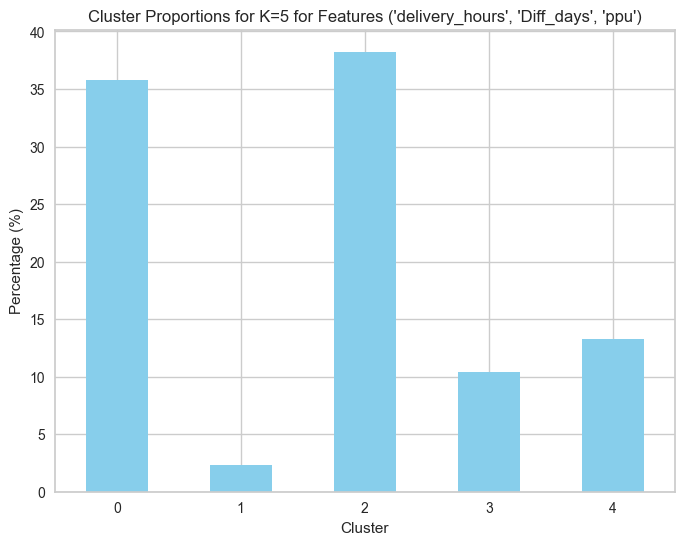

K=6에 대한 클러스터링 진행 중...


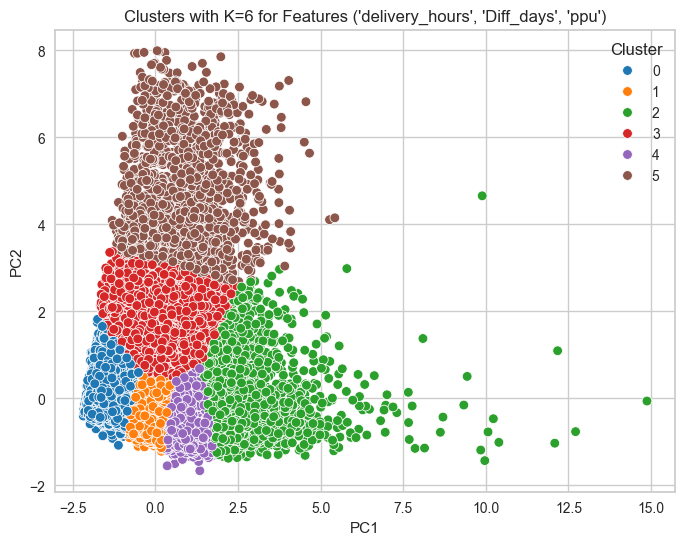

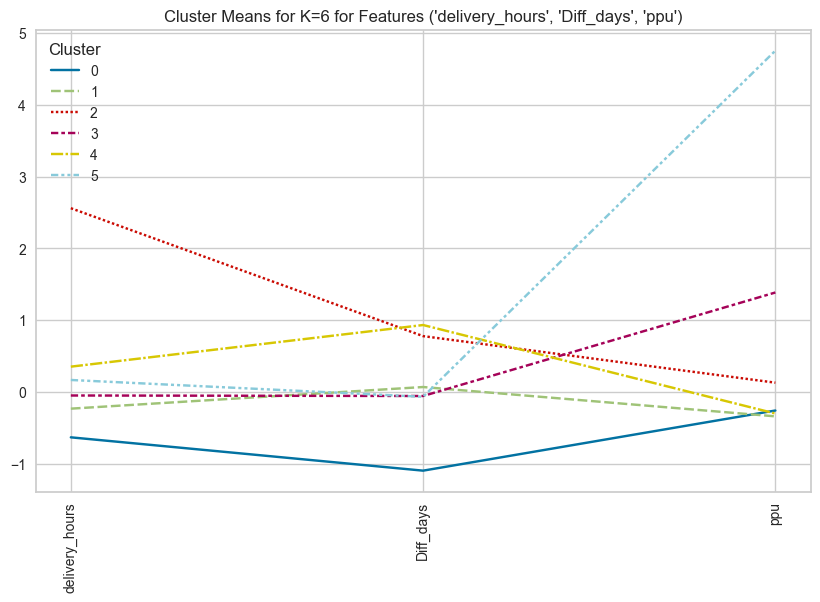

Cluster Percentages for K=6 for Features ('delivery_hours', 'Diff_days', 'ppu'):
Cluster
0    28.351746
1    26.754289
2     5.709765
3     9.602787
4    27.351080
5     2.230334
Name: count, dtype: float64


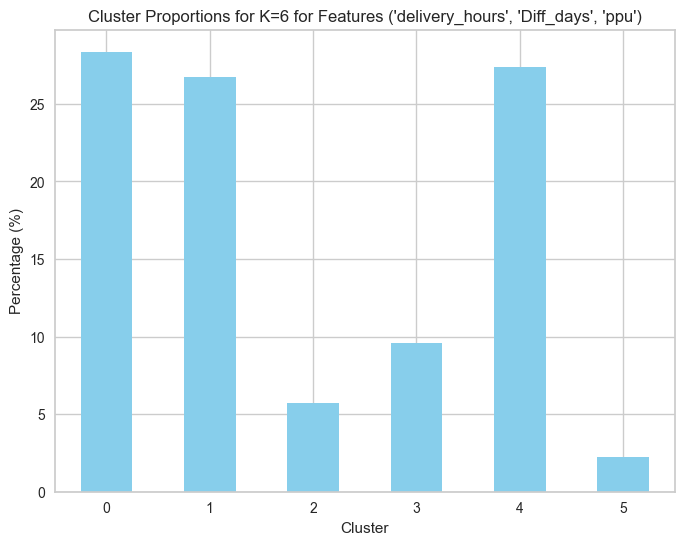

Features: ('delivery_hours', 'Diff_days', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


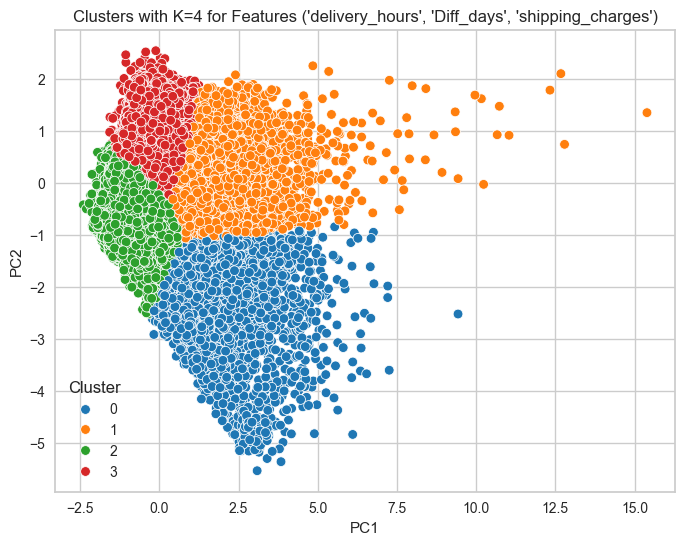

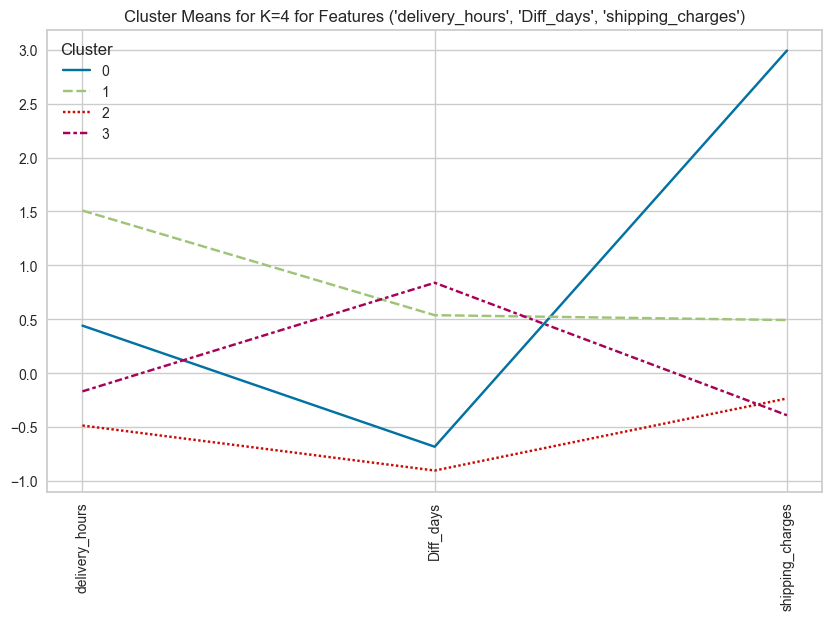

Cluster Percentages for K=4 for Features ('delivery_hours', 'Diff_days', 'shipping_charges'):
Cluster
0     5.573752
1    15.699772
2    40.570699
3    38.155776
Name: count, dtype: float64


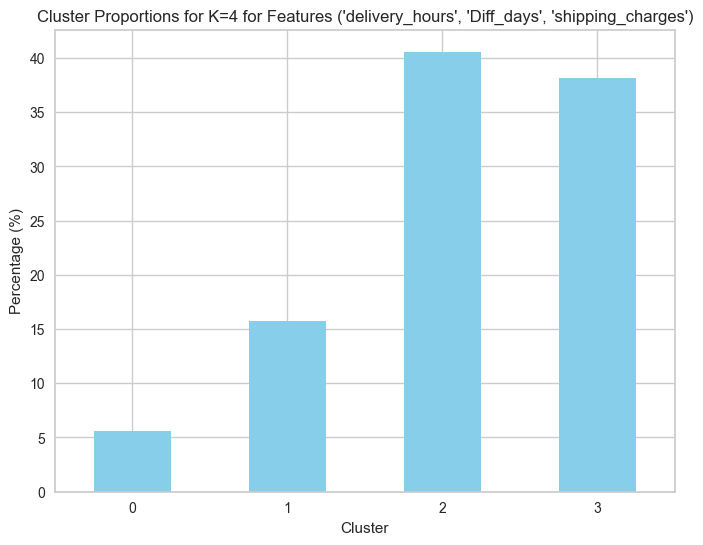

K=5에 대한 클러스터링 진행 중...


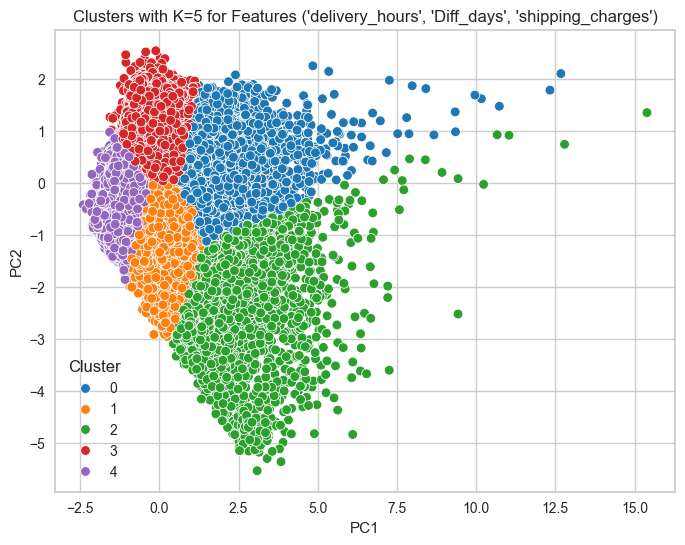

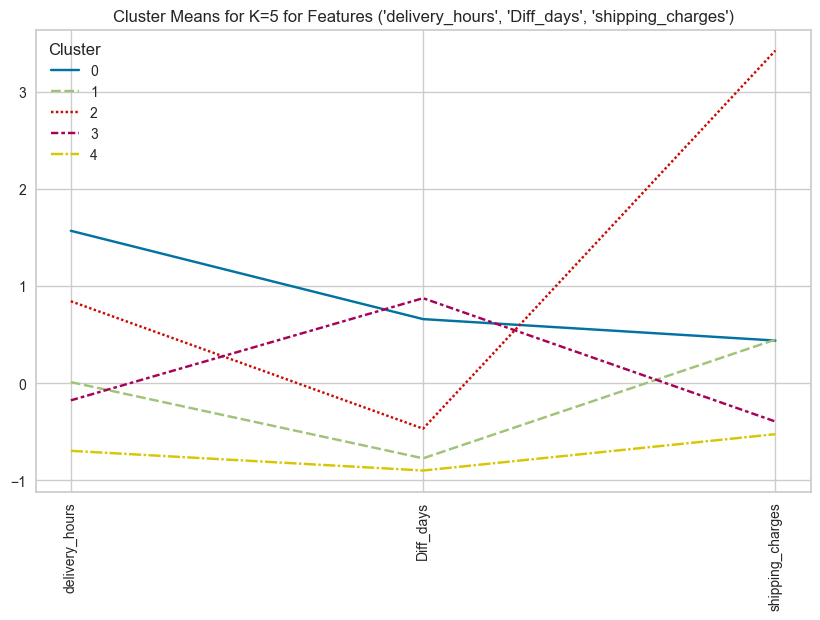

Cluster Percentages for K=5 for Features ('delivery_hours', 'Diff_days', 'shipping_charges'):
Cluster
0    13.803919
1    18.540776
2     4.144229
3    36.201632
4    27.309443
Name: count, dtype: float64


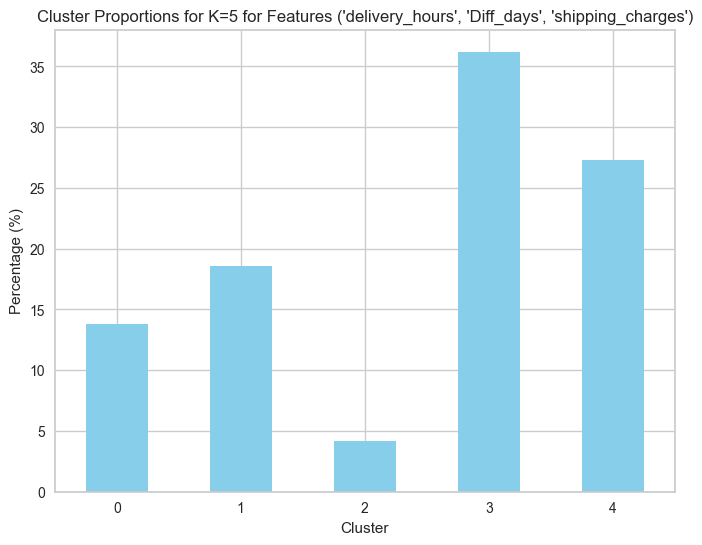

K=6에 대한 클러스터링 진행 중...


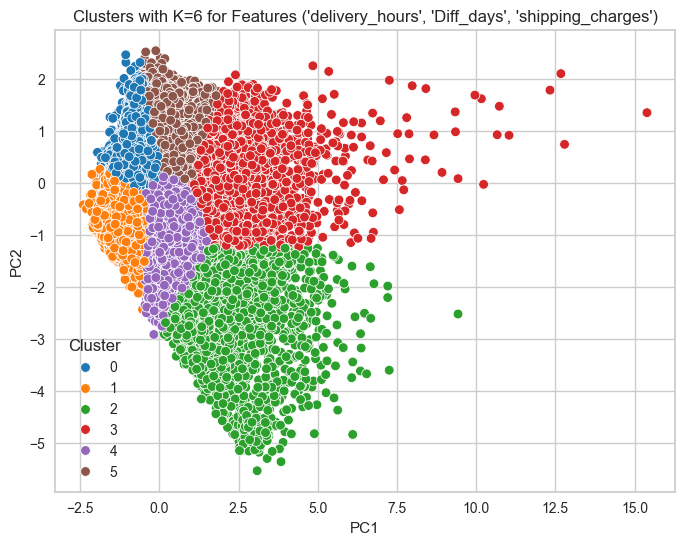

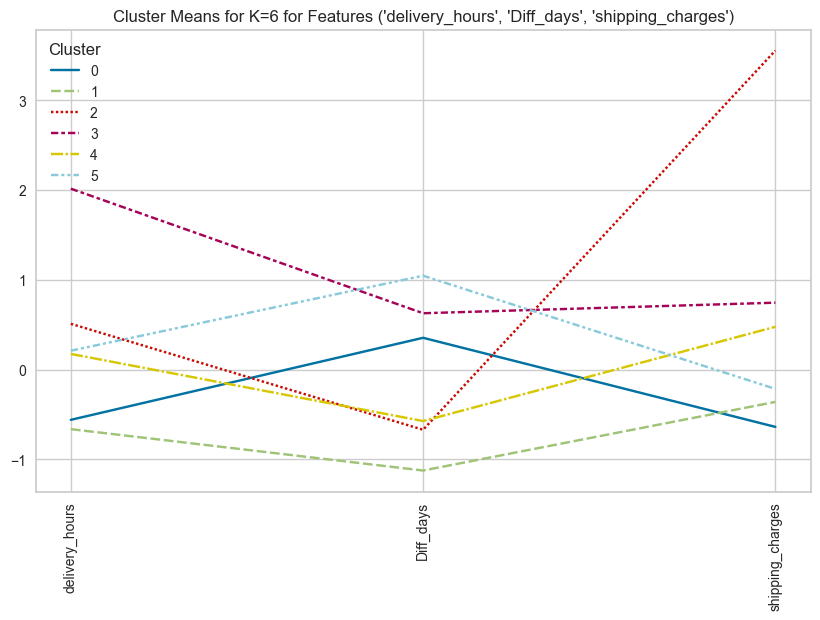

Cluster Percentages for K=6 for Features ('delivery_hours', 'Diff_days', 'shipping_charges'):
Cluster
0    20.848831
1    24.730750
2     3.718148
3     8.878310
4    16.347915
5    25.476045
Name: count, dtype: float64


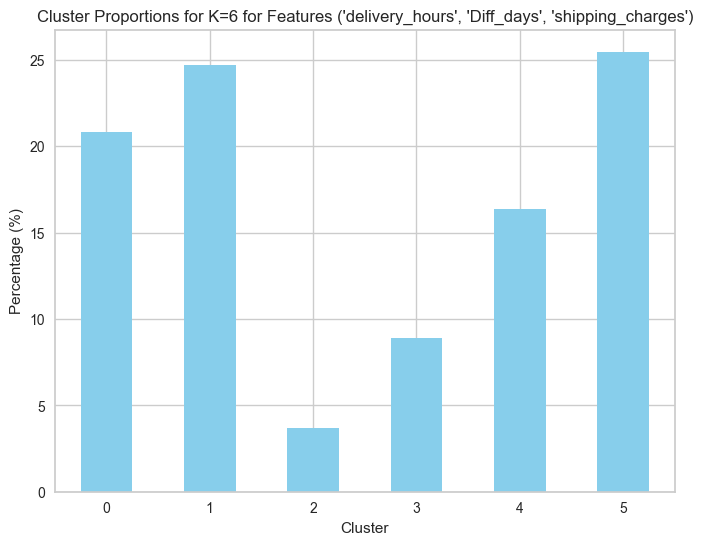

Features: ('delivery_hours', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


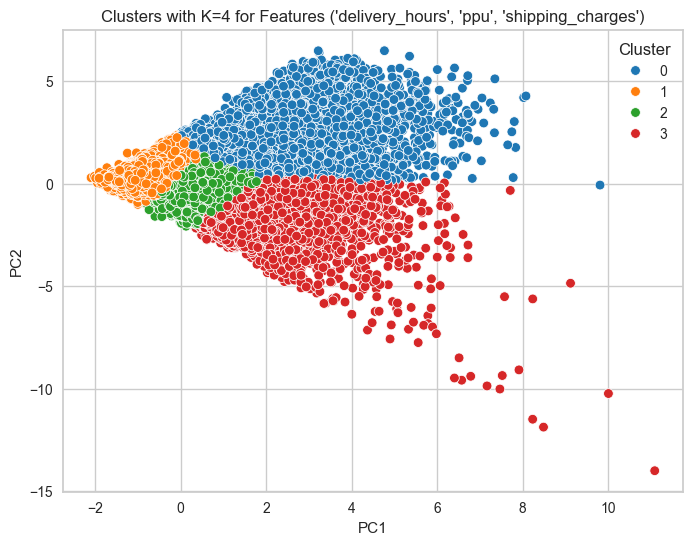

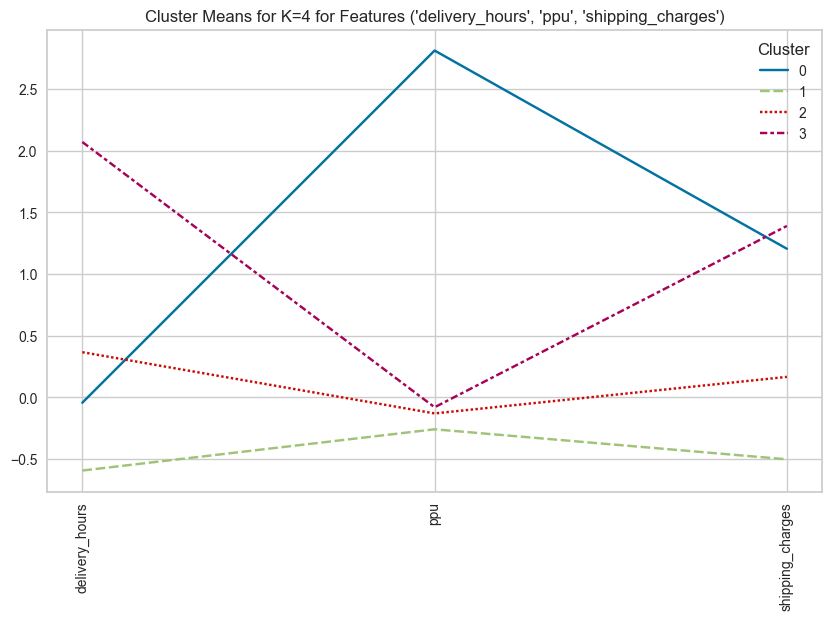

Cluster Percentages for K=4 for Features ('delivery_hours', 'ppu', 'shipping_charges'):
Cluster
0     6.503636
1    50.353911
2    34.687448
3     8.455005
Name: count, dtype: float64


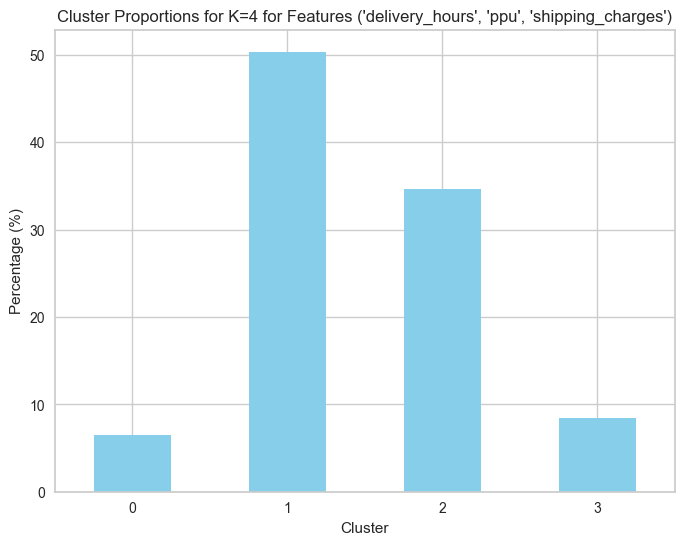

K=5에 대한 클러스터링 진행 중...


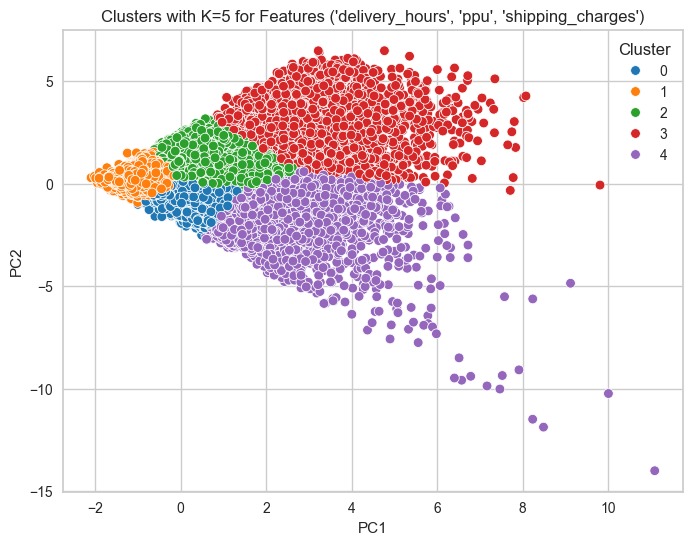

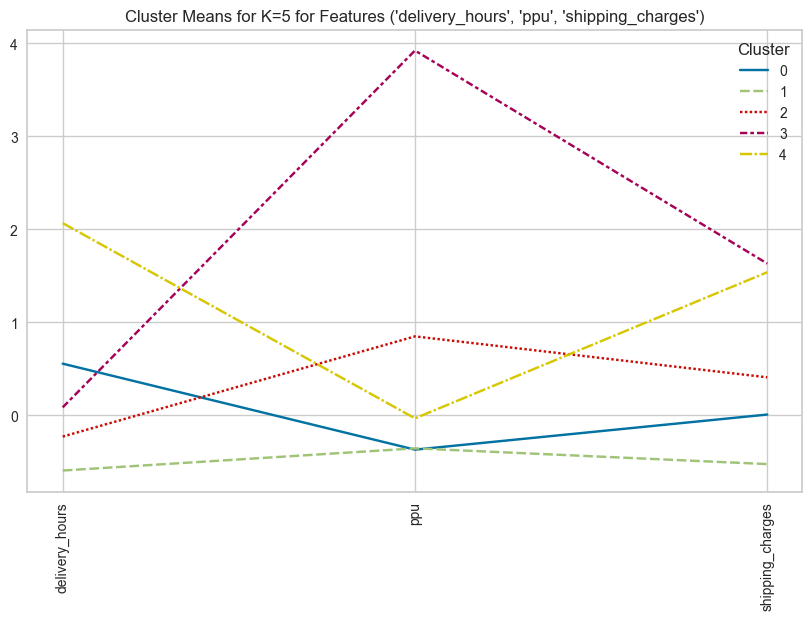

Cluster Percentages for K=5 for Features ('delivery_hours', 'ppu', 'shipping_charges'):
Cluster
0    26.301838
1    46.252706
2    16.431189
3     3.151890
4     7.862377
Name: count, dtype: float64


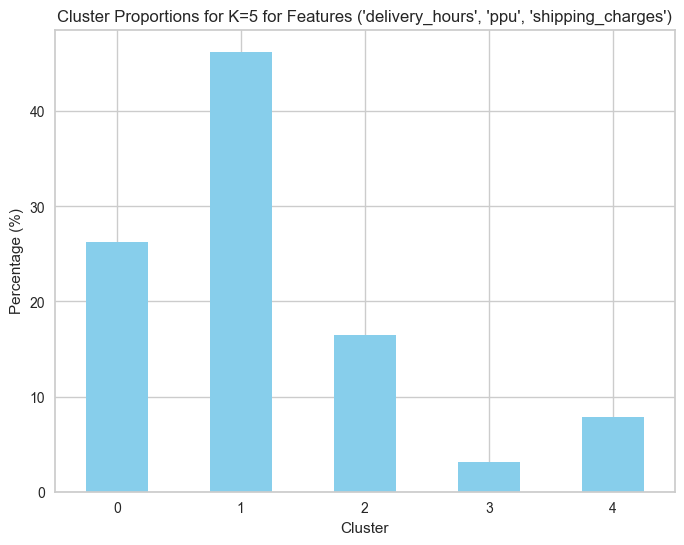

K=6에 대한 클러스터링 진행 중...


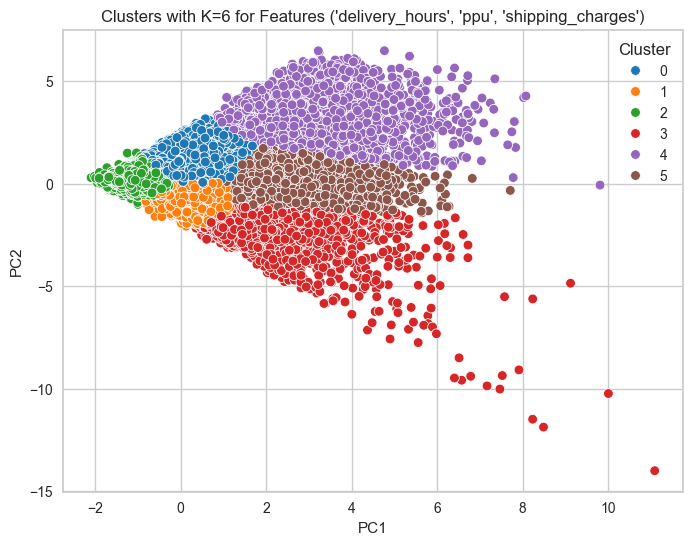

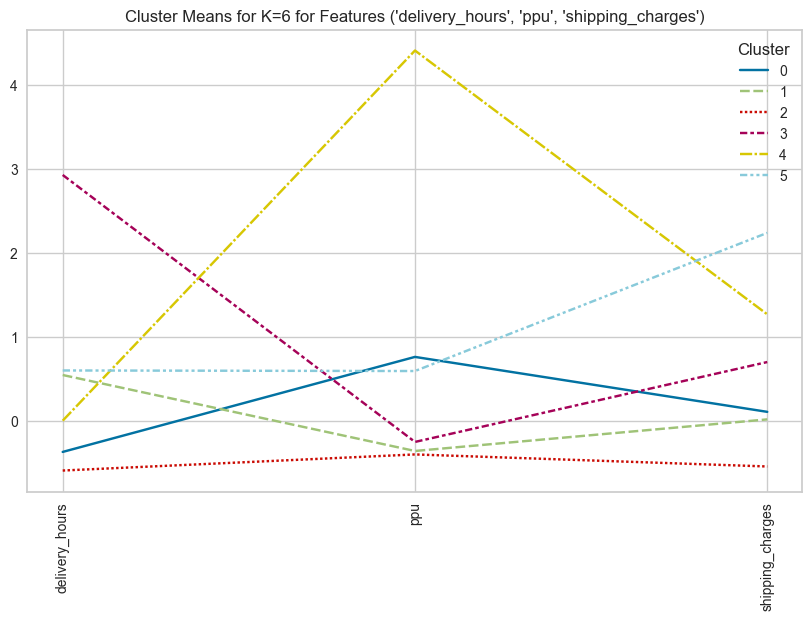

Cluster Percentages for K=6 for Features ('delivery_hours', 'ppu', 'shipping_charges'):
Cluster
0    16.749015
1    26.303225
2    43.068895
3     4.642480
4     2.585633
5     6.650752
Name: count, dtype: float64


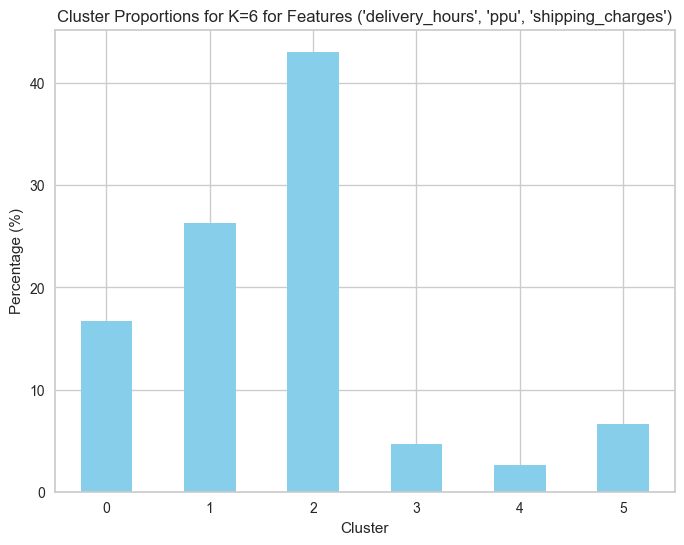

Features: ('volume', 'Diff_days', 'ppu')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


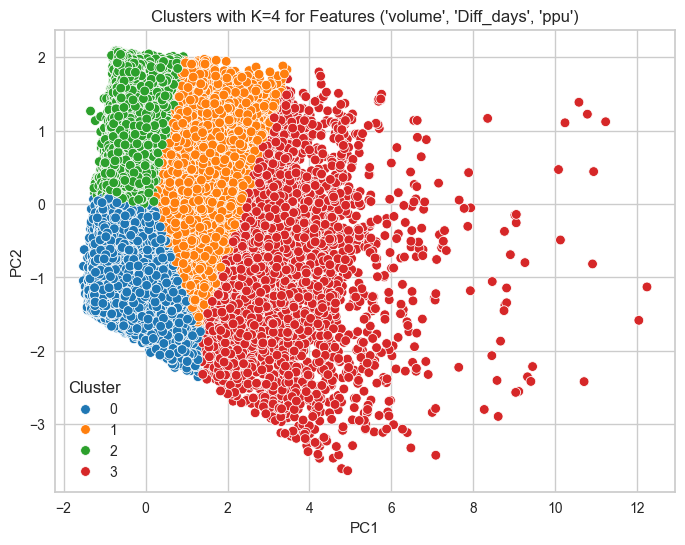

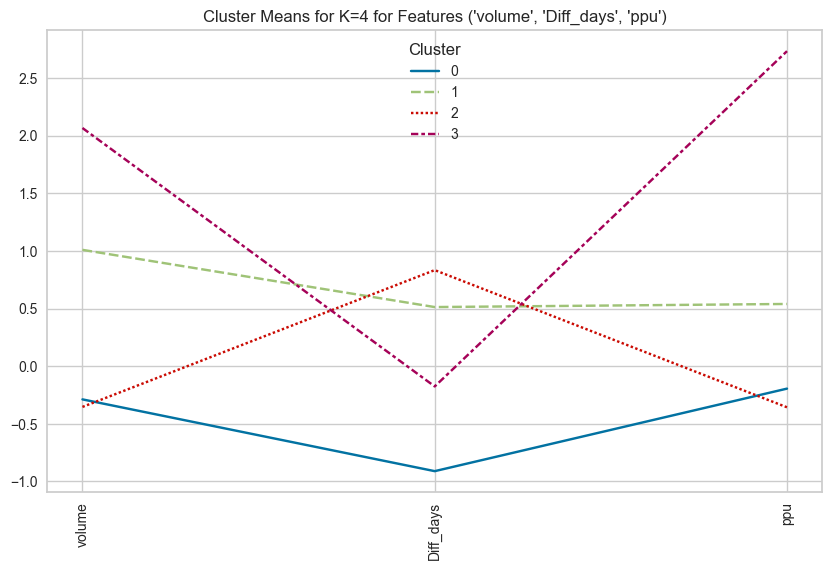

Cluster Percentages for K=4 for Features ('volume', 'Diff_days', 'ppu'):
Cluster
0    42.168156
1    15.123799
2    37.772720
3     4.935324
Name: count, dtype: float64


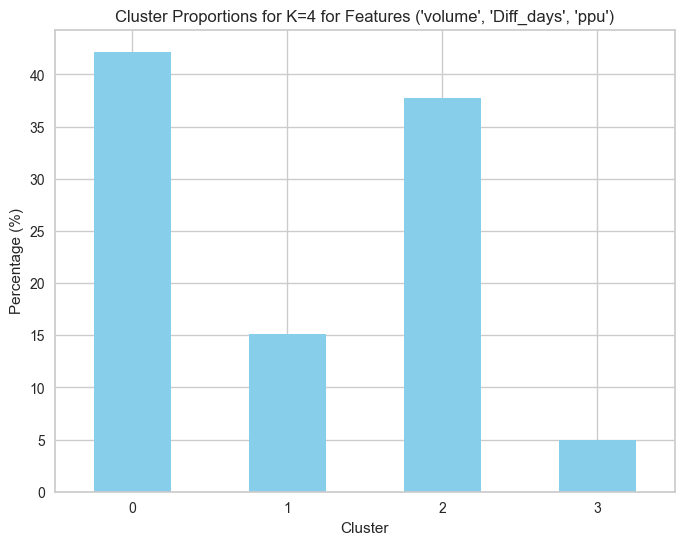

K=5에 대한 클러스터링 진행 중...


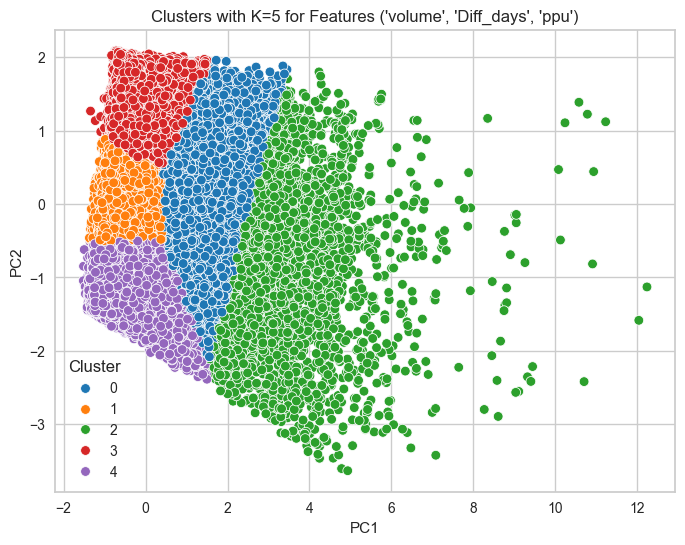

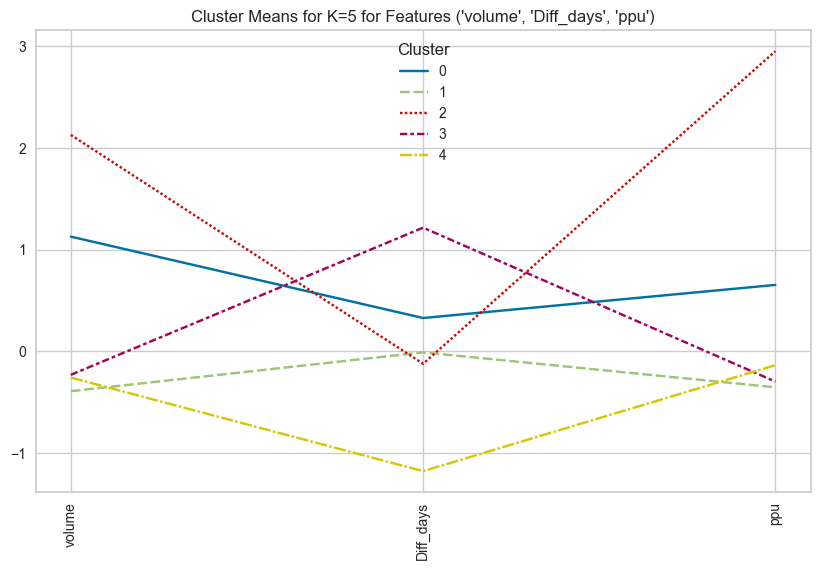

Cluster Percentages for K=5 for Features ('volume', 'Diff_days', 'ppu'):
Cluster
0    13.591573
1    29.103980
2     4.259424
3    24.566979
4    28.478044
Name: count, dtype: float64


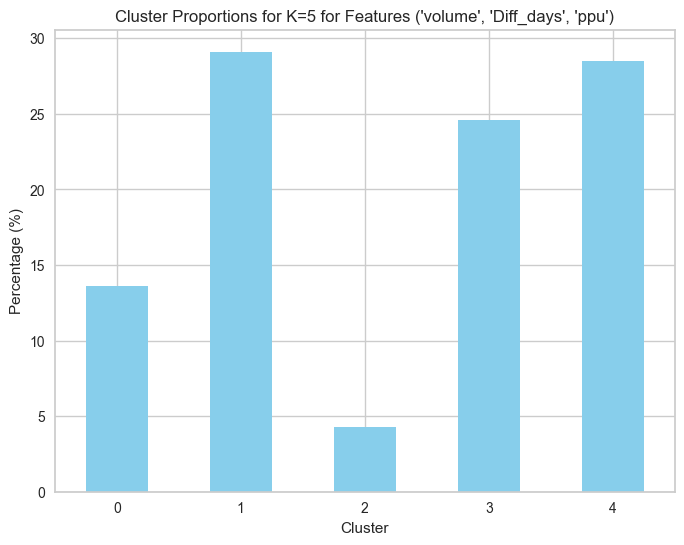

K=6에 대한 클러스터링 진행 중...


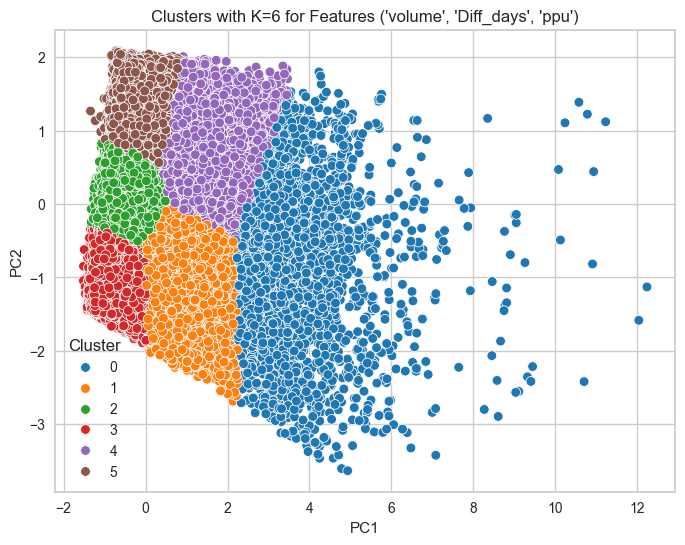

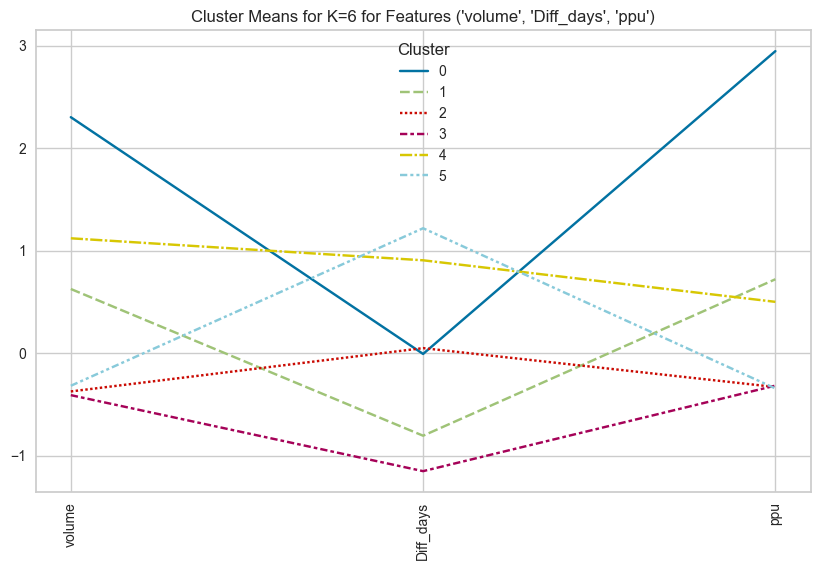

Cluster Percentages for K=6 for Features ('volume', 'Diff_days', 'ppu'):
Cluster
0     3.888858
1    10.969855
2    27.507911
3    25.097152
4    10.463277
5    22.072947
Name: count, dtype: float64


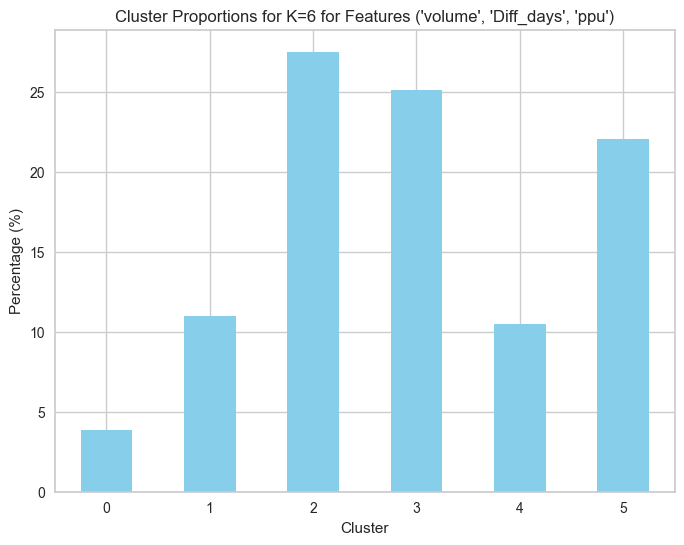

Features: ('volume', 'Diff_days', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


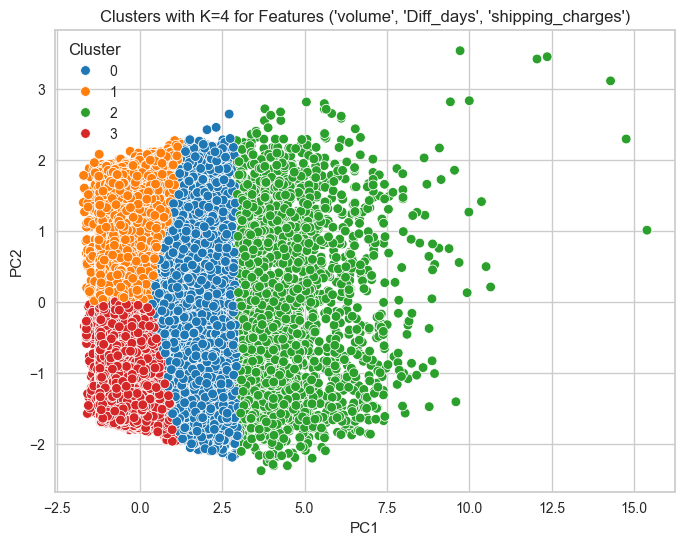

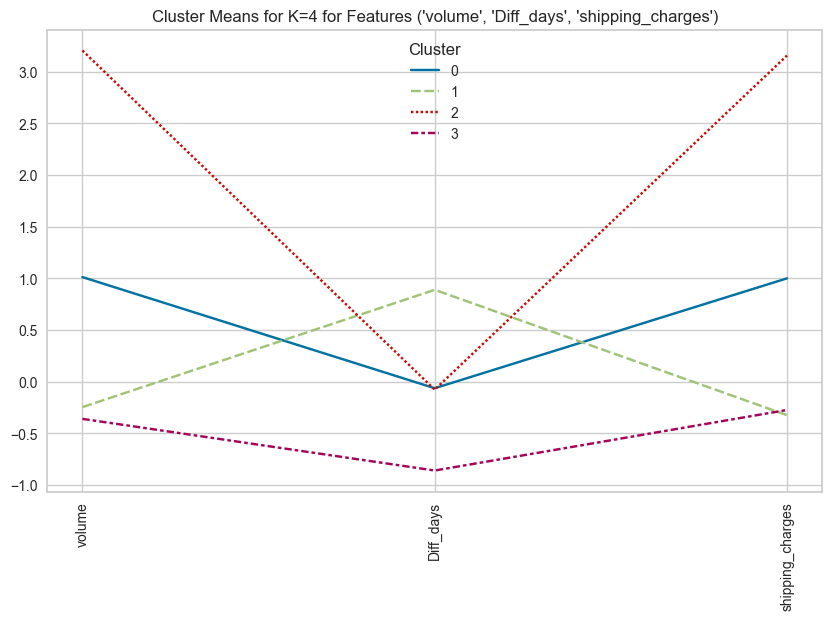

Cluster Percentages for K=4 for Features ('volume', 'Diff_days', 'shipping_charges'):
Cluster
0    14.603342
1    41.153611
2     3.197691
3    41.045356
Name: count, dtype: float64


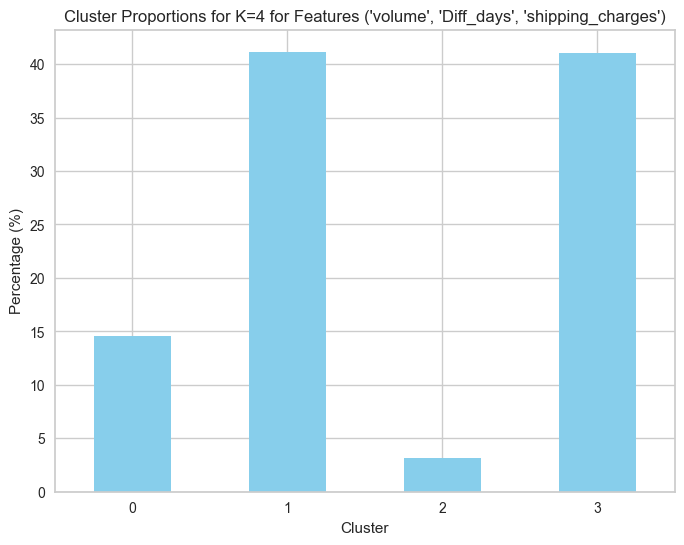

K=5에 대한 클러스터링 진행 중...


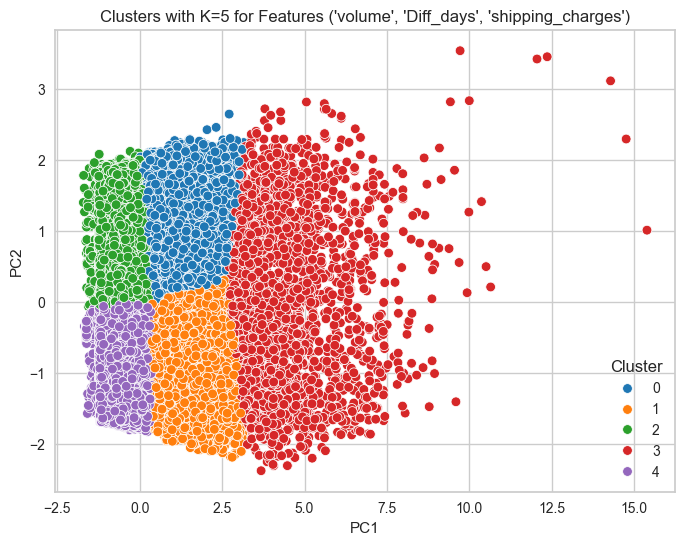

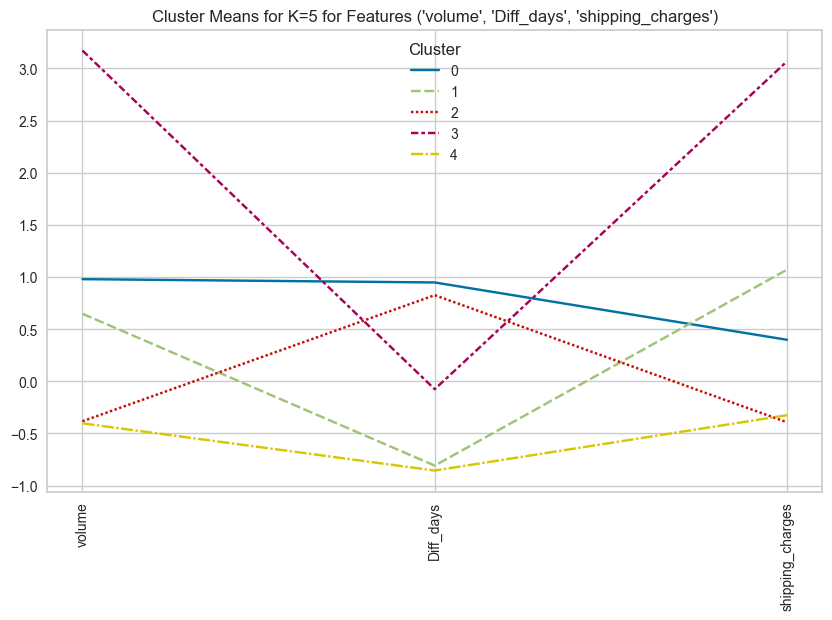

Cluster Percentages for K=5 for Features ('volume', 'Diff_days', 'shipping_charges'):
Cluster
0    11.715150
1    10.781103
2    36.436185
3     3.367013
4    37.700550
Name: count, dtype: float64


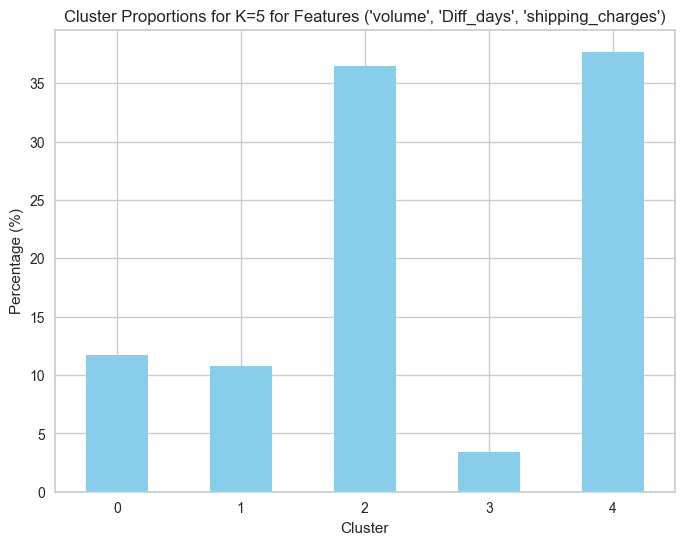

K=6에 대한 클러스터링 진행 중...


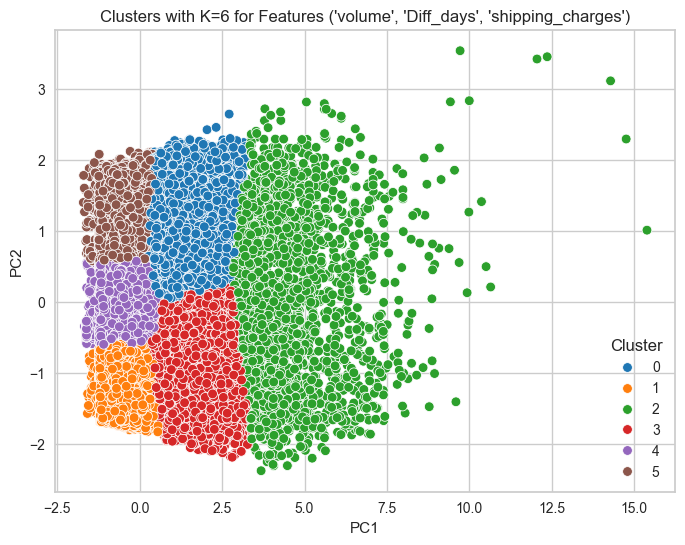

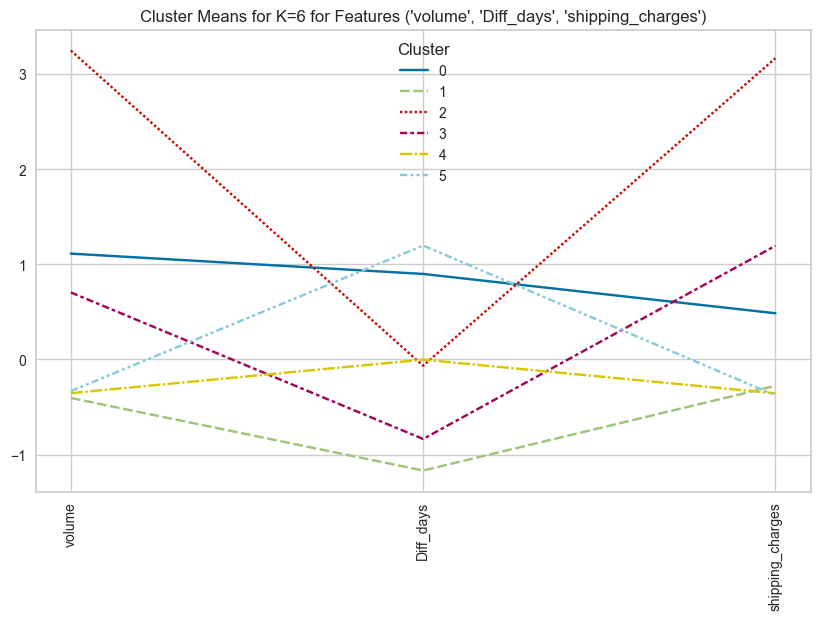

Cluster Percentages for K=6 for Features ('volume', 'Diff_days', 'shipping_charges'):
Cluster
0    10.223172
1    24.673847
2     3.106090
3     9.454283
4    29.310776
5    23.231833
Name: count, dtype: float64


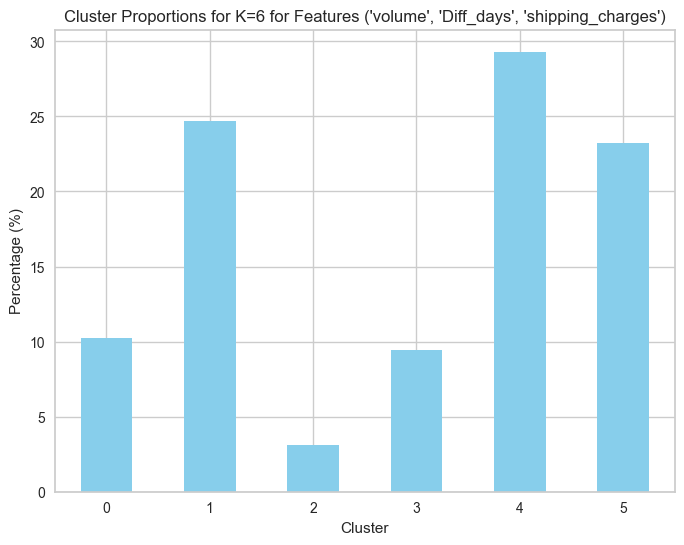

Features: ('volume', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


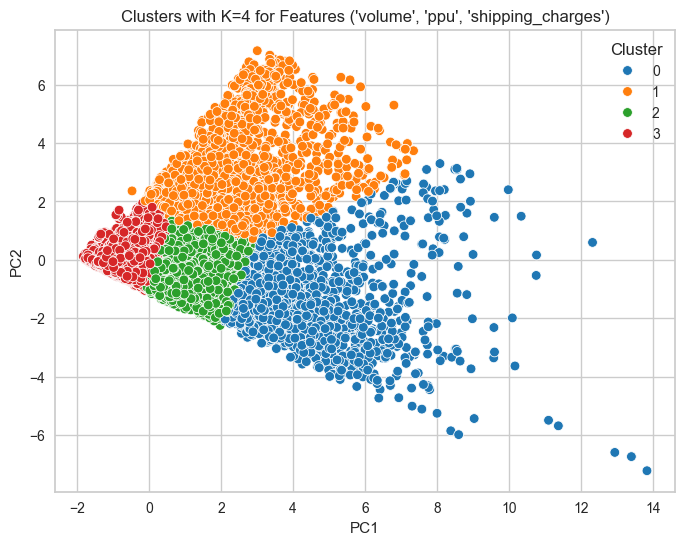

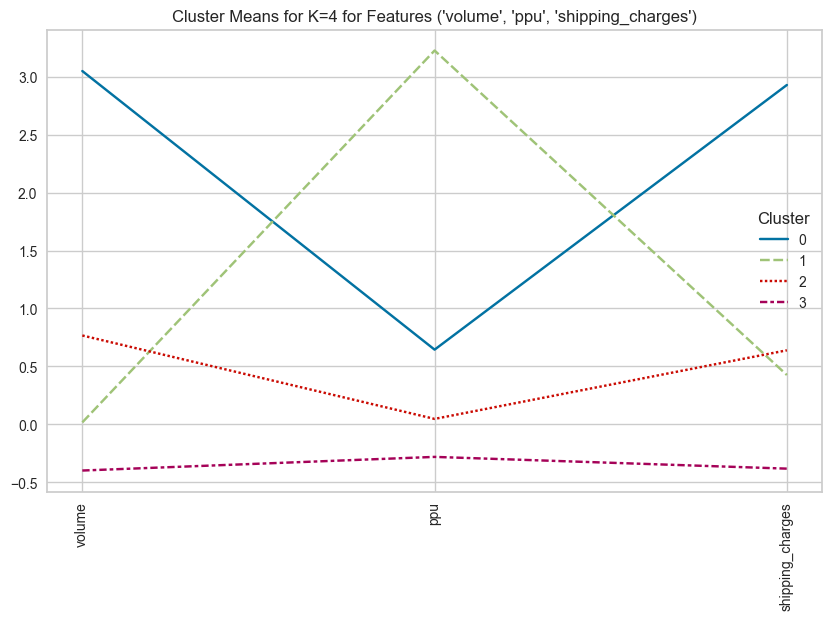

Cluster Percentages for K=4 for Features ('volume', 'ppu', 'shipping_charges'):
Cluster
0     3.691778
1     5.043580
2    21.549714
3    69.714928
Name: count, dtype: float64


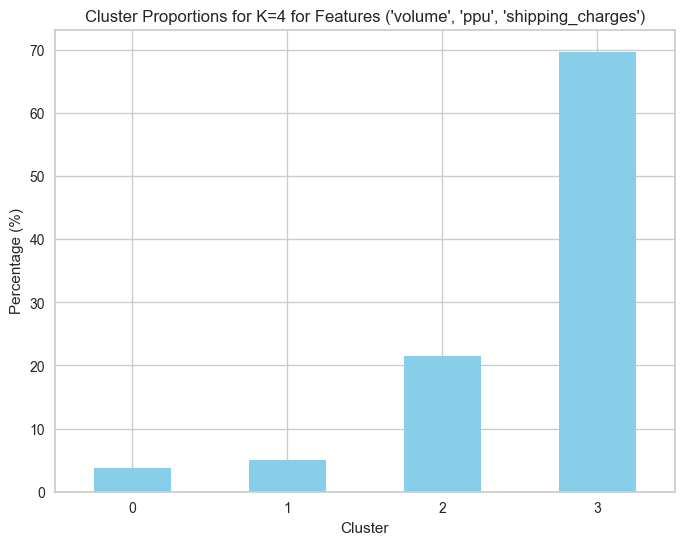

K=5에 대한 클러스터링 진행 중...


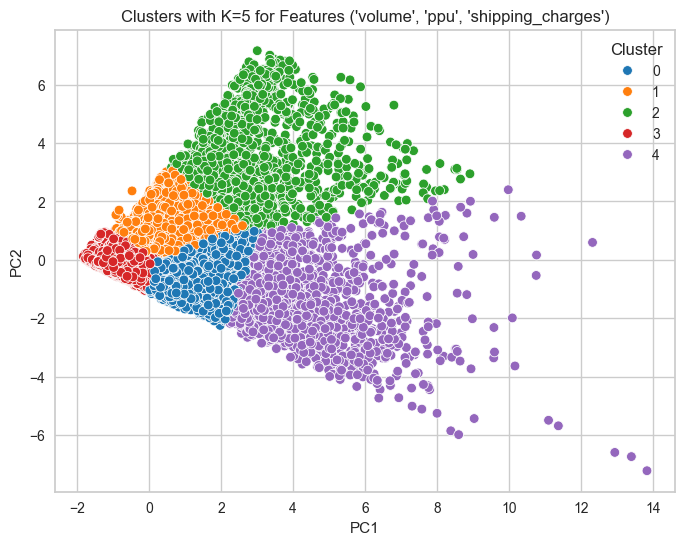

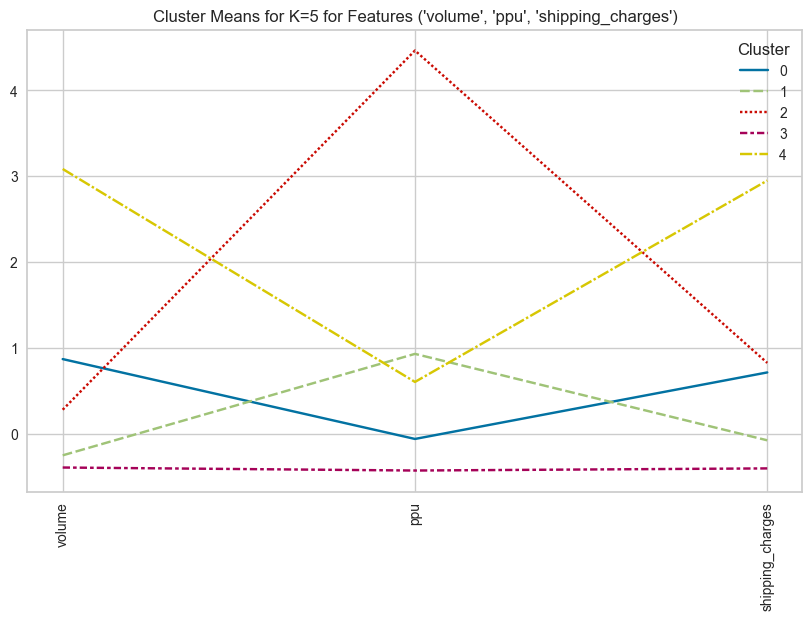

Cluster Percentages for K=5 for Features ('volume', 'ppu', 'shipping_charges'):
Cluster
0    18.492200
1    14.821240
2     2.521790
3    60.640926
4     3.523844
Name: count, dtype: float64


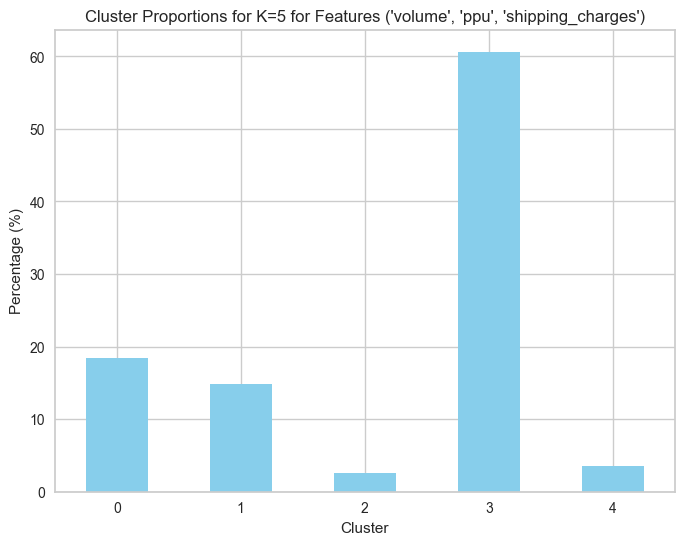

K=6에 대한 클러스터링 진행 중...


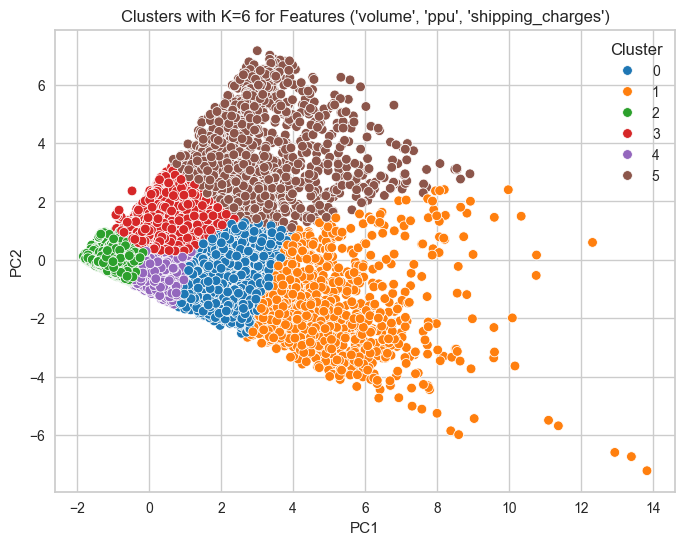

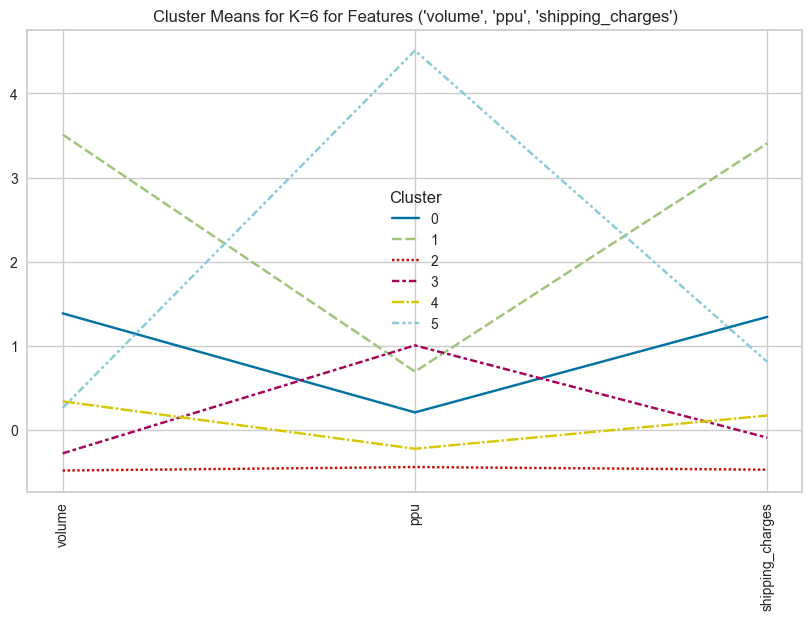

Cluster Percentages for K=6 for Features ('volume', 'ppu', 'shipping_charges'):
Cluster
0     8.842225
1     2.367734
2    51.142231
3    13.222395
4    21.981347
5     2.444068
Name: count, dtype: float64


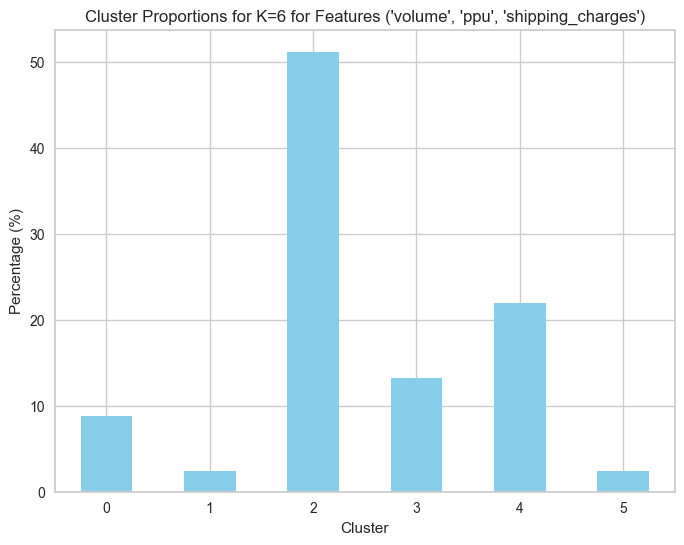

Features: ('Diff_days', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


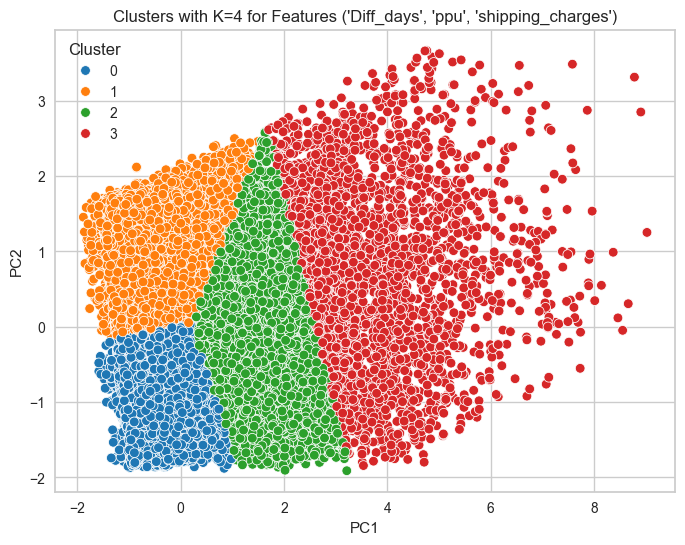

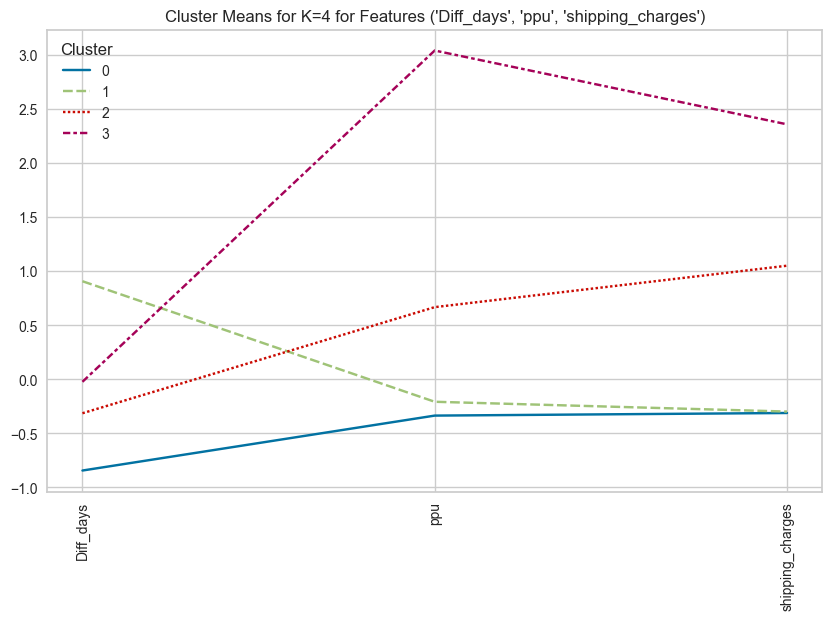

Cluster Percentages for K=4 for Features ('Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    39.395159
1    41.933604
2    14.632488
3     4.038750
Name: count, dtype: float64


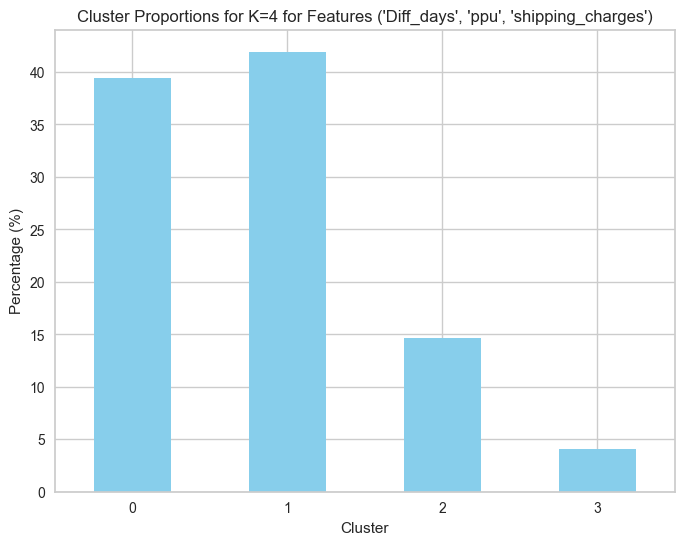

K=5에 대한 클러스터링 진행 중...


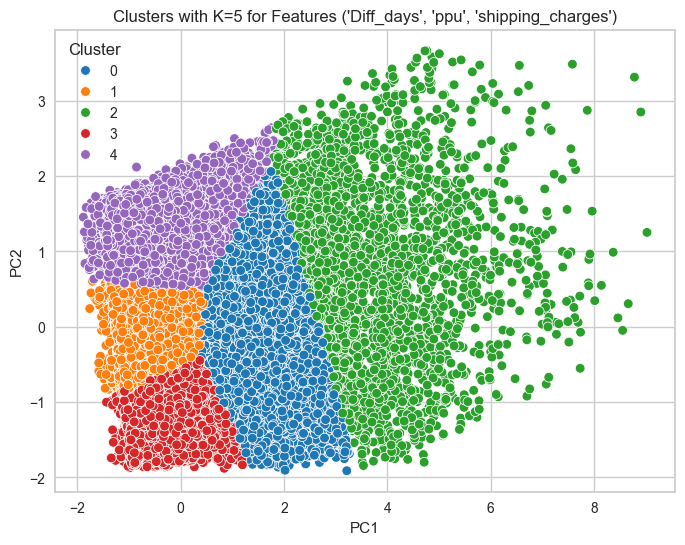

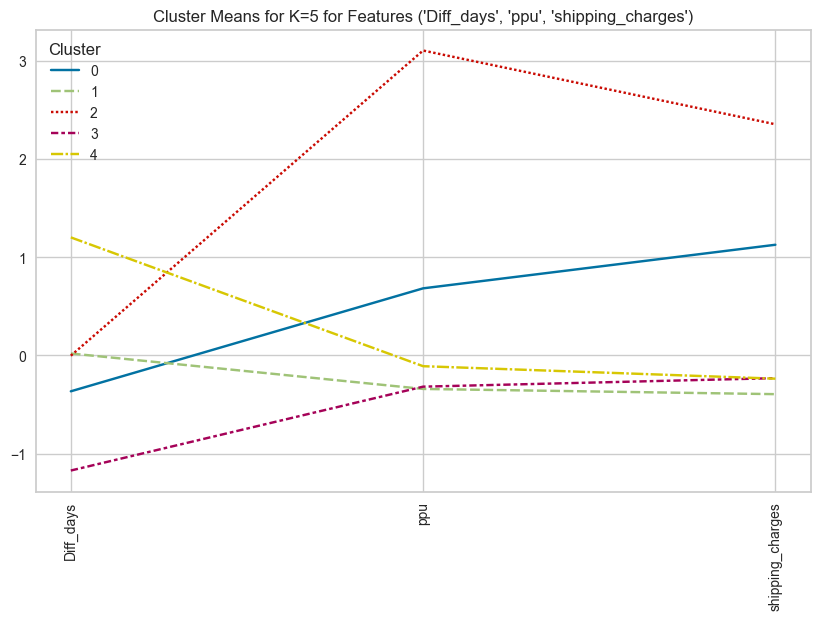

Cluster Percentages for K=5 for Features ('Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    13.255704
1    29.439849
2     3.897185
3    25.247044
4    28.160218
Name: count, dtype: float64


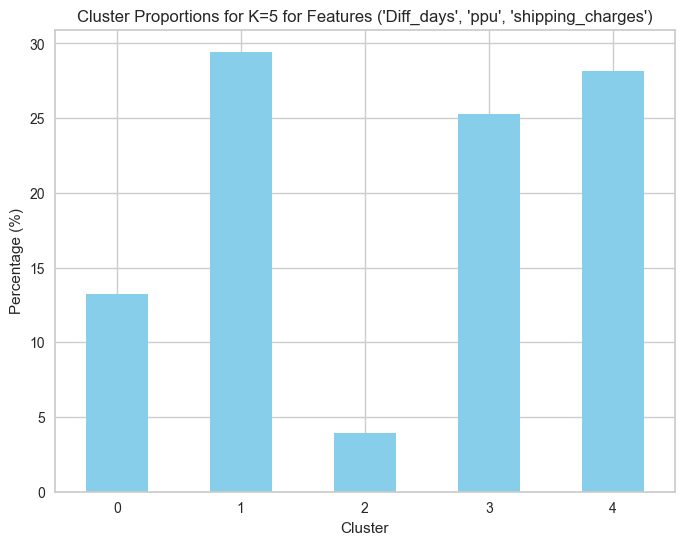

K=6에 대한 클러스터링 진행 중...


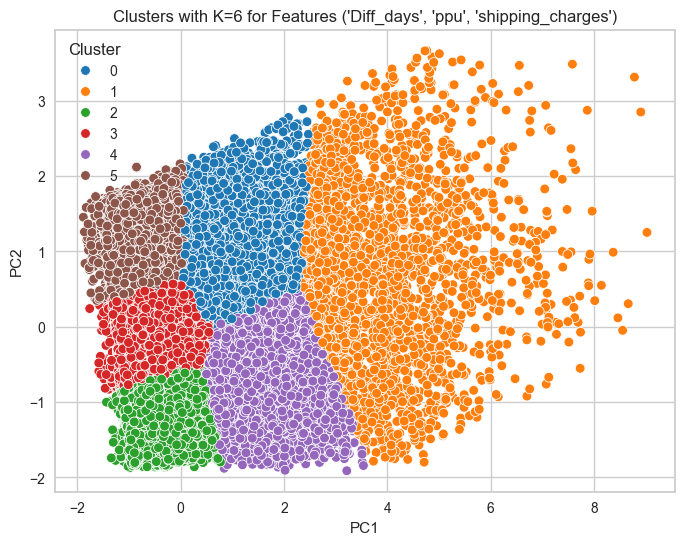

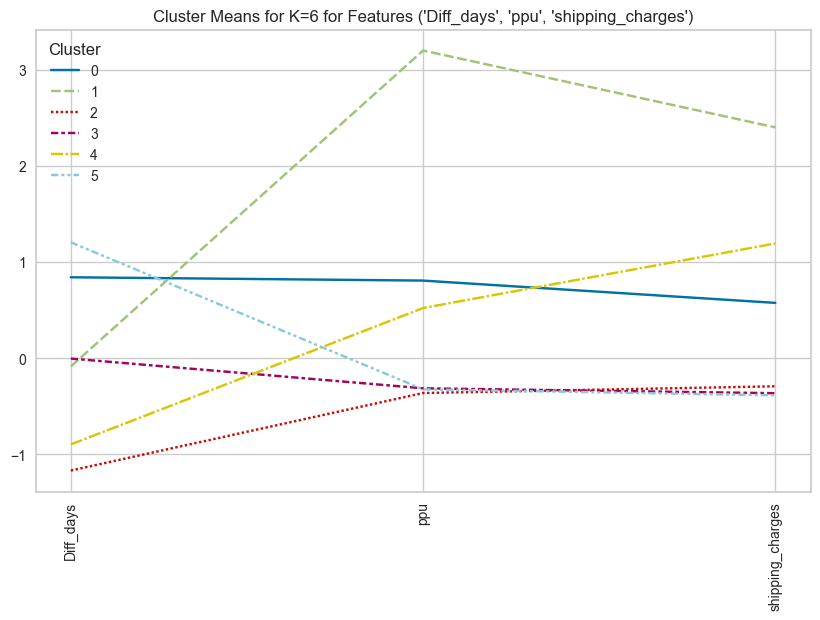

Cluster Percentages for K=6 for Features ('Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    10.561816
1     3.612669
2    23.632932
3    29.110920
4     9.848443
5    23.233220
Name: count, dtype: float64


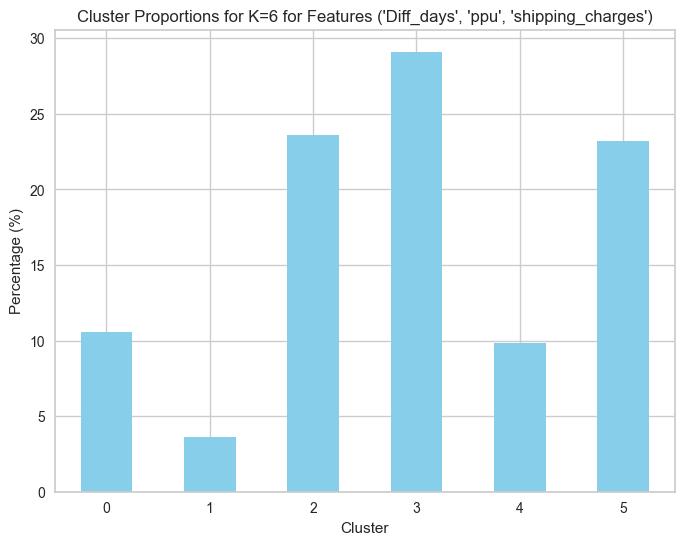

Features: ('delivery_hours', 'volume', 'Diff_days', 'ppu')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


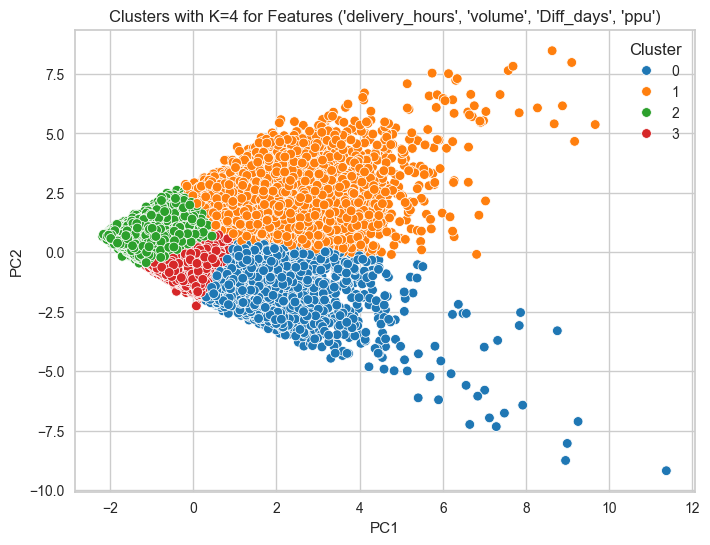

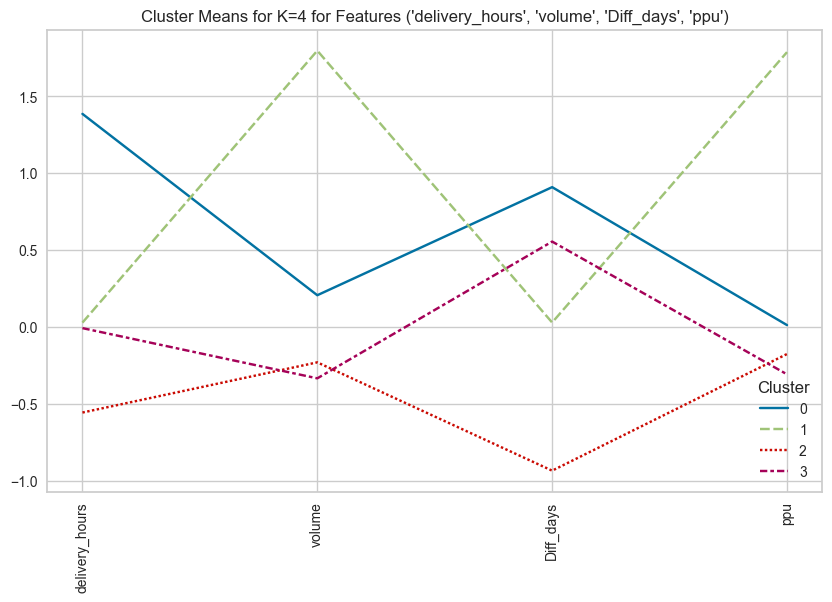

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'Diff_days', 'ppu'):
Cluster
0    14.955865
1    10.048298
2    37.302226
3    37.693610
Name: count, dtype: float64


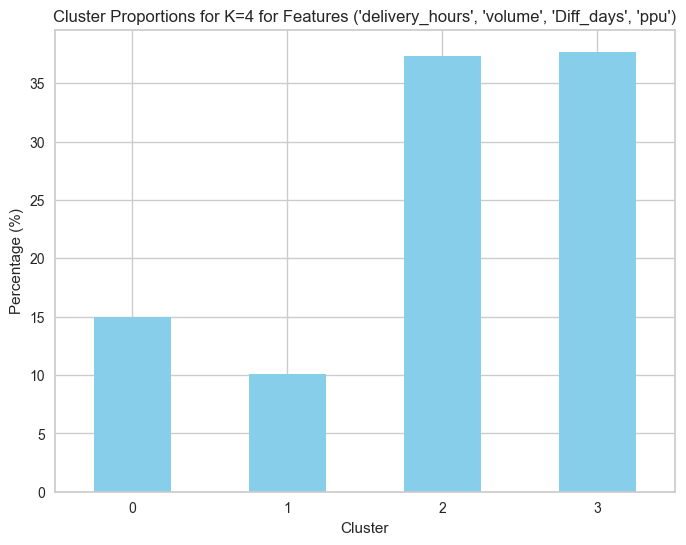

K=5에 대한 클러스터링 진행 중...


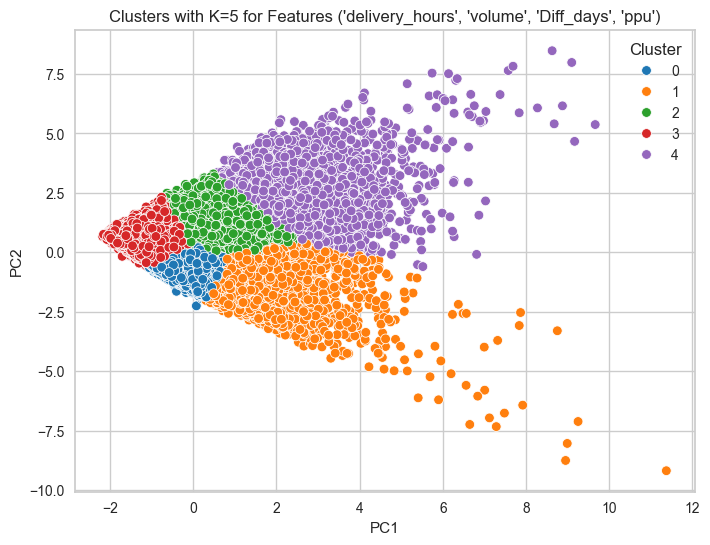

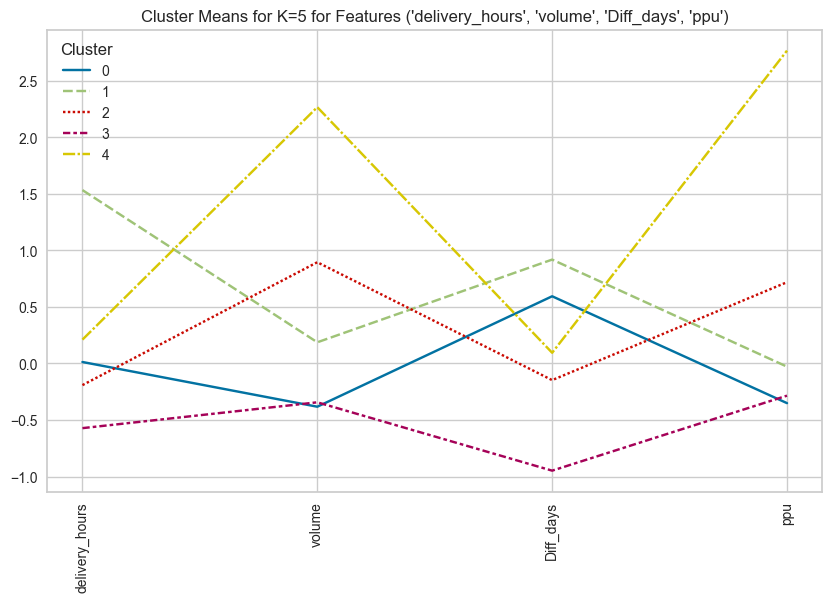

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'Diff_days', 'ppu'):
Cluster
0    35.292566
1    13.212680
2    13.834453
3    33.224616
4     4.435685
Name: count, dtype: float64


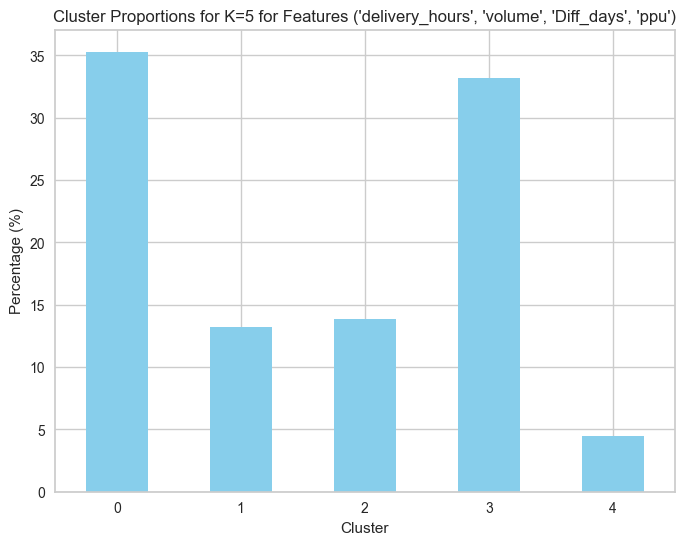

K=6에 대한 클러스터링 진행 중...


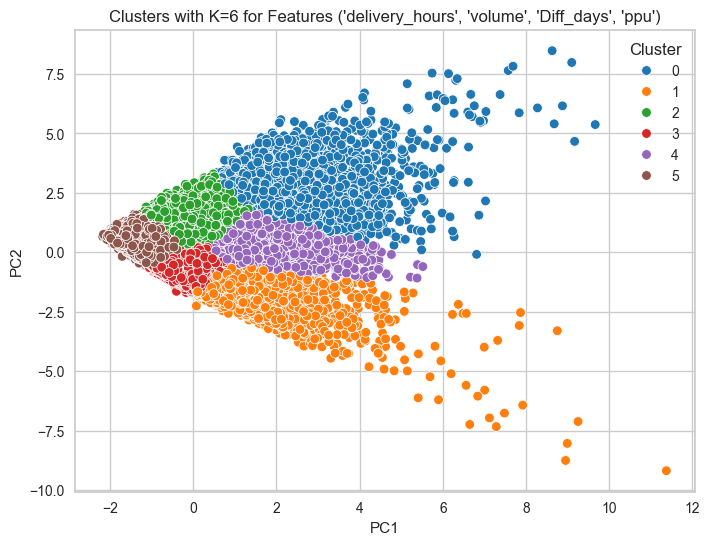

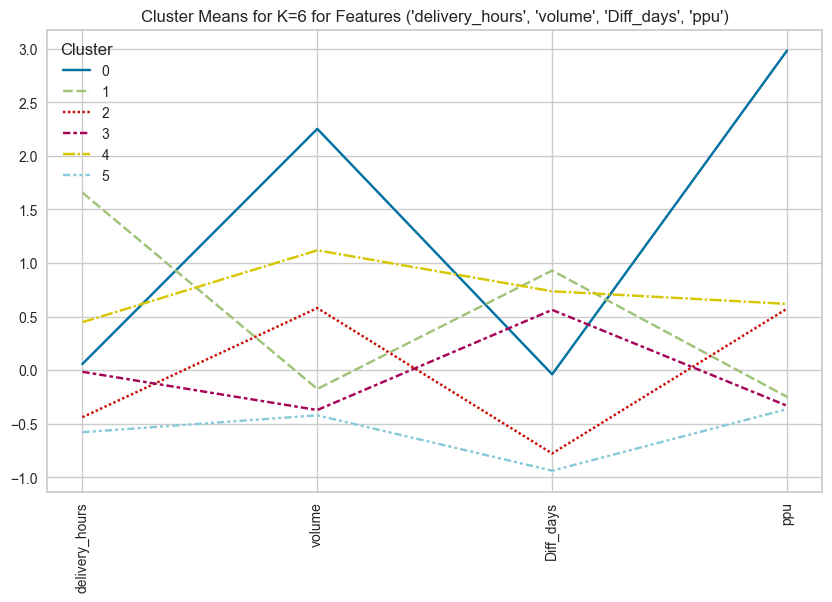

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'Diff_days', 'ppu'):
Cluster
0     3.902737
1    10.789430
2    11.846999
3    34.246100
4    10.045523
5    29.169211
Name: count, dtype: float64


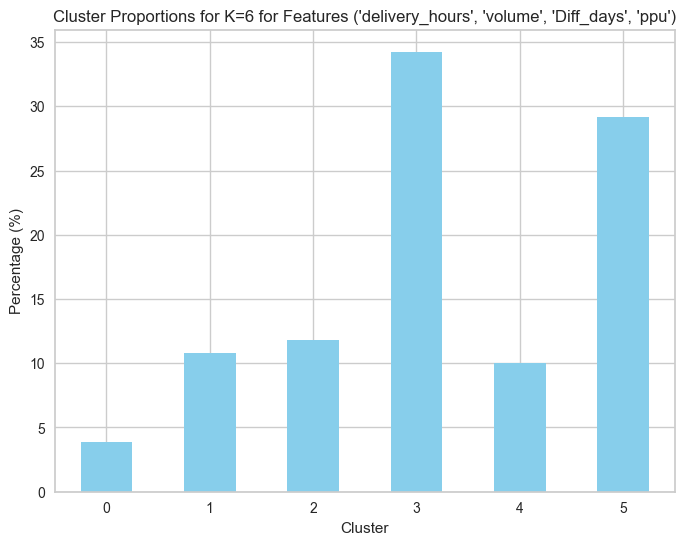

Features: ('delivery_hours', 'volume', 'Diff_days', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


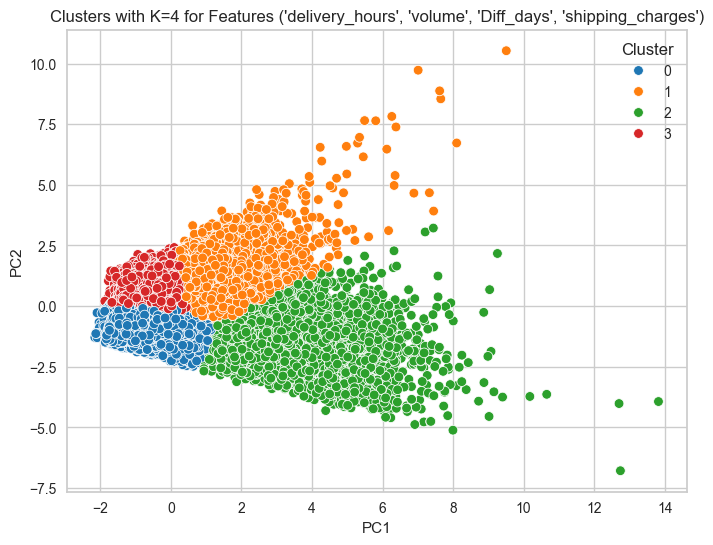

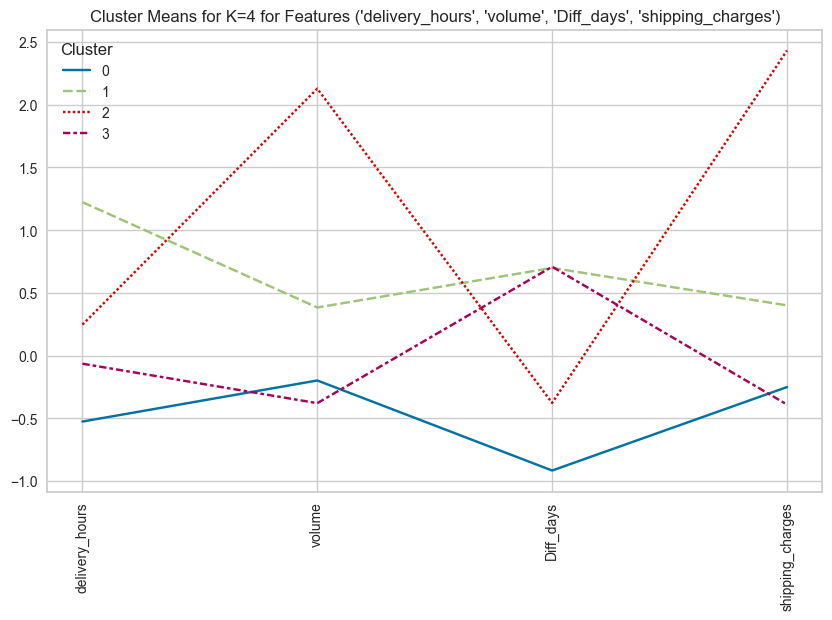

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'Diff_days', 'shipping_charges'):
Cluster
0    38.738689
1    17.198690
2     7.110143
3    36.952479
Name: count, dtype: float64


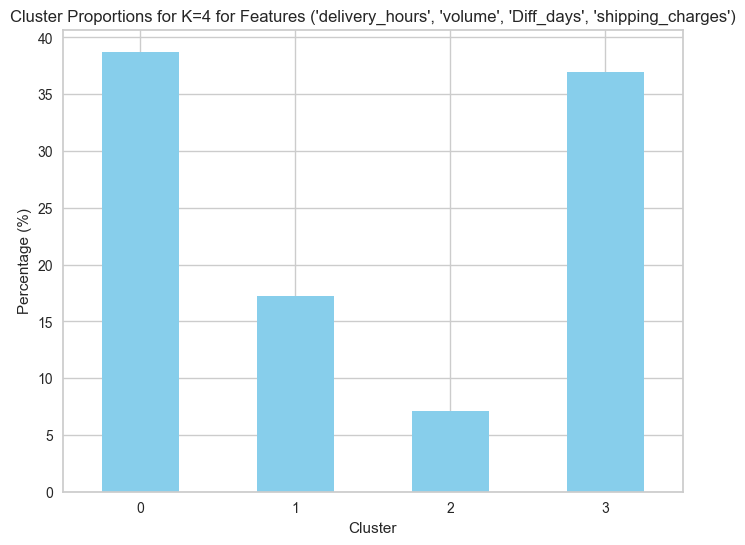

K=5에 대한 클러스터링 진행 중...


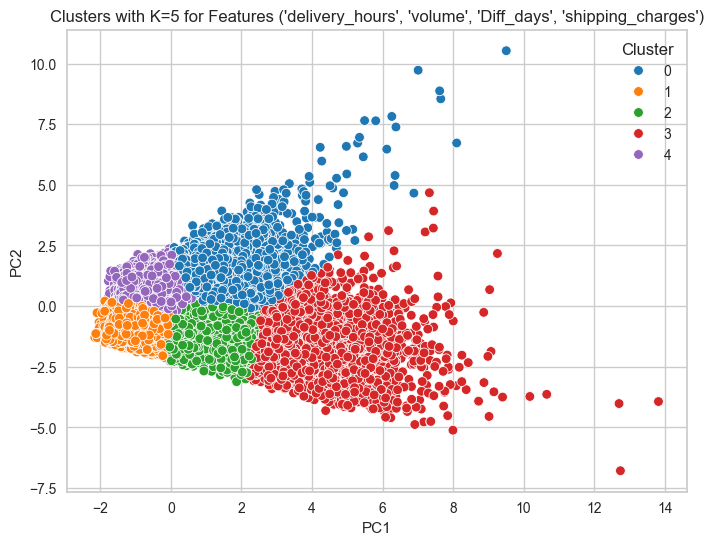

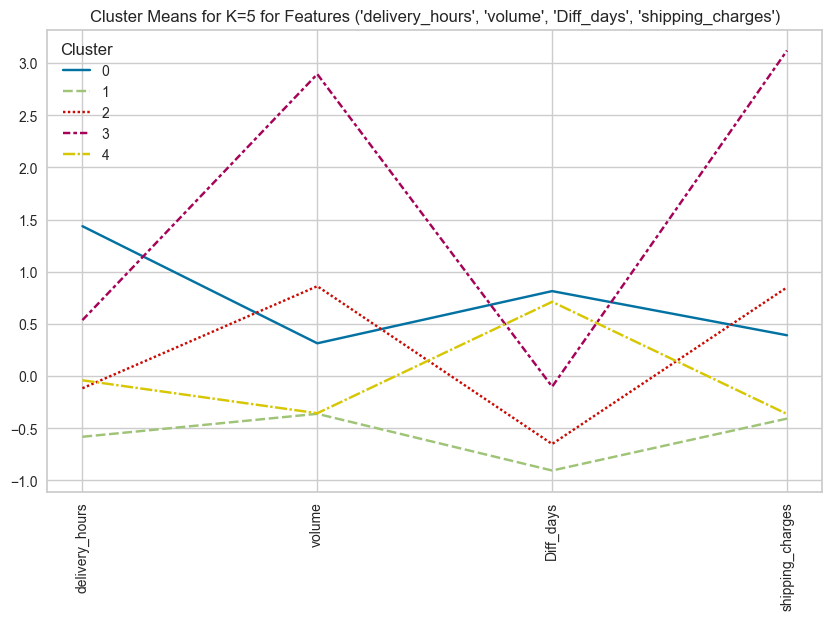

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'Diff_days', 'shipping_charges'):
Cluster
0    14.035696
1    33.020596
2    11.910842
3     3.662633
4    37.370233
Name: count, dtype: float64


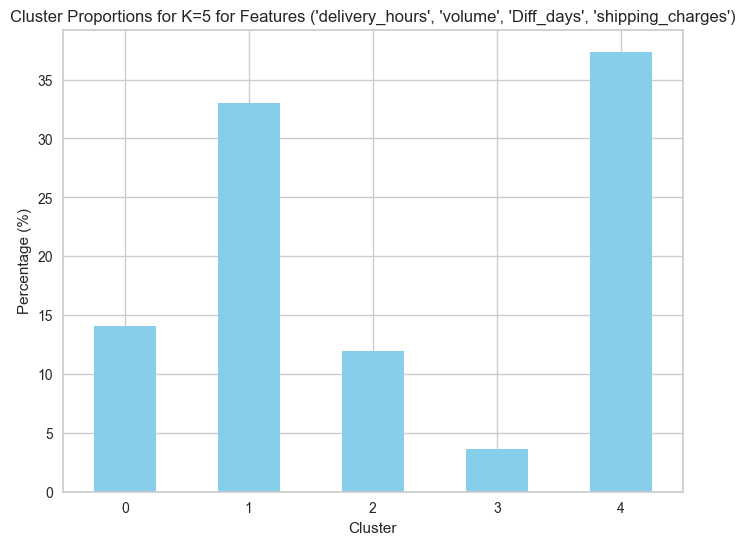

K=6에 대한 클러스터링 진행 중...


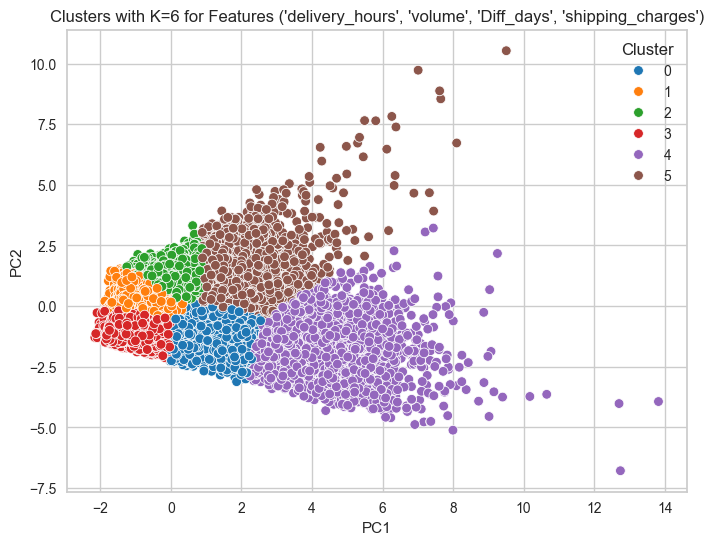

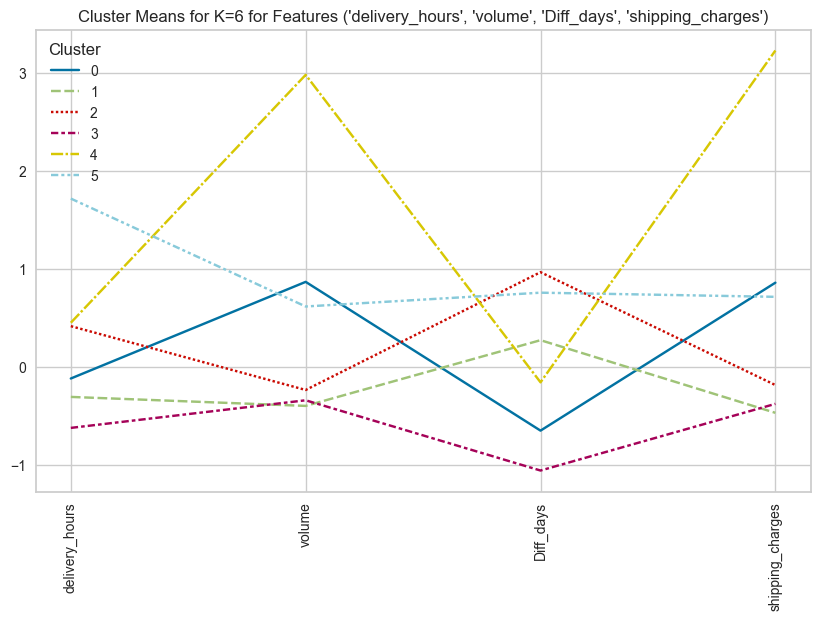

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'Diff_days', 'shipping_charges'):
Cluster
0    11.544440
1    25.589852
2    24.093710
3    26.856992
4     3.361461
5     8.553545
Name: count, dtype: float64


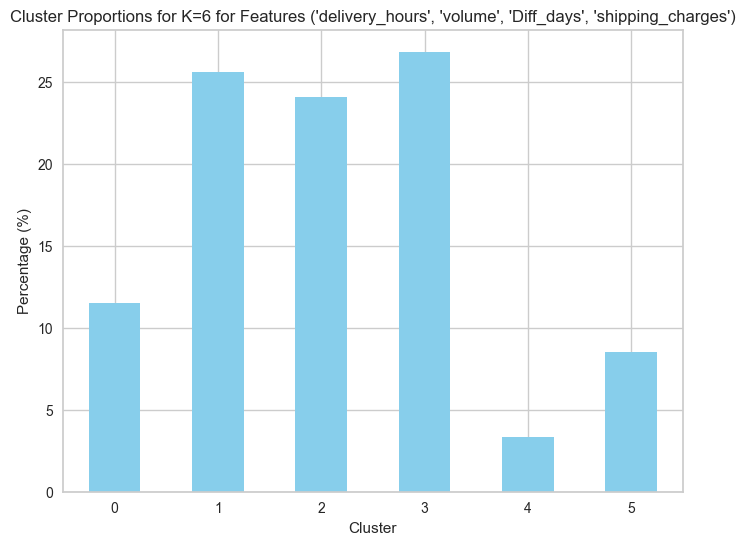

Features: ('delivery_hours', 'volume', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


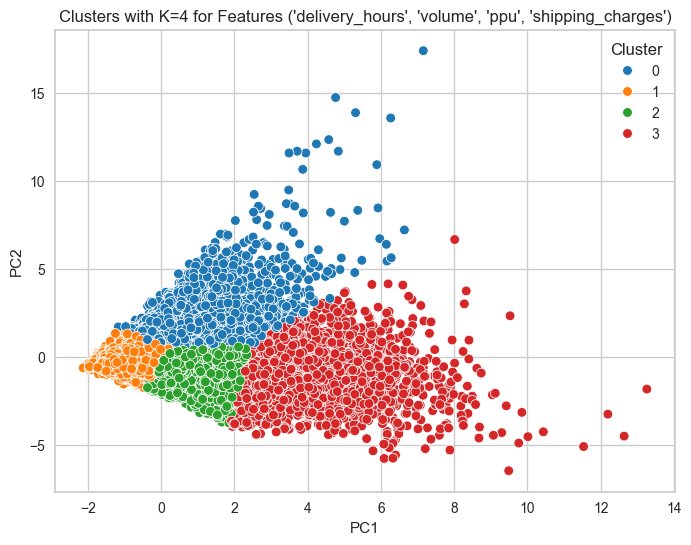

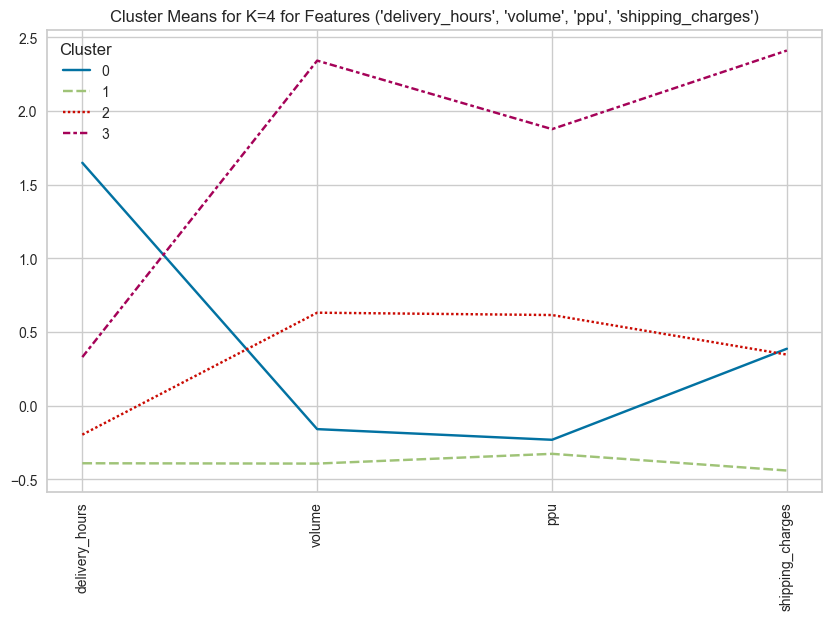

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'ppu', 'shipping_charges'):
Cluster
0    15.365292
1    58.371732
2    21.061178
3     5.201799
Name: count, dtype: float64


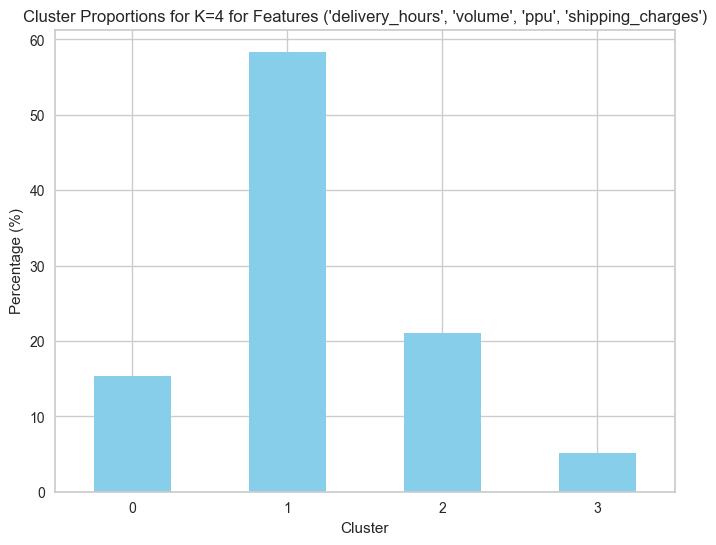

K=5에 대한 클러스터링 진행 중...


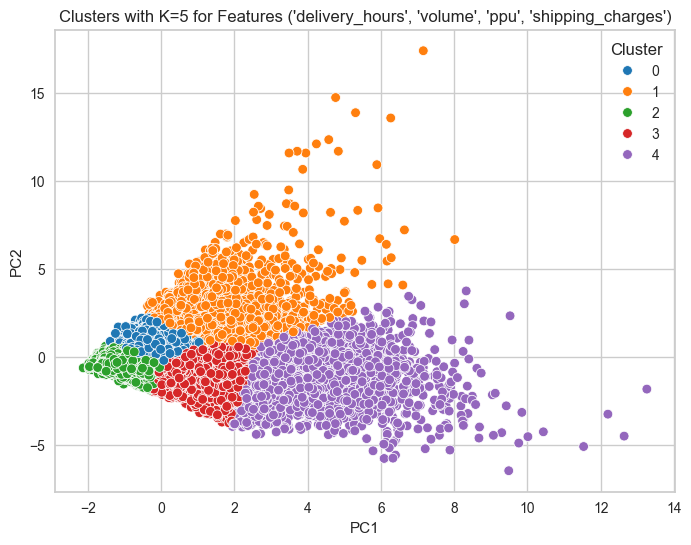

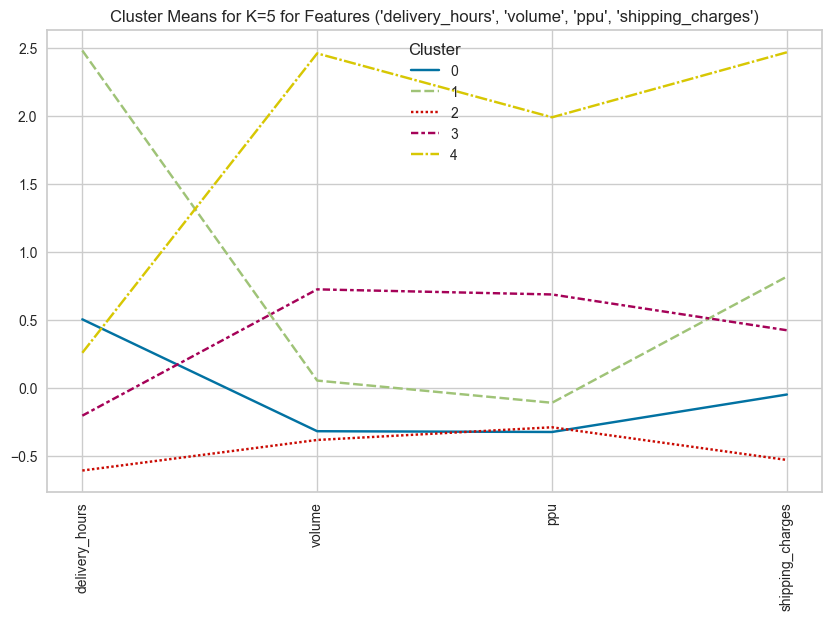

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'ppu', 'shipping_charges'):
Cluster
0    25.885472
1     6.668795
2    44.088991
3    18.740632
4     4.616111
Name: count, dtype: float64


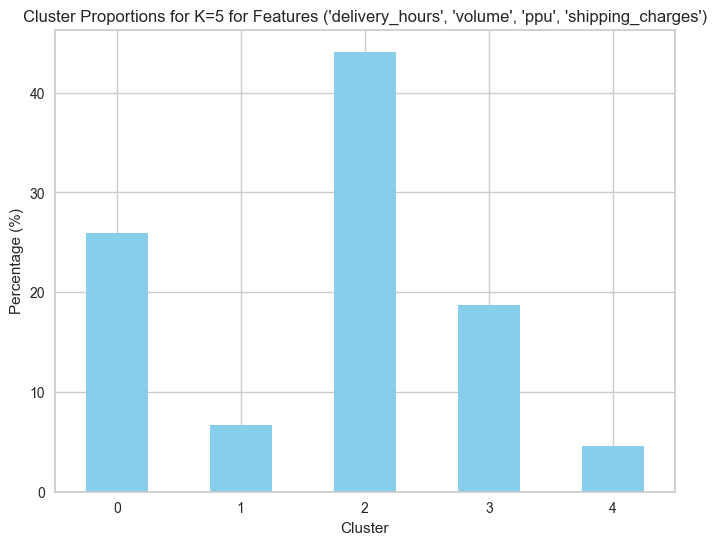

K=6에 대한 클러스터링 진행 중...


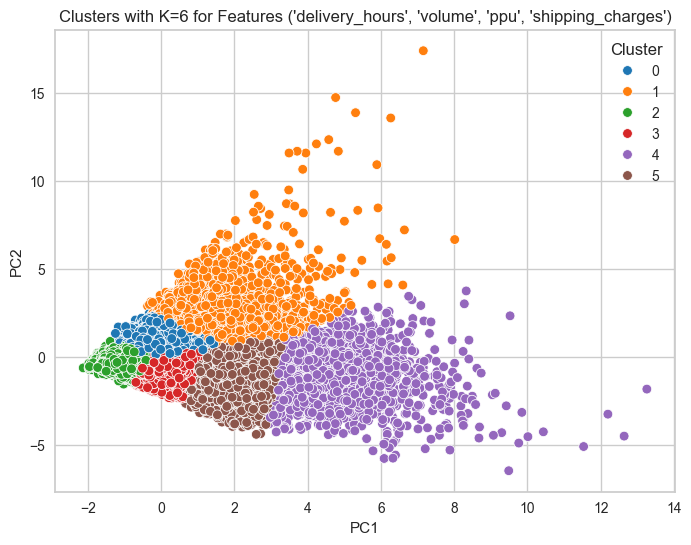

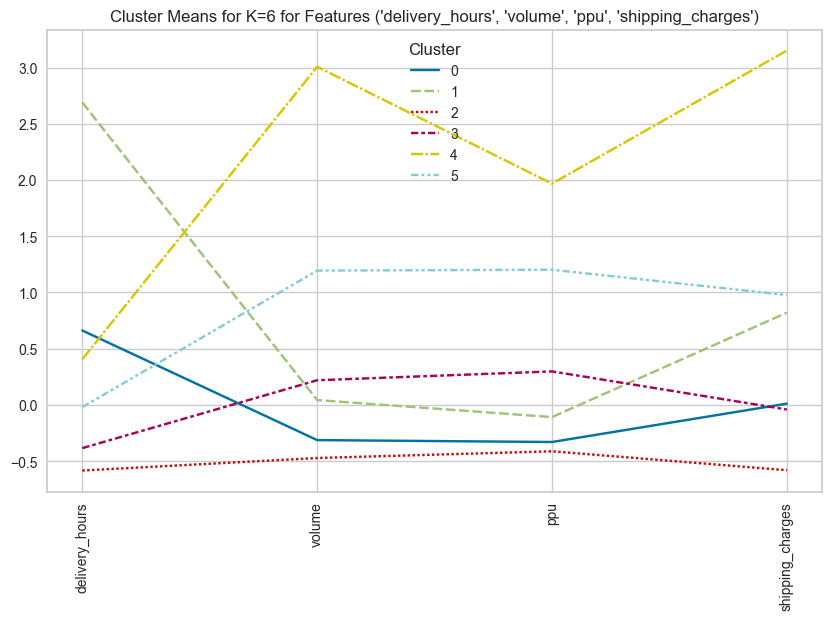

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'ppu', 'shipping_charges'):
Cluster
0    22.210348
1     5.539055
2    38.015600
3    21.739855
4     2.731361
5     9.763782
Name: count, dtype: float64


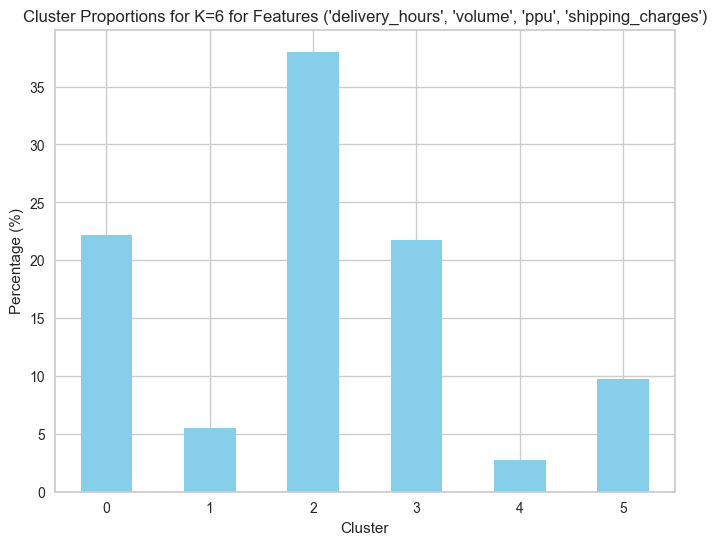

Features: ('delivery_hours', 'Diff_days', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


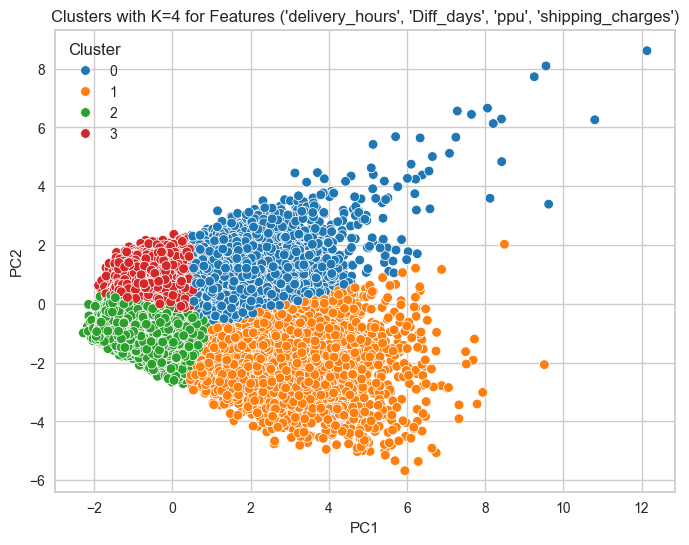

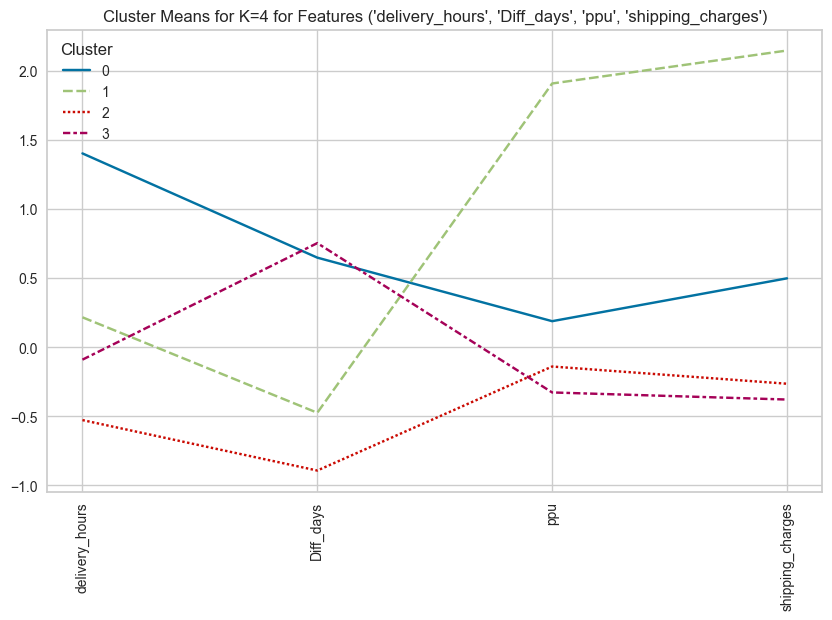

Cluster Percentages for K=4 for Features ('delivery_hours', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    15.895464
1     7.724976
2    38.970466
3    37.409093
Name: count, dtype: float64


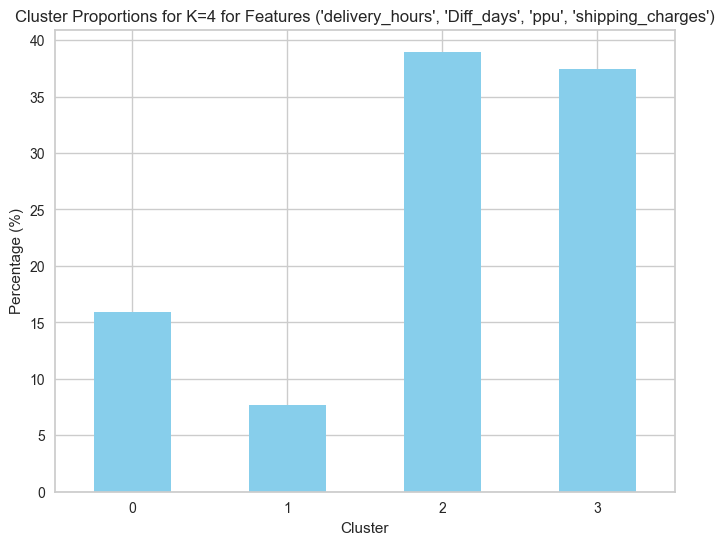

K=5에 대한 클러스터링 진행 중...


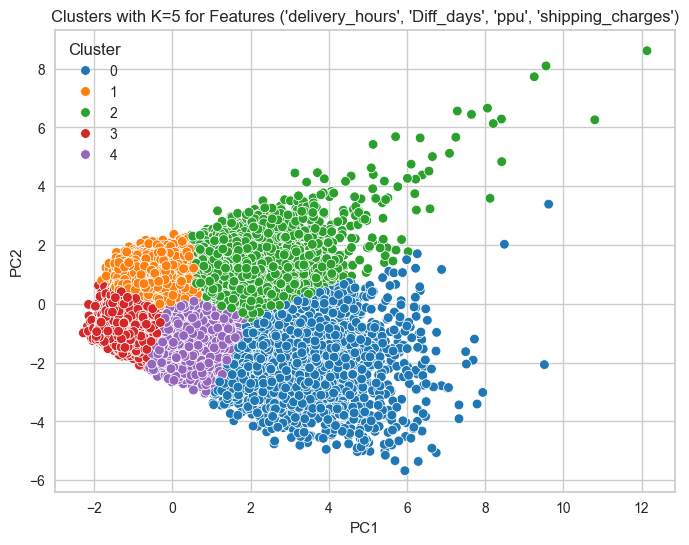

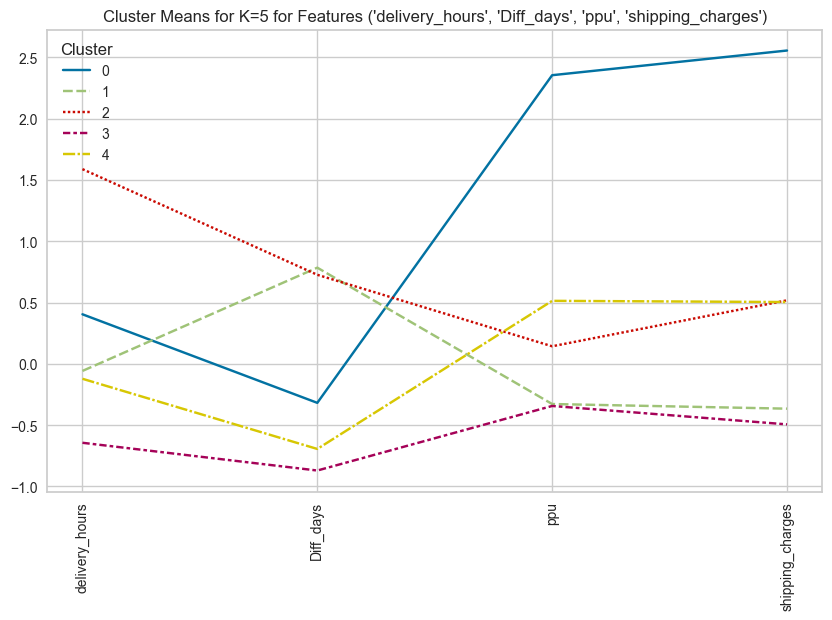

Cluster Percentages for K=5 for Features ('delivery_hours', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0     5.087992
1    36.501416
2    13.141898
3    29.381558
4    15.887137
Name: count, dtype: float64


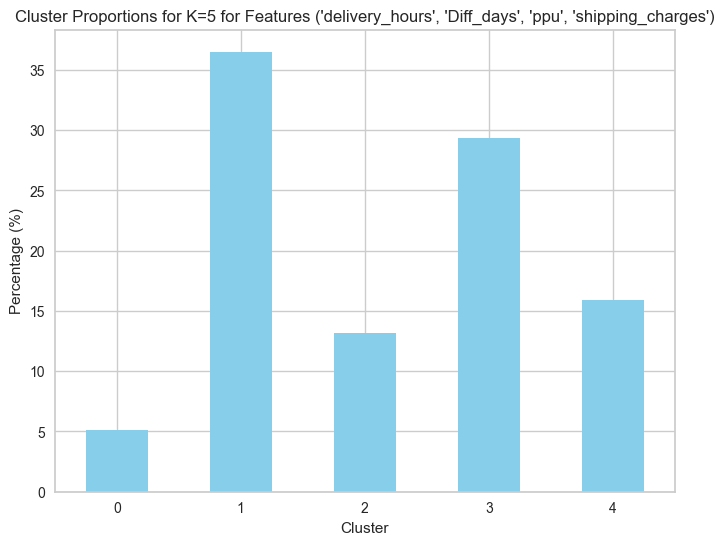

K=6에 대한 클러스터링 진행 중...


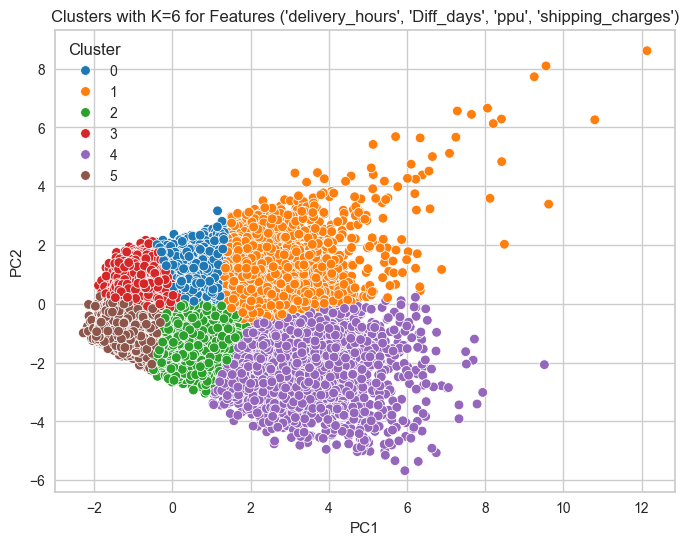

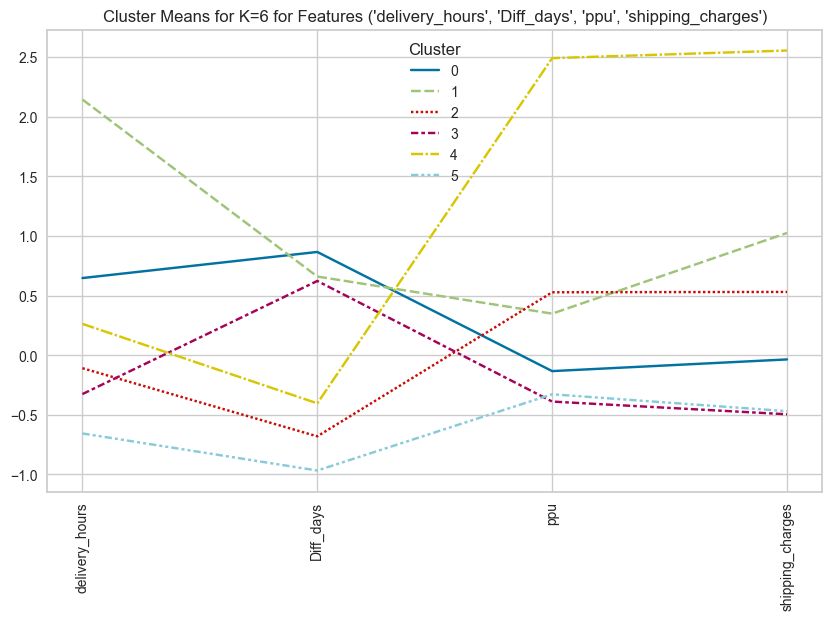

Cluster Percentages for K=6 for Features ('delivery_hours', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    20.177094
1     6.392605
2    15.337534
3    26.636318
4     4.632765
5    26.823683
Name: count, dtype: float64


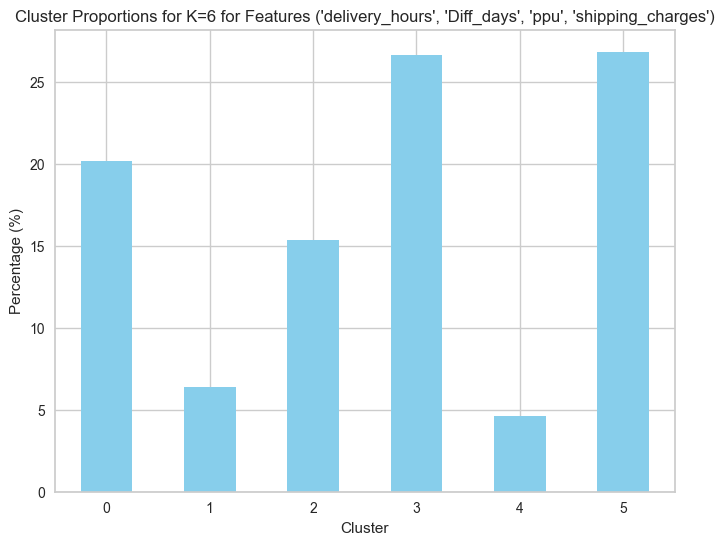

Features: ('volume', 'Diff_days', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


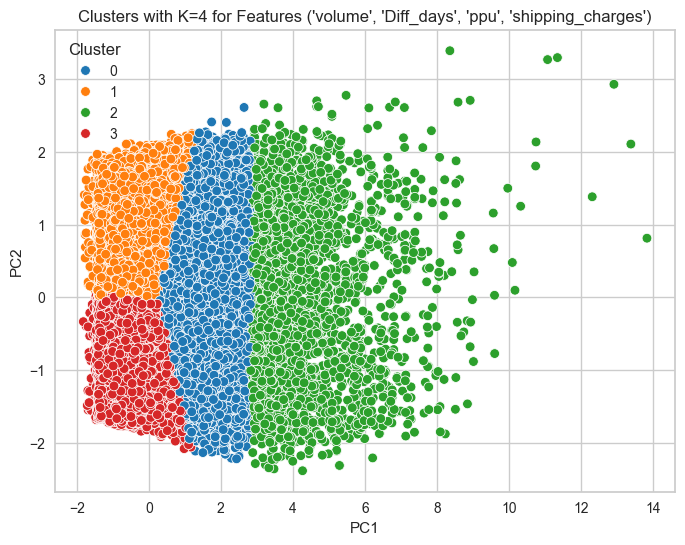

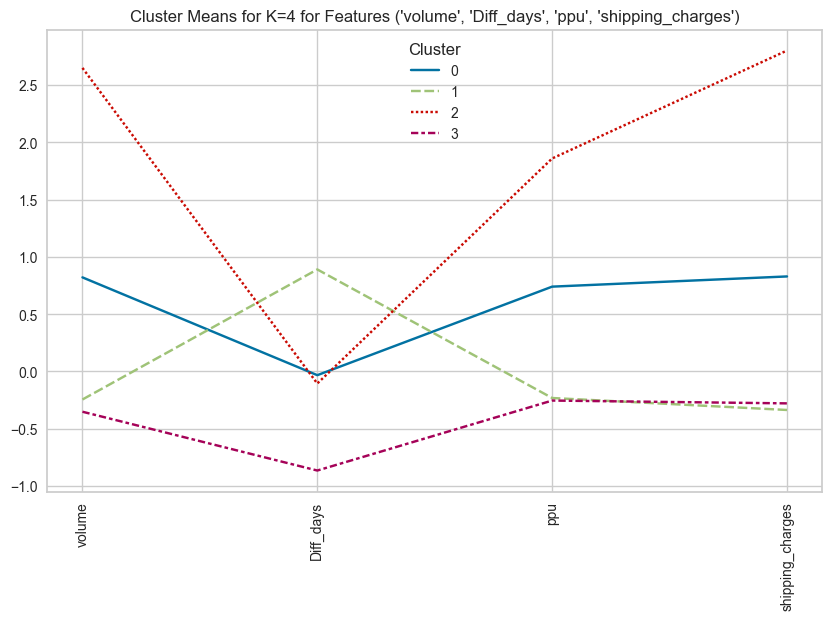

Cluster Percentages for K=4 for Features ('volume', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    16.299339
1    39.828180
2     3.919392
3    39.953089
Name: count, dtype: float64


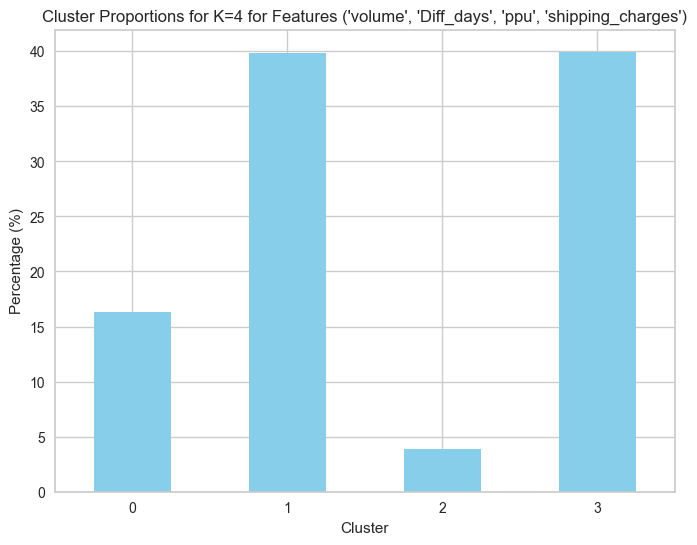

K=5에 대한 클러스터링 진행 중...


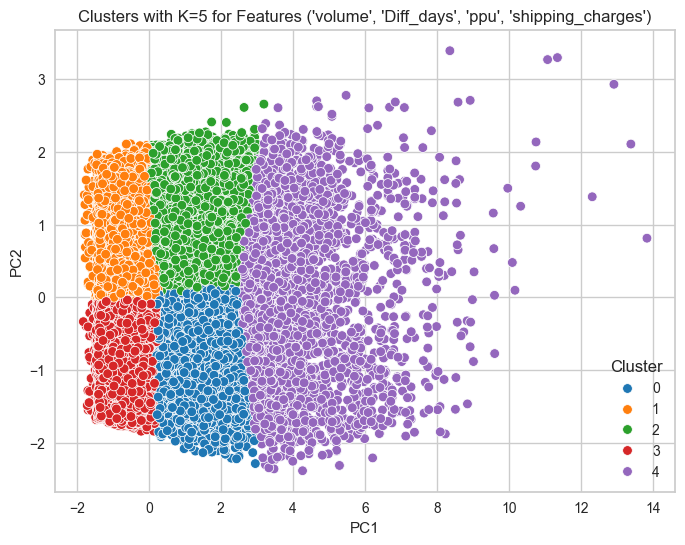

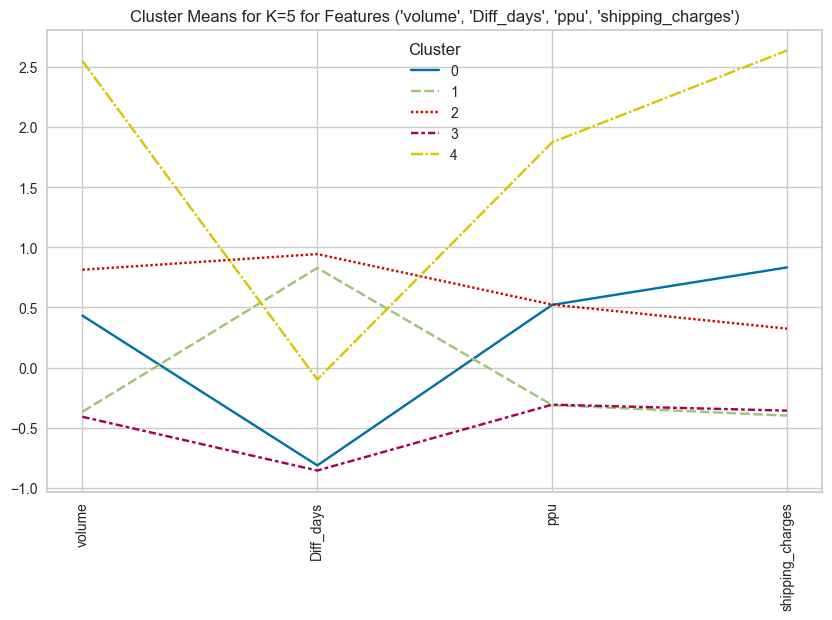

Cluster Percentages for K=5 for Features ('volume', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    12.971187
1    34.840115
2    12.782435
3    35.056626
4     4.349636
Name: count, dtype: float64


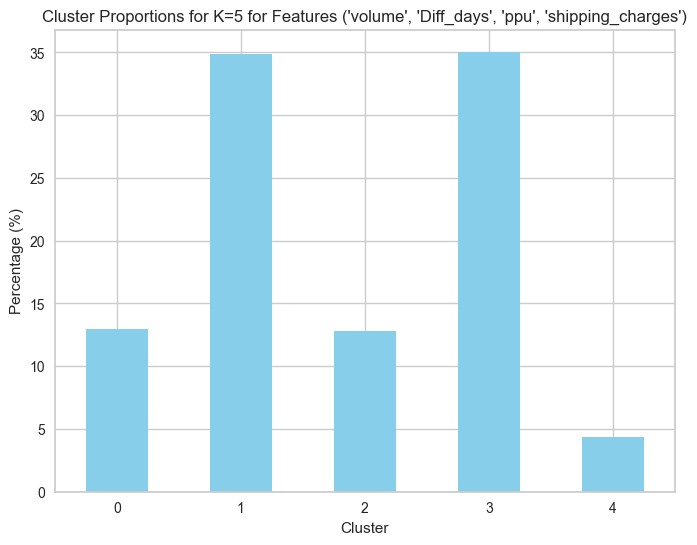

K=6에 대한 클러스터링 진행 중...


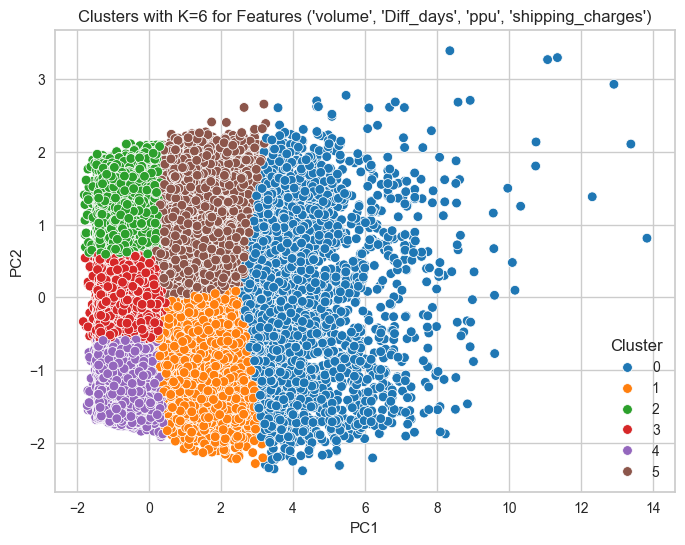

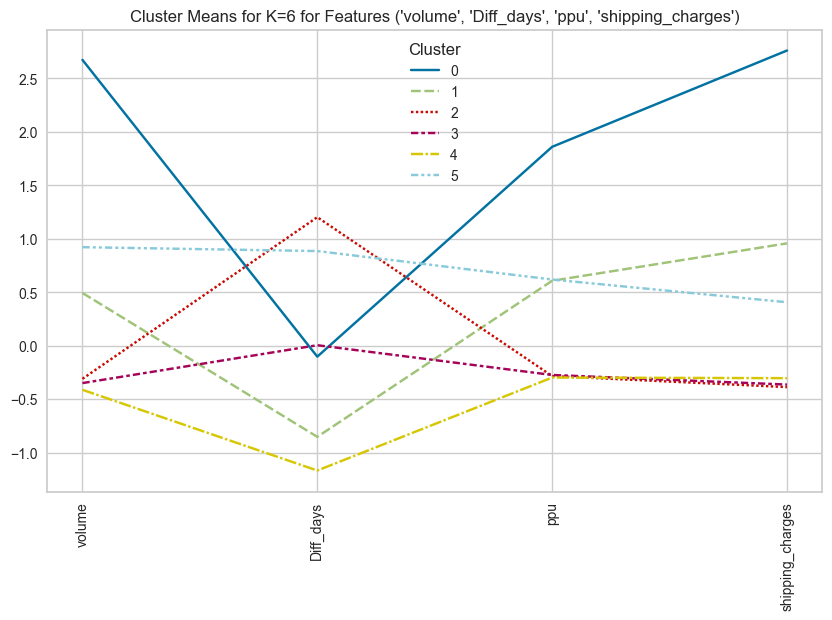

Cluster Percentages for K=6 for Features ('volume', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0     3.926331
1    10.992061
2    22.290846
3    28.140787
4    23.273469
5    11.376506
Name: count, dtype: float64


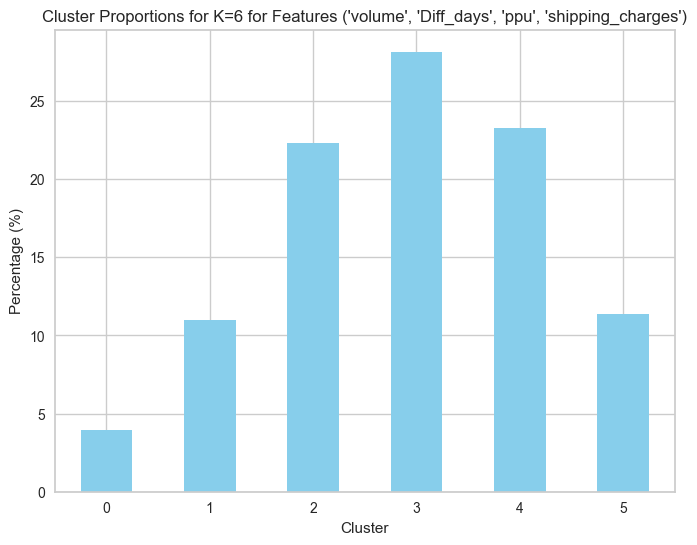

Features: ('delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
K=4에 대한 클러스터링 진행 중...


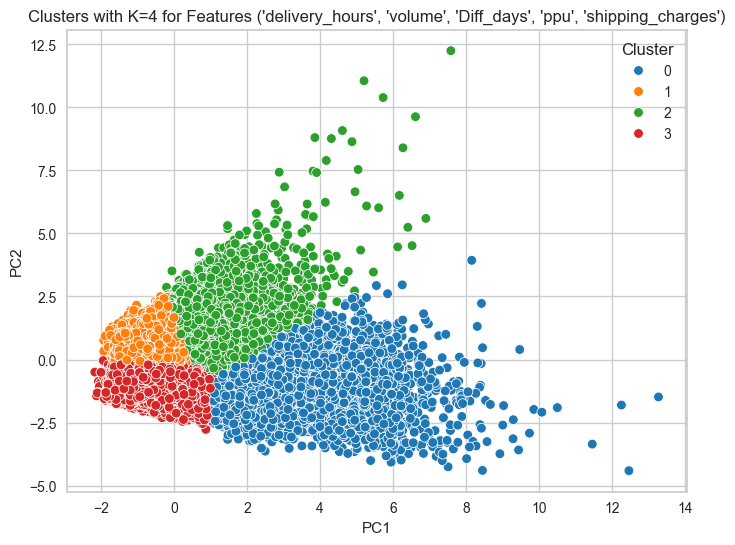

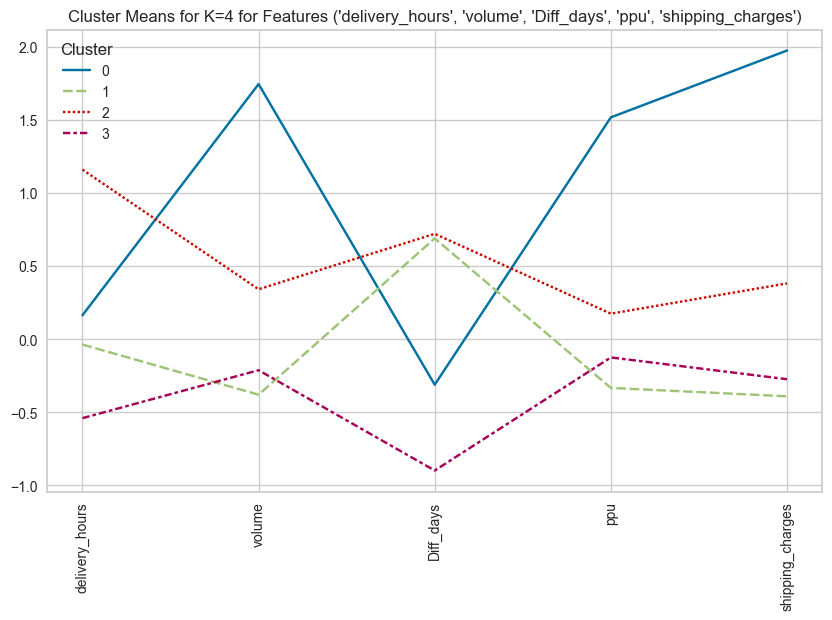

Cluster Percentages for K=4 for Features ('delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0     8.885250
1    35.324488
2    17.645589
3    38.144673
Name: count, dtype: float64


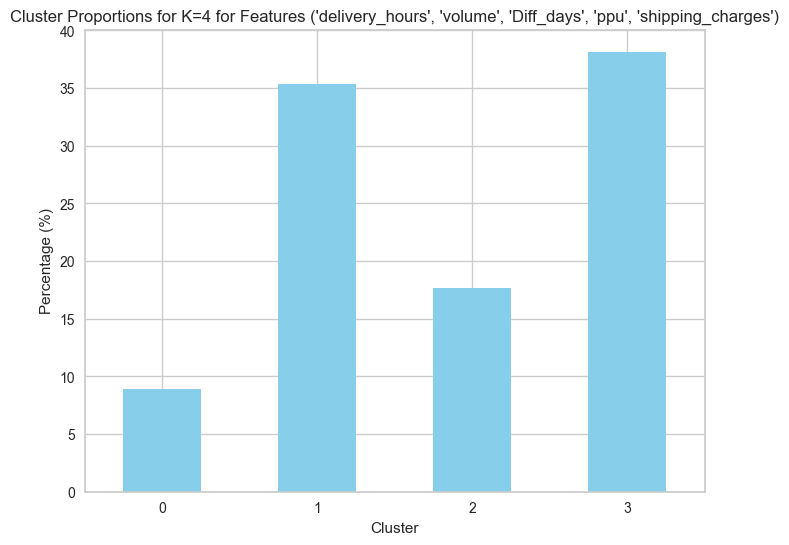

K=5에 대한 클러스터링 진행 중...


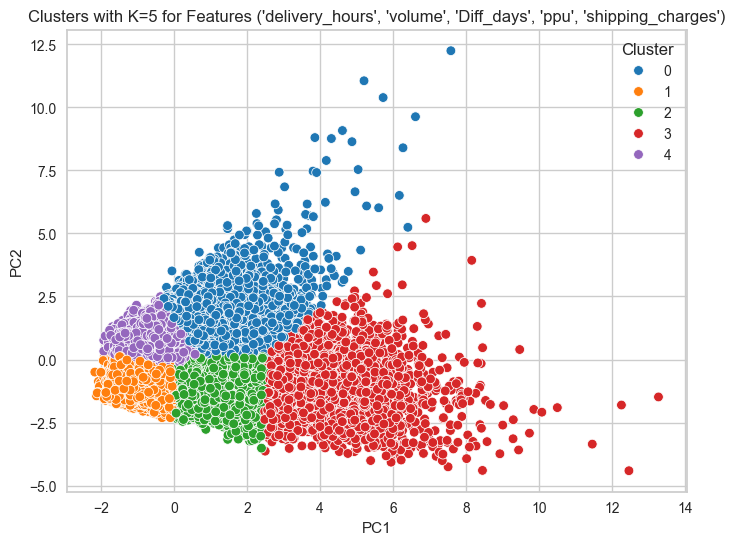

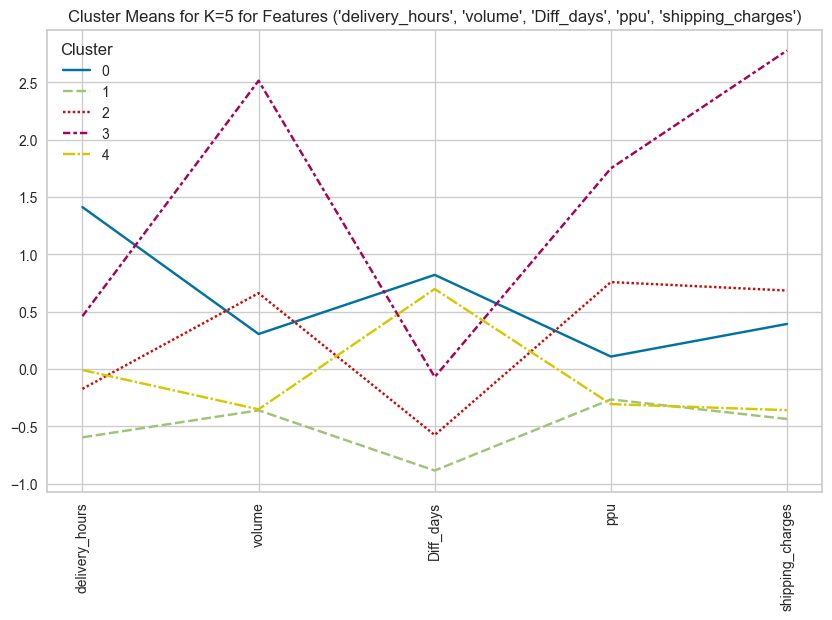

Cluster Percentages for K=5 for Features ('delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0    14.031533
1    31.944984
2    13.864986
3     4.255260
4    35.903237
Name: count, dtype: float64


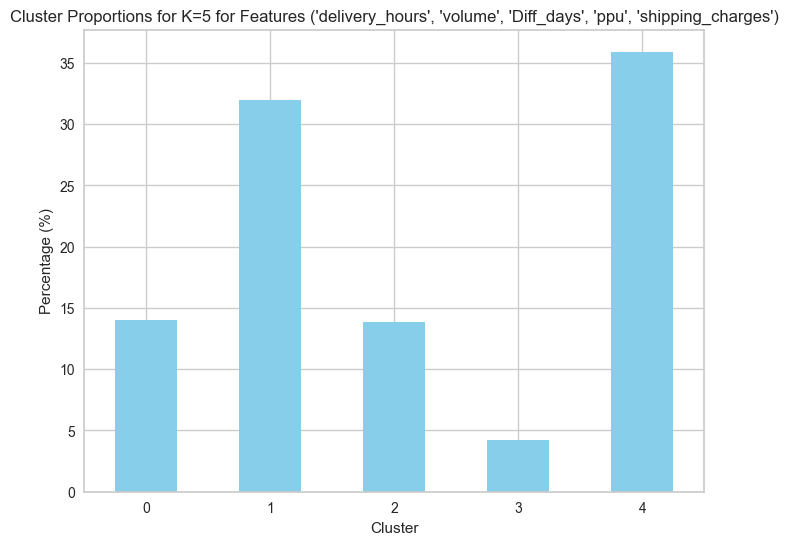

K=6에 대한 클러스터링 진행 중...


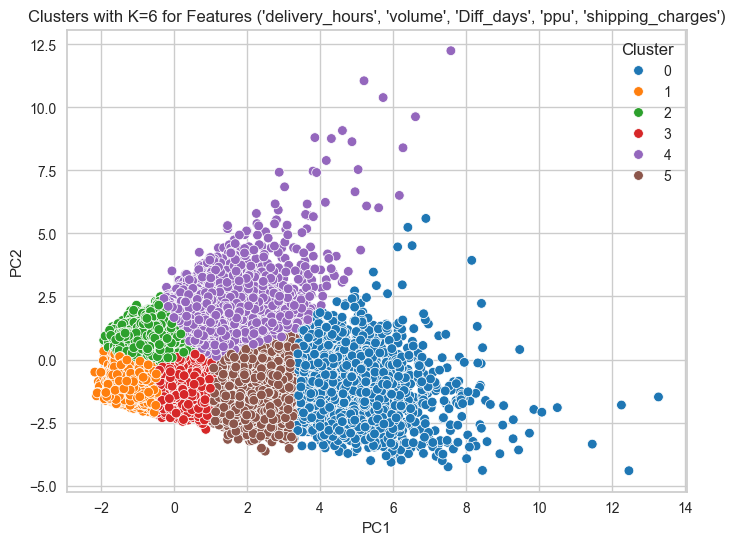

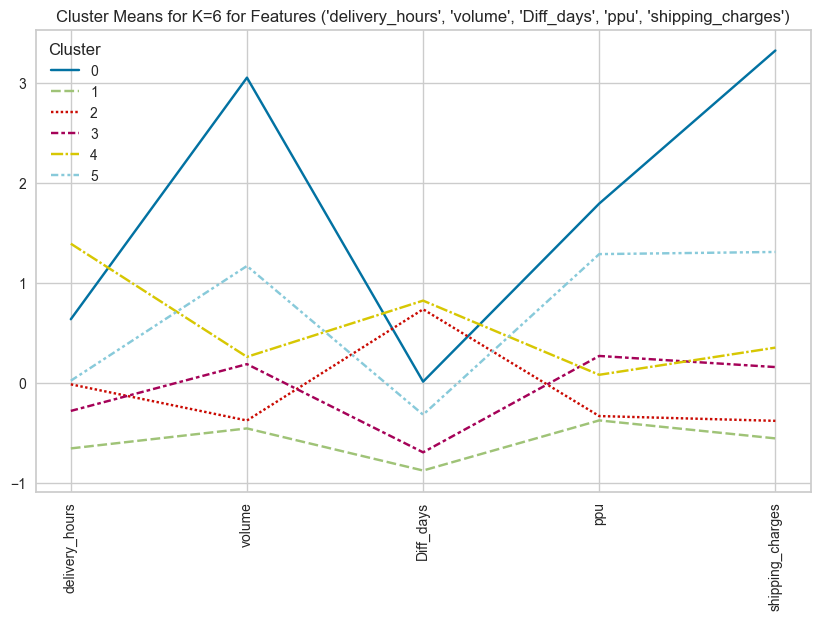

Cluster Percentages for K=6 for Features ('delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'):
Cluster
0     2.575917
1    25.090213
2    33.266252
3    16.954422
4    14.264698
5     7.848498
Name: count, dtype: float64


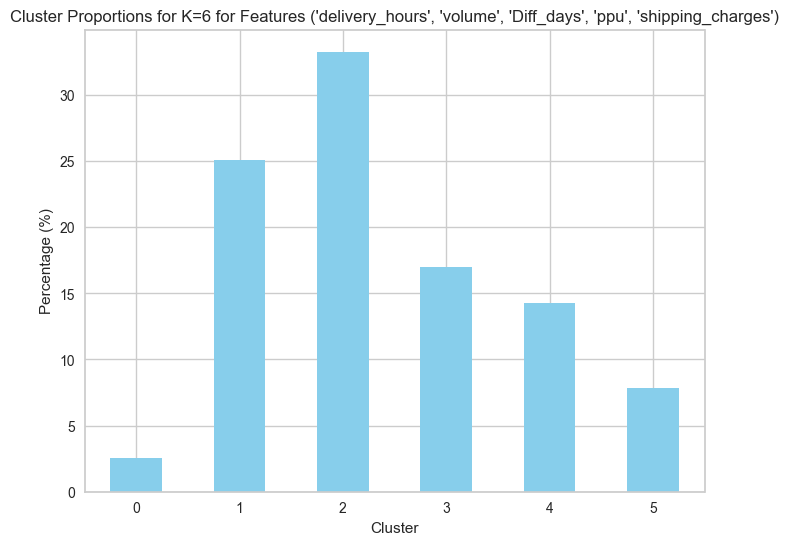

In [60]:

# 사용 예시
results = perform_kmeans_clustering(
    data=merged_df,
    feature_names=['delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'],
    random_state=42
)


In [ ]:
from sklearn.metrics import silhouette_score

def evaluate_silhouette_scores(results, data, feature_names):
    silhouette_results = {}
    
    # results 딕셔너리를 탐색
    for feature_combination, clusters in results.items():
        print(f"Evaluating Silhouette Scores for Features: {feature_combination}")
        silhouette_results[feature_combination] = {}
        
        for k, result in clusters.items():
            # 클러스터링 레이블
            labels = result['labels']
            
            # 클러스터링에 사용된 데이터 재구성 (스케일링된 데이터)
            scaler = StandardScaler()
            scaled_data = scaler.fit_transform(data[list(feature_combination)])
            
            # 실루엣 점수 계산
            score = silhouette_score(scaled_data, labels)
            silhouette_results[feature_combination][k] = score
            
            print(f"Features: {feature_combination}, K={k}, Silhouette Score: {score:.3f}")
    
    return silhouette_results

# 클러스터링 수행 후 실루엣 점수 계산
silhouette_scores = evaluate_silhouette_scores(results, merged_df, feature_names=['delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'])


Evaluating Silhouette Scores for Features: ('delivery_hours', 'volume', 'Diff_days')
Features: ('delivery_hours', 'volume', 'Diff_days'), K=4, Silhouette Score: 0.294
Features: ('delivery_hours', 'volume', 'Diff_days'), K=5, Silhouette Score: 0.290
Features: ('delivery_hours', 'volume', 'Diff_days'), K=6, Silhouette Score: 0.280
Evaluating Silhouette Scores for Features: ('delivery_hours', 'volume', 'ppu')
Features: ('delivery_hours', 'volume', 'ppu'), K=4, Silhouette Score: 0.335
Features: ('delivery_hours', 'volume', 'ppu'), K=5, Silhouette Score: 0.309
Features: ('delivery_hours', 'volume', 'ppu'), K=6, Silhouette Score: 0.277
Evaluating Silhouette Scores for Features: ('delivery_hours', 'volume', 'shipping_charges')
Features: ('delivery_hours', 'volume', 'shipping_charges'), K=4, Silhouette Score: 0.403
Features: ('delivery_hours', 'volume', 'shipping_charges'), K=5, Silhouette Score: 0.312
Features: ('delivery_hours', 'volume', 'shipping_charges'), K=6, Silhouette Score: 0.312
Eva

In [66]:
from sklearn.metrics import silhouette_samples
import matplotlib.cm as cm

def plot_silhouette_per_combination(silhouette_scores, data, feature_names, random_state=42):
    # feature_names의 모든 조합 (최소 3개 이상의 feature)
    feature_combinations = []
    for r in range(3, len(feature_names) + 1):  # 최소 3개의 feature부터 모든 조합
        feature_combinations.extend(itertools.combinations(feature_names, r))

    k_range = [4, 5, 6]  # K 값 고정

    for features in feature_combinations:
        print(f"실루엣 플롯 생성 중: Features {features}")
        
        # 데이터를 해당 feature로 스케일링
        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(data[list(features)])
        
        for k in k_range:
            print(f"K={k}에 대해 실루엣 플롯 생성 중...")
            
            # KMeans 클러스터링
            kmeans = KMeans(n_clusters=k, random_state=random_state, init='random')
            labels = kmeans.fit_predict(scaled_data)
            
            # 실루엣 샘플 계산
            silhouette_vals = silhouette_samples(scaled_data, labels)
            silhouette_avg = silhouette_vals.mean()

            # 실루엣 플롯 생성
            fig, ax = plt.subplots(figsize=(8, 6))
            y_lower = 10  # 초기 y값
            for i in range(k):
                ith_cluster_silhouette_vals = silhouette_vals[labels == i]
                ith_cluster_silhouette_vals.sort()
                size_cluster_i = ith_cluster_silhouette_vals.shape[0]
                y_upper = y_lower + size_cluster_i

                # 군집별 색상 매핑
                color = cm.nipy_spectral(float(i) / k)
                ax.fill_betweenx(np.arange(y_lower, y_upper),
                                 0, ith_cluster_silhouette_vals,
                                 facecolor=color, edgecolor=color, alpha=0.7)
                ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
                y_lower = y_upper + 10  # 다음 군집 시작점

            # 그래프 설정
            ax.set_title(f"Silhouette Plot for K={k}, Features {features}")
            ax.set_xlabel("Silhouette Coefficient Values")
            ax.set_ylabel("Cluster Label")
            ax.axvline(x=silhouette_avg, color="red", linestyle="--")
            ax.set_yticks([])  # y축 제거
            ax.set_xlim([-0.1, 1])
            plt.show()


In [67]:
plot_silhouette_per_combination(
    silhouette_scores=silhouette_scores,
    data=merged_df,
    feature_names=['delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'],
    random_state=42
)


NameError: name 'silhouette_scores' is not defined

In [57]:
final_result.T

,0,1,2,3,4,5,6,7,8,9,...,62726,62727,62728,62729,62730,62731,62732,62733,62734,62735
Diff_days,0.961538,0.623626,0.057692,0.719780,0.445055,0.159341,0.431319,0.087912,0.096154,0.538462,...,0.956044,0.153846,0.453297,0.763736,0.695055,0.414835,0.837912,0.195055,0.848901,0.219780
volume,0.072914,0.303568,0.048435,0.054946,0.121349,0.036001,0.376112,0.057463,0.430363,0.426023,...,0.038887,0.014062,0.169958,0.211189,0.289310,0.045180,0.049824,0.107461,0.204158,0.033462
delivery_hours,0.221918,0.232877,0.173973,0.249315,0.300000,0.042466,0.105479,0.328767,0.180822,0.387671,...,0.179452,0.060274,0.658904,0.127397,0.664384,0.532877,0.665753,0.509589,0.130137,0.136986
ppu,0.312011,0.669047,0.192376,0.213057,0.545670,0.304055,0.326501,0.276207,0.325368,0.288089,...,0.671786,0.217430,0.539242,0.397529,0.681561,0.180889,0.246674,0.454830,0.410385,0.271439


<Axes: >

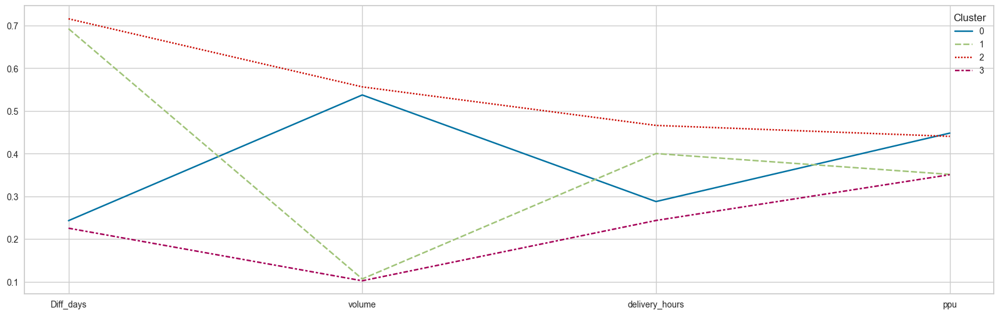

In [278]:
# 수치형 컬럼만 클러스터별로 groupby mean
numeric_result = final_result
numeric_result.loc[:,'Cluster'] = labels
numeric_result_mean =numeric_result.groupby(['Cluster']).mean(numeric_only=True)

plt.figure(figsize=(20,6))
sns.lineplot(numeric_result_mean.T)

In [279]:
## 범주형 컬럼만 클러스터별로 groupby mean
#newmeric = list(set(feature_names) - set(columns_to_encode))
#categorical_result = final_result.drop(columns=newmeric)
#categorical_result['Cluster'] = labels
#categorical_result_mean =categorical_result.groupby(['Cluster']).mean(numeric_only=True)
#plt.figure(figsize=(20,6))
#plt.xticks(rotation=90)
#sns.lineplot(categorical_result_mean.T)

In [280]:
final_result.T

,0,1,2,3,4,5,6,7,8,9,...,62726,62727,62728,62729,62730,62731,62732,62733,62734,62735
Diff_days,0.961538,0.623626,0.057692,0.719780,0.445055,0.159341,0.431319,0.087912,0.096154,0.538462,...,0.956044,0.153846,0.453297,0.763736,0.695055,0.414835,0.837912,0.195055,0.848901,0.219780
volume,0.072914,0.303568,0.048435,0.054946,0.121349,0.036001,0.376112,0.057463,0.430363,0.426023,...,0.038887,0.014062,0.169958,0.211189,0.289310,0.045180,0.049824,0.107461,0.204158,0.033462
delivery_hours,0.221918,0.232877,0.173973,0.249315,0.300000,0.042466,0.105479,0.328767,0.180822,0.387671,...,0.179452,0.060274,0.658904,0.127397,0.664384,0.532877,0.665753,0.509589,0.130137,0.136986
ppu,0.312011,0.669047,0.192376,0.213057,0.545670,0.304055,0.326501,0.276207,0.325368,0.288089,...,0.671786,0.217430,0.539242,0.397529,0.681561,0.180889,0.246674,0.454830,0.410385,0.271439
Cluster,1.000000,2.000000,3.000000,1.000000,3.000000,3.000000,0.000000,3.000000,0.000000,2.000000,...,1.000000,3.000000,1.000000,1.000000,2.000000,1.000000,1.000000,3.000000,1.000000,3.000000


In [281]:
# reset_index 안 해서 살아있음
df_droped

,Diff_days,volume,delivery_hours,ppu
0,1.767165,-0.545418,-0.526228,-0.395487
1,0.536938,0.087835,-0.490708,0.847477
2,-1.523444,-0.612621,-0.681627,-0.811979
3,0.887002,-0.594748,-0.437429,-0.739980
5,-0.113183,-0.412440,-0.273150,0.417961
...,...,...,...,...
71987,-0.223203,-0.621558,0.481646,-0.851968
71988,1.317082,-0.608808,0.912323,-0.622948
71989,-1.023351,-0.450570,0.406166,0.101717
71992,1.357089,-0.185091,-0.823706,-0.053011


In [282]:
df_droped.loc[:,'Cluster'] = kmeans.labels_  # 클러스터링 결과를 df_droped에 추가

# 원본 데이터 크기에 맞춰 재구성
merged_result['Cluster'] = None  # 원본 데이터에 Cluster 컬럼 추가
merged_result.loc[df_droped.index, 'Cluster'] = df_droped['Cluster']  # 인덱스 기준으로 클러스터링 결과 매핑
merged_result = merged_result[merged_result['Cluster'].notnull()].reset_index(drop=True)
merged_result

,Diff_days,volume,delivery_hours,ppu,Cluster
0,351,3528.0,182.0,45.61,1
1,228,14157.0,190.0,181.13,2
2,22,2400.0,147.0,0.20,3
3,263,2700.0,202.0,8.05,1
4,163,5760.0,239.0,134.30,3
...,...,...,...,...,...
62731,152,2250.0,409.0,-4.16,1
62732,306,2464.0,506.0,20.81,1
62733,72,5120.0,392.0,99.82,3
62734,310,9576.0,115.0,82.95,1


## RFM Visualization

# Version 1

In [283]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
def perform_kmeans_clustering(data, k_range, feature_names, random_state=42):
    """
    KMeans 클러스터링을 k값의 범위에 대해 반복 수행하고 결과를 시각화.
    Parameters:
        data (pd.DataFrame): 클러스터링에 사용할 데이터셋.
        k_range (range): 클러스터 개수의 범위 (예: range(3, 7)).
        feature_names (list): 클러스터링에 사용할 컬럼 목록.
        random_state (int): KMeans의 랜덤 시드.
    Returns:
        results (dict): 각 k값에 대한 결과 저장.
    """
    # 스케일링
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[feature_names])
    # PCA 변환
    pca = PCA(n_components=2)
    pca_data = pca.fit_transform(scaled_data)
    pca_df = pd.DataFrame(pca_data, columns=['PC1', 'PC2'])
    results = {}
    for k in k_range:
        print(f"K={k}에 대한 클러스터링 진행 중...")
        # KMeans 클러스터링
        kmeans = KMeans(n_clusters=k, random_state=random_state, init='random')
        labels = kmeans.fit_predict(pca_df)
        # 결과 저장
        results[k] = {
            'kmeans_model': kmeans,
            'labels': labels,
            'cluster_centers': kmeans.cluster_centers_
        }
        # 클러스터링 결과 시각화
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue=labels, palette='tab10')
        plt.title(f'Clusters with K={k}')
        plt.legend(title='Cluster')
        plt.show()
        # 클러스터 별 평균 계산
        clustered_data = pd.DataFrame(scaled_data, columns=feature_names)
        clustered_data['Cluster'] = labels
        cluster_means = clustered_data.groupby('Cluster').mean()
        # 평균 값 시각화
        plt.figure(figsize=(10, 6))
        sns.lineplot(data=cluster_means.T)
        plt.title(f'Cluster Means for K={k}')
        plt.xticks(rotation=90)
        plt.show()
    return results

K=3에 대한 클러스터링 진행 중...


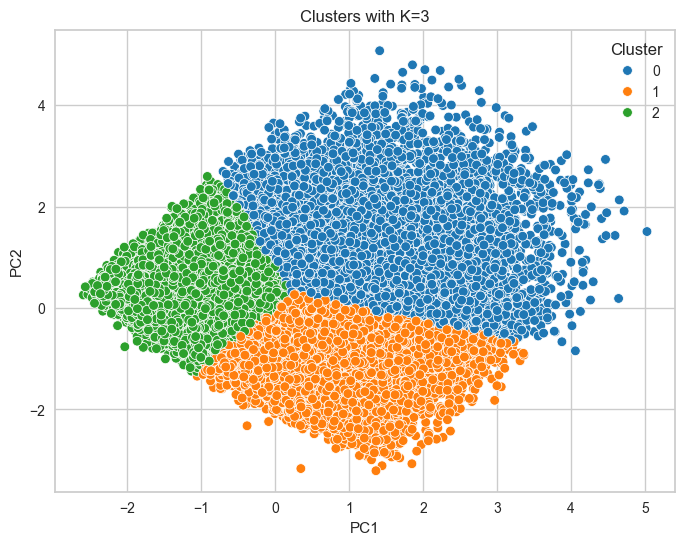

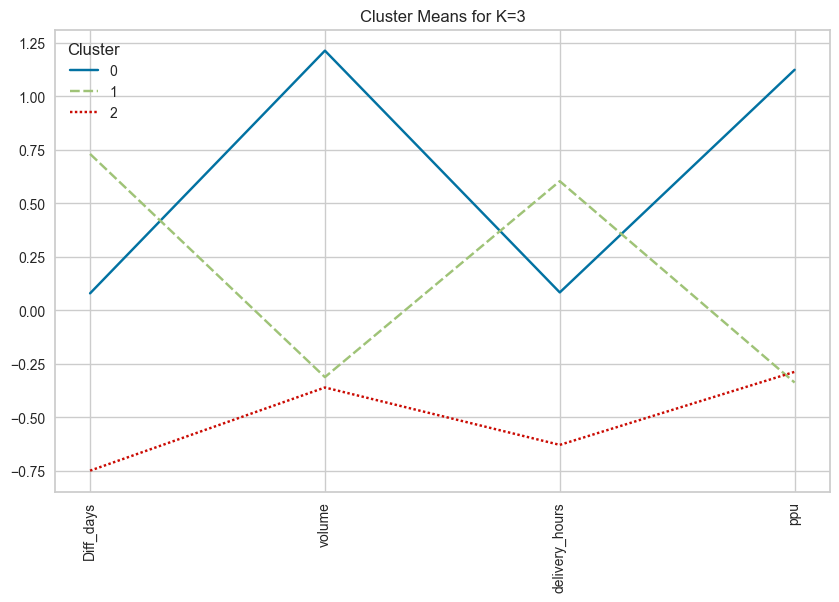

K=4에 대한 클러스터링 진행 중...


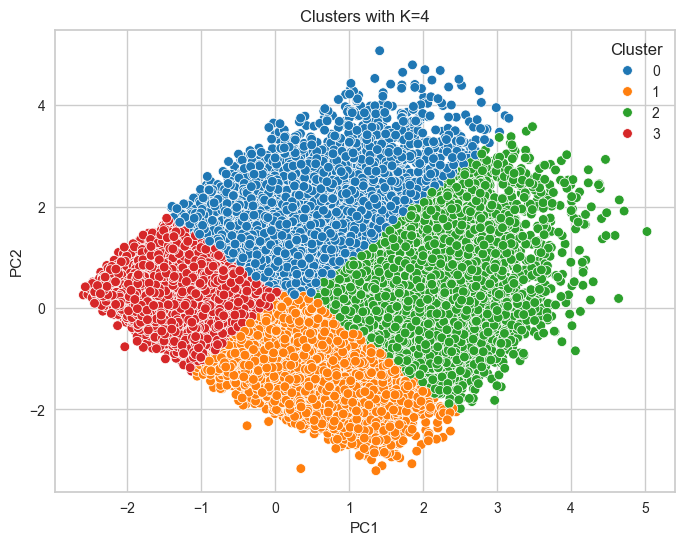

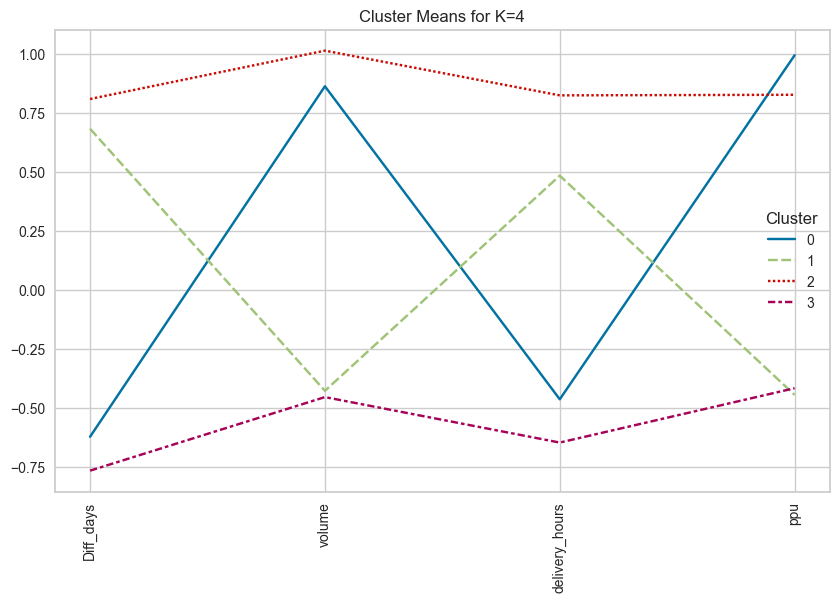

{3: {'kmeans_model': KMeans(init='random', n_clusters=3, random_state=42),
  'labels': array([1, 0, 2, ..., 2, 1, 2], dtype=int32),
  'cluster_centers': array([[ 1.13352132,  1.20493895],
         [ 0.43933693, -0.95195183],
         [-1.04507743,  0.26446303]])},
 4: {'kmeans_model': KMeans(init='random', n_clusters=4, random_state=42),
  'labels': array([1, 0, 3, ..., 3, 1, 3], dtype=int32),
  'cluster_centers': array([[ 0.22746266,  1.50638874],
         [ 0.25189375, -1.00276996],
         [ 1.72473491,  0.28376743],
         [-1.16130918,  0.15381668]])}}

In [286]:
perform_kmeans_clustering(final_result, range(3, 5), feature_names=['Diff_days', 'volume', 'delivery_hours','ppu'], random_state=42)

In [63]:
from sklearn.metrics import silhouette_samples
import matplotlib.cm as cm

def plot_silhouette_per_combination(silhouette_scores, data, feature_names, random_state=42):
    # feature_names의 모든 조합 (최소 3개 이상의 feature)
    feature_combinations = []
    for r in range(3, len(feature_names) + 1):  # 최소 3개의 feature부터 모든 조합
        feature_combinations.extend(itertools.combinations(feature_names, r))

    k_range = [4, 5, 6]  # K 값 고정

    for features in feature_combinations:
        print(f"실루엣 플롯 생성 중: Features {features}")
        
        # 데이터를 해당 feature로 스케일링
        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(data[list(features)])
        
        for k in k_range:
            print(f"K={k}에 대해 실루엣 플롯 생성 중...")
            
            # KMeans 클러스터링
            kmeans = KMeans(n_clusters=k, random_state=random_state, init='random')
            labels = kmeans.fit_predict(scaled_data)
            
            # 실루엣 샘플 계산
            silhouette_vals = silhouette_samples(scaled_data, labels)
            silhouette_avg = silhouette_vals.mean()

            # 실루엣 플롯 생성
            fig, ax = plt.subplots(figsize=(8, 6))
            y_lower = 10  # 초기 y값
            for i in range(k):
                ith_cluster_silhouette_vals = silhouette_vals[labels == i]
                ith_cluster_silhouette_vals.sort()
                size_cluster_i = ith_cluster_silhouette_vals.shape[0]
                y_upper = y_lower + size_cluster_i

                # 군집별 색상 매핑
                color = cm.nipy_spectral(float(i) / k)
                ax.fill_betweenx(np.arange(y_lower, y_upper),
                                 0, ith_cluster_silhouette_vals,
                                 facecolor=color, edgecolor=color, alpha=0.7)
                ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
                y_lower = y_upper + 10  # 다음 군집 시작점

            # 그래프 설정
            ax.set_title(f"Silhouette Plot for K={k}, Features {features}")
            ax.set_xlabel("Silhouette Coefficient Values")
            ax.set_ylabel("Cluster Label")
            ax.axvline(x=silhouette_avg, color="red", linestyle="--")
            ax.set_yticks([])  # y축 제거
            ax.set_xlim([-0.1, 1])
            plt.show()

In [65]:
plot_silhouette_per_combination(
    silhouette_scores=silhouette_scores,
    data=merged_df,
    feature_names=['delivery_hours', 'volume', 'Diff_days', 'ppu', 'shipping_charges'],
    random_state=42
)

NameError: name 'silhouette_scores' is not defined

# version 2

In [287]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import itertools
def perform_kmeans_clustering(data, k_range, feature_names, random_state=42):
    """
    KMeans 클러스터링을 k값의 범위에 대해 반복 수행하고, feature_names의 가능한 모든 조합에 대해 실행.
    Parameters:
        data (pd.DataFrame): 클러스터링에 사용할 데이터셋.
        k_range (range): 클러스터 개수의 범위 (예: range(3, 7)).
        feature_names (list): 클러스터링에 사용할 컬럼 목록.
        random_state (int): KMeans의 랜덤 시드.
    Returns:
        results (dict): 각 k값과 feature 조합에 대한 결과 저장.
    """
    # 결과 저장용 딕셔너리
    results = {}
    # feature_names의 모든 조합을 생성
    feature_combinations = []
    for r in range(3, len(feature_names) + 1):  # 최소 3개의 feature부터 모든 조합
        feature_combinations.extend(itertools.combinations(feature_names, r))
    # 각 feature 조합에 대해 반복 수행
    for features in feature_combinations:
        print(f"Features: {features}에 대해 클러스터링 진행 중...")
         # MinMaxScaler 스케일링
        scaler = MinMaxScaler(feature_range=(0, 1))
        scaled_data = scaler.fit_transform(data[list(features)])
        # PCA 적용 전, feature 개수가 2개 이상일 때만 PCA 수행
        if len(features) > 1:
            # PCA 변환
            pca = PCA(n_components=2)
            pca_data = pca.fit_transform(scaled_data)
            pca_df = pd.DataFrame(pca_data, columns=['PC1', 'PC2'])
            pca_applied = True
        else:
            pca_df = pd.DataFrame(scaled_data, columns=features)
            pca_applied = False
        for k in k_range:
            print(f"K={k}에 대한 클러스터링 진행 중...")
            # KMeans 클러스터링
            kmeans = KMeans(n_clusters=k, random_state=random_state, init='random')
            labels = kmeans.fit_predict(pca_df)
            # 결과 저장
            if features not in results:
                results[features] = {}
            results[features][k] = {
                'kmeans_model': kmeans,
                'labels': labels,
                'cluster_centers': kmeans.cluster_centers_
            }
            # 클러스터링 결과 시각화
            plt.figure(figsize=(8, 6))
            if pca_applied:
                sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue=labels, palette='tab10')
            else:
                sns.scatterplot(data=pca_df, x=features[0], y=features[0], hue=labels, palette='tab10')
            plt.title(f'Clusters with K={k} for Features {features}')
            plt.legend(title='Cluster')
            plt.show()
            # 클러스터 별 평균 계산
            clustered_data = pd.DataFrame(scaled_data, columns=features)
            clustered_data['Cluster'] = labels
            cluster_means = clustered_data.groupby('Cluster').mean()
            # 평균 값 시각화
            plt.figure(figsize=(10, 6))
            sns.lineplot(data=cluster_means.T)
            plt.title(f'Cluster Means for K={k} for Features {features}')
            plt.xticks(rotation=90)
            plt.show()
    return results

Features: ('Diff_days', 'product_weight_g', 'volume')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


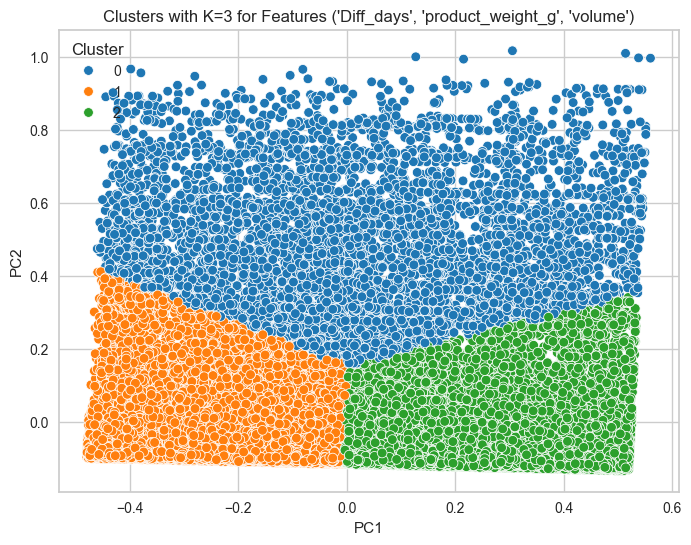

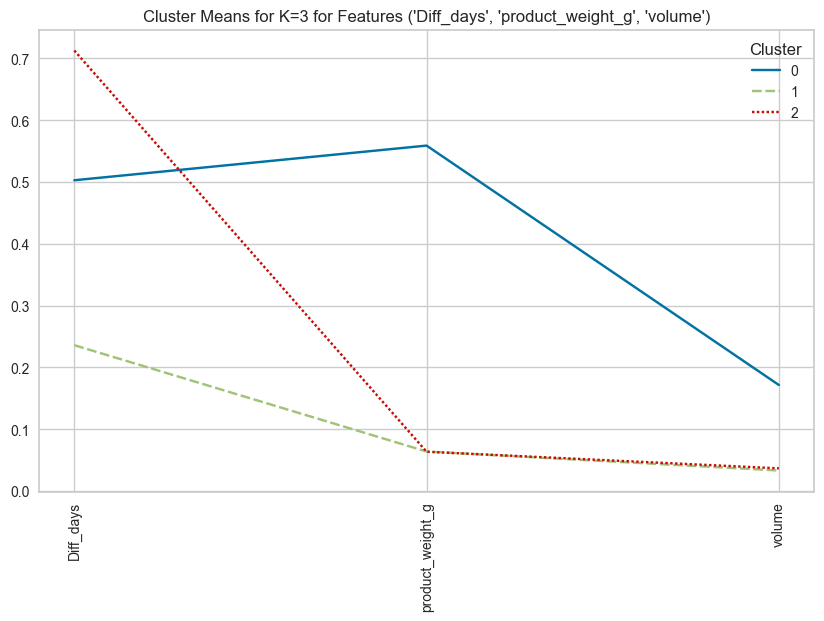

K=4에 대한 클러스터링 진행 중...


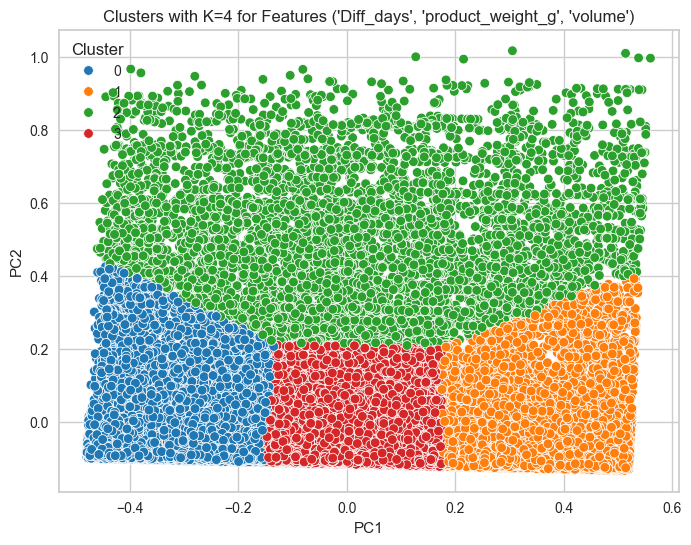

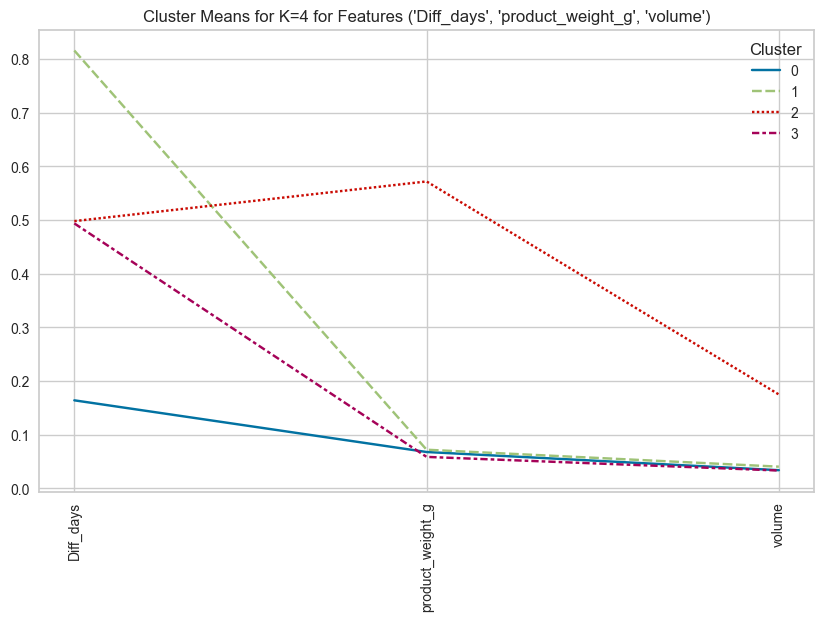

Features: ('Diff_days', 'product_weight_g', 'delivery_hours')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


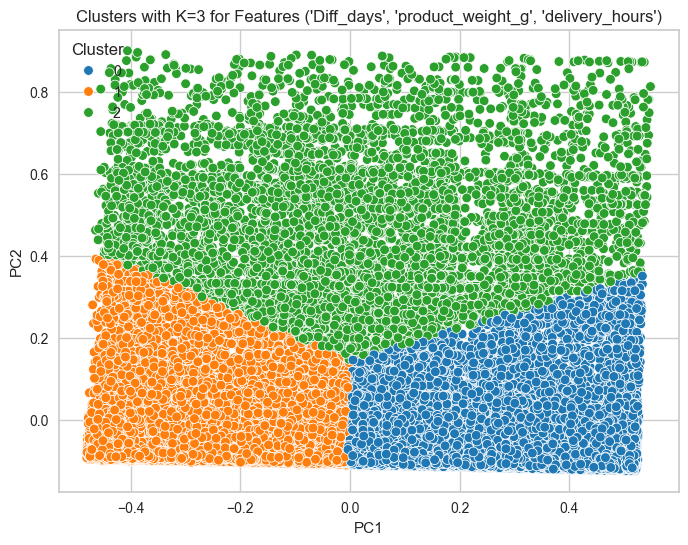

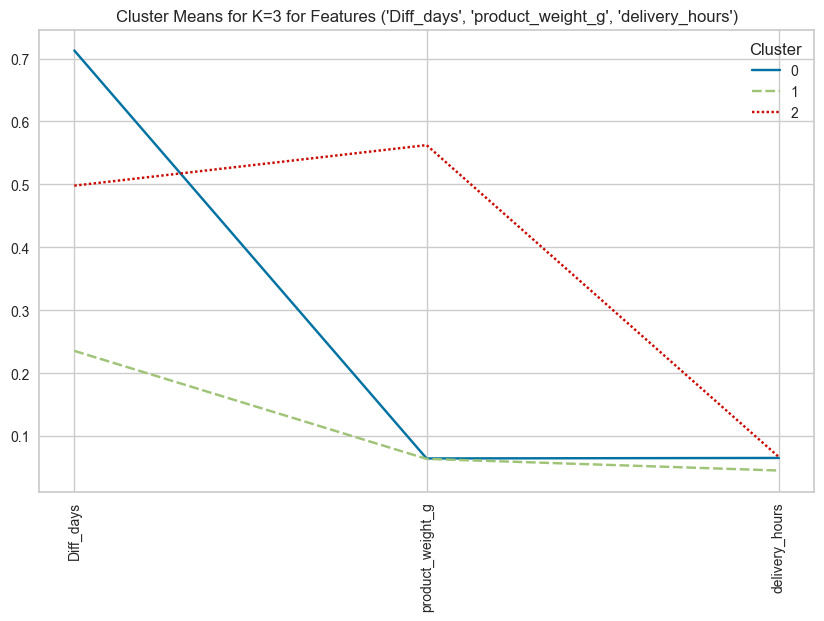

K=4에 대한 클러스터링 진행 중...


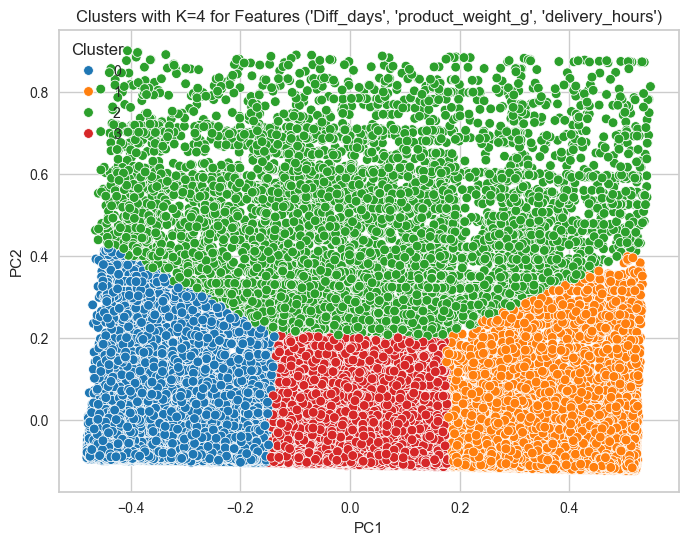

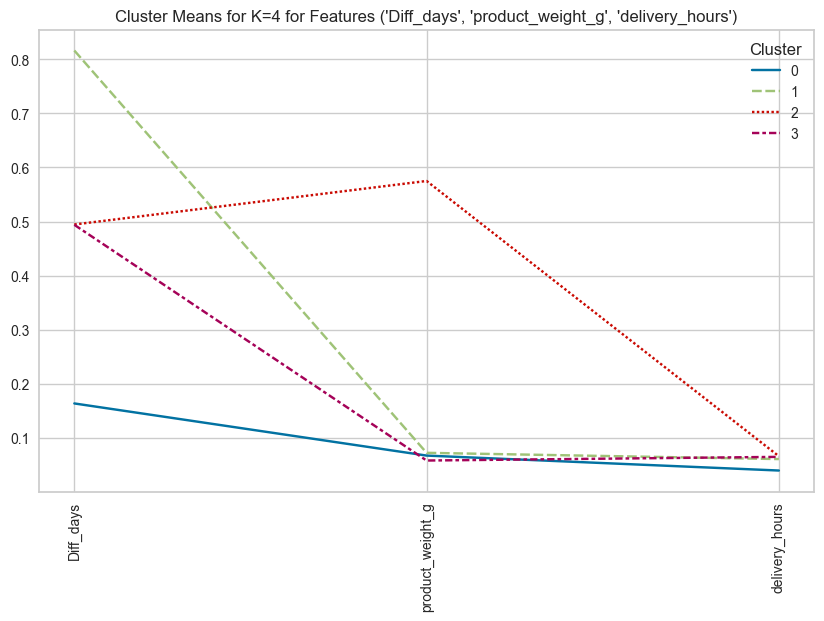

Features: ('Diff_days', 'product_weight_g', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


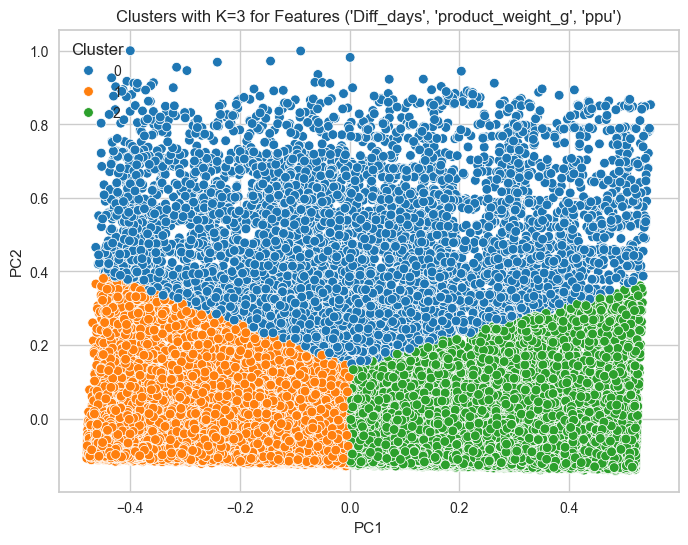

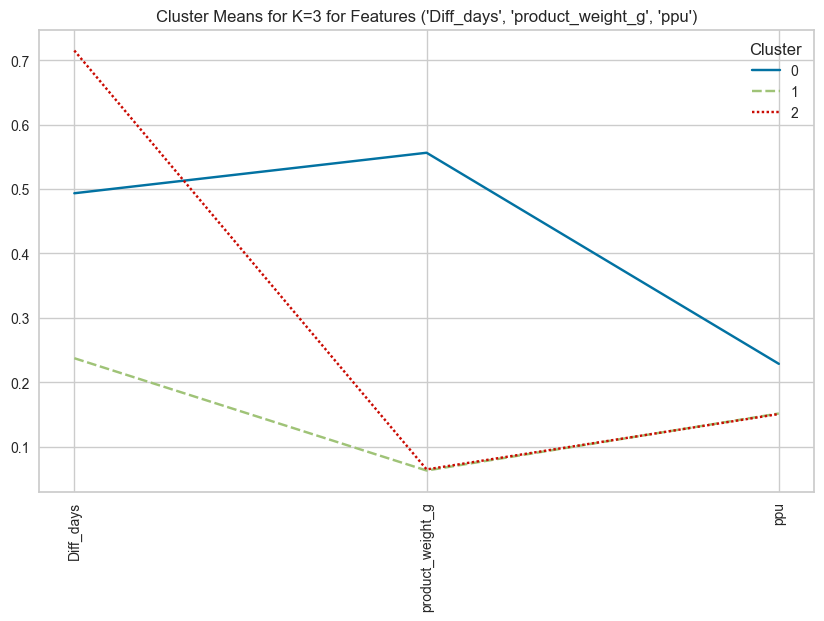

K=4에 대한 클러스터링 진행 중...


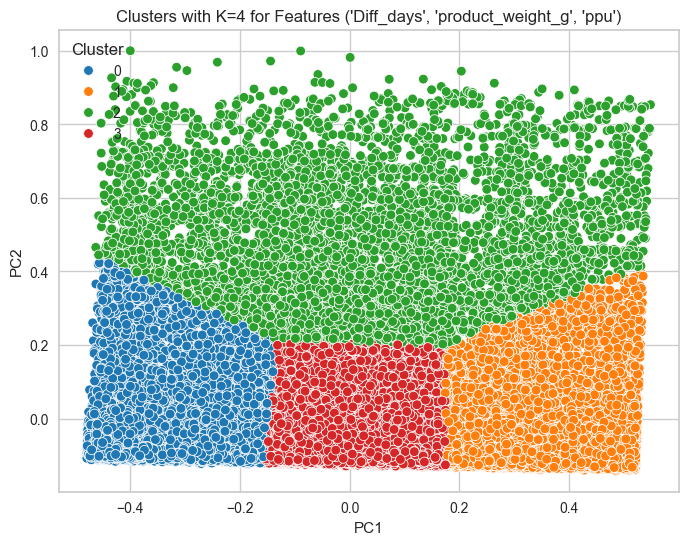

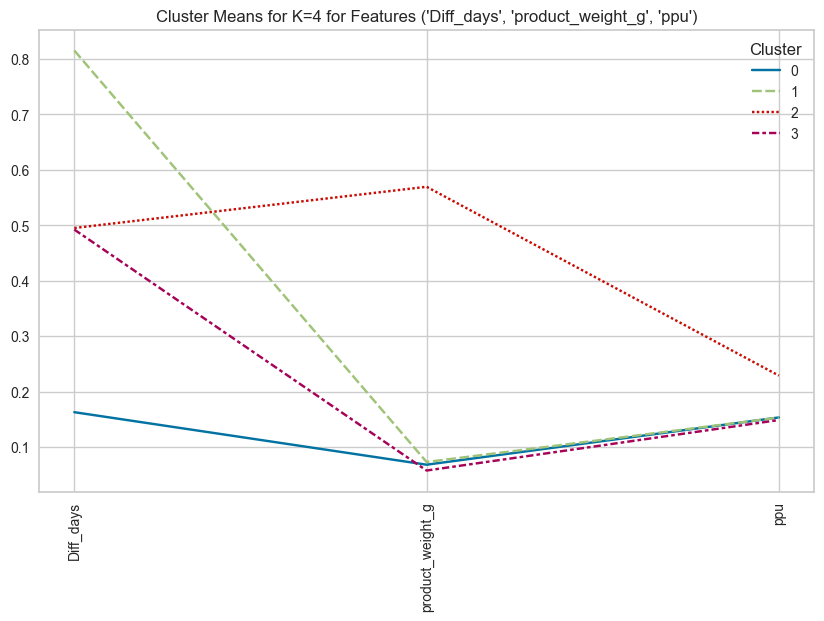

Features: ('Diff_days', 'volume', 'delivery_hours')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


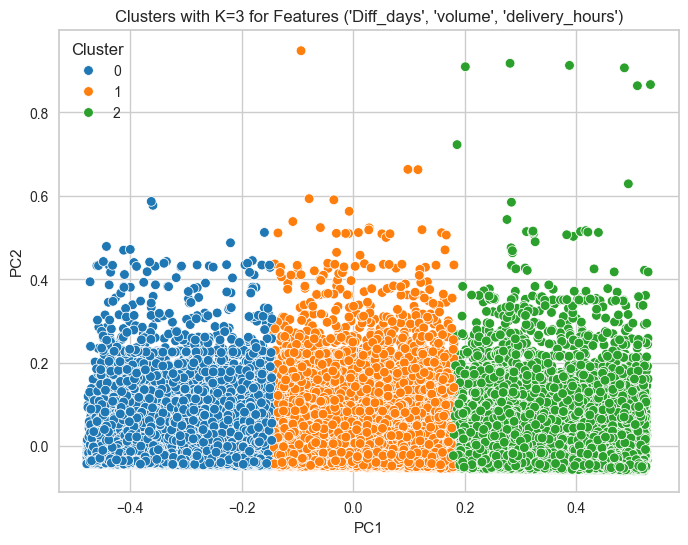

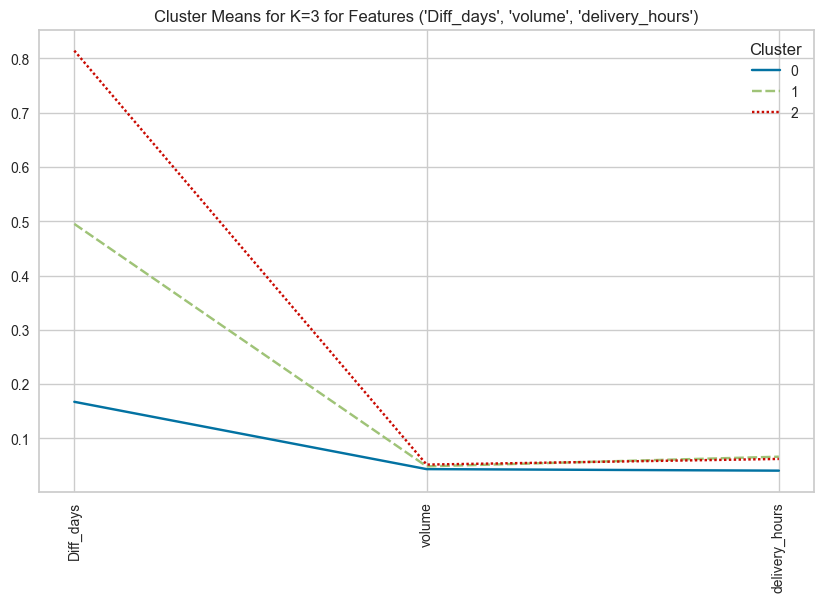

K=4에 대한 클러스터링 진행 중...


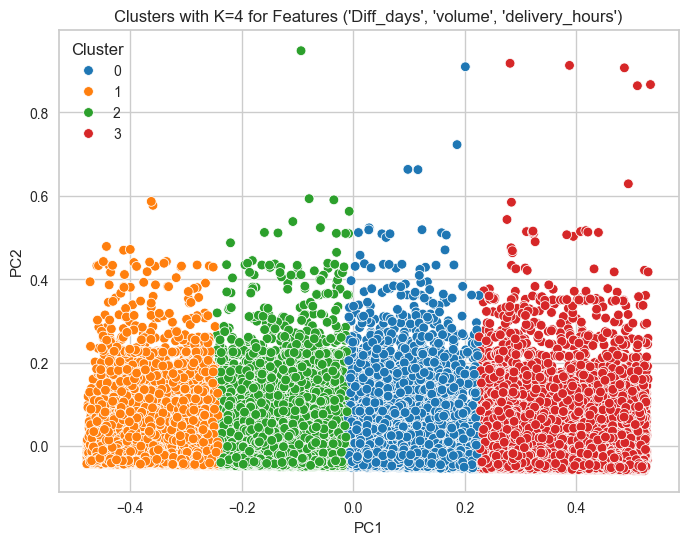

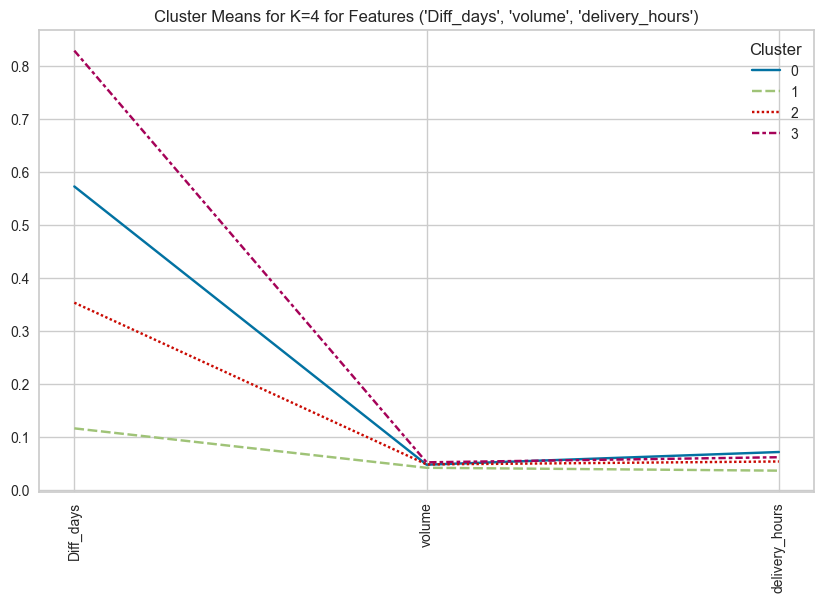

Features: ('Diff_days', 'volume', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


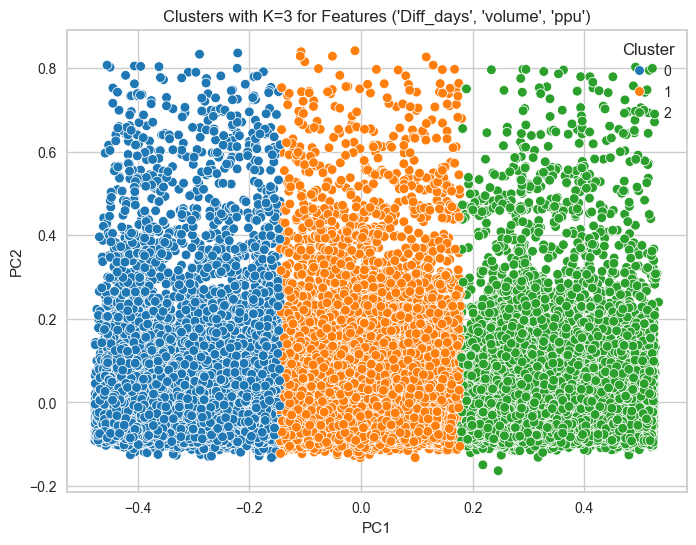

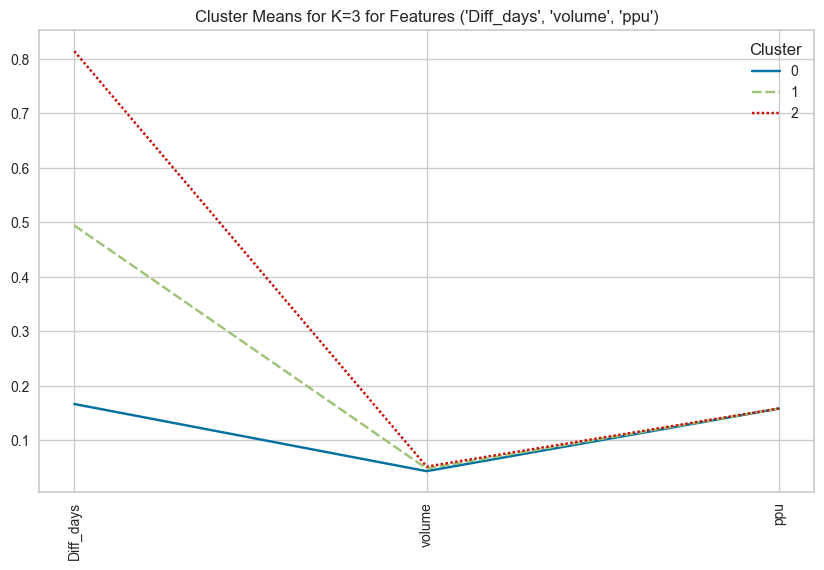

K=4에 대한 클러스터링 진행 중...


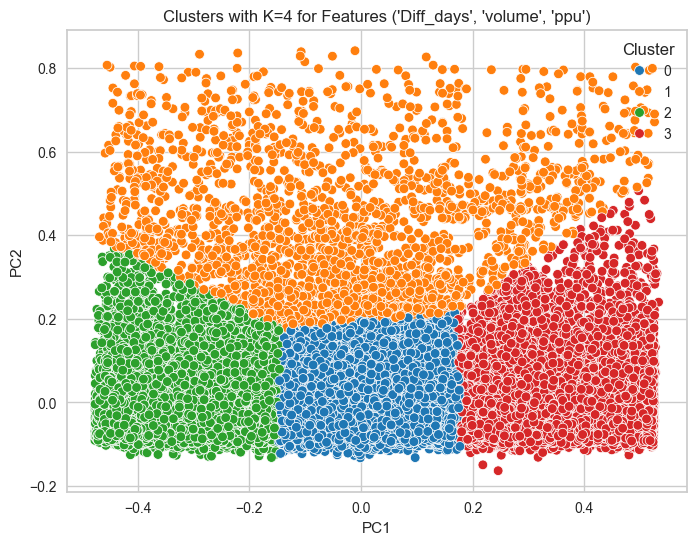

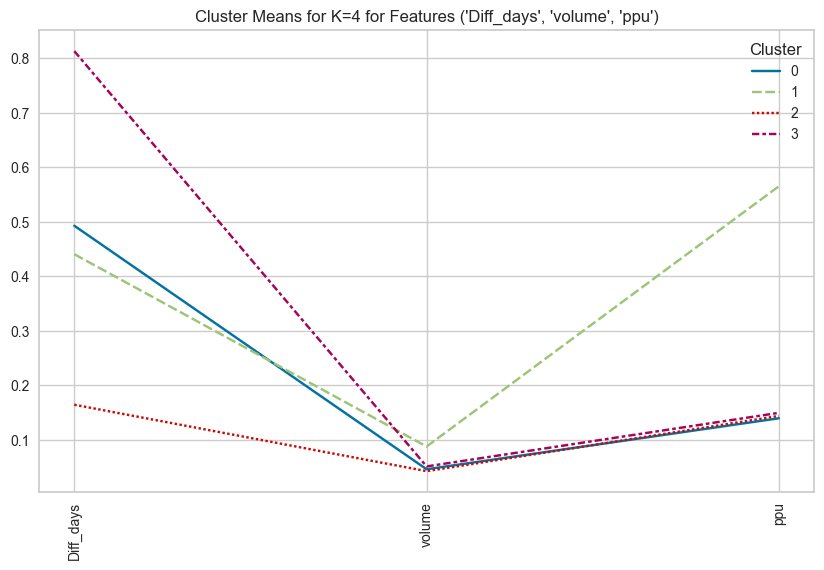

Features: ('Diff_days', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


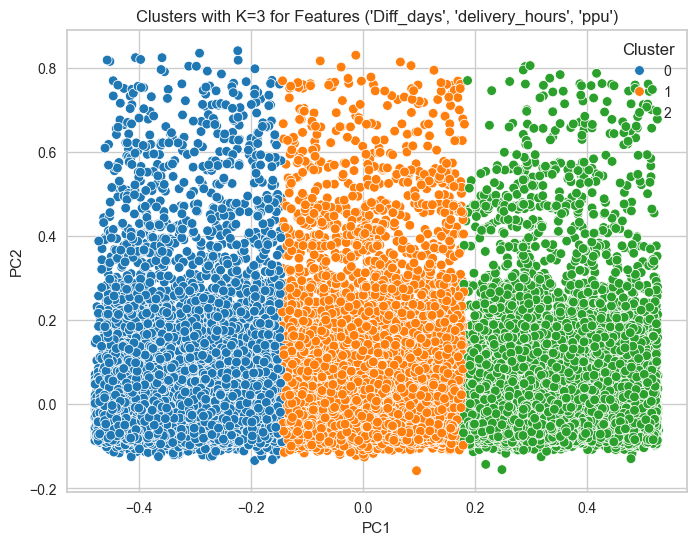

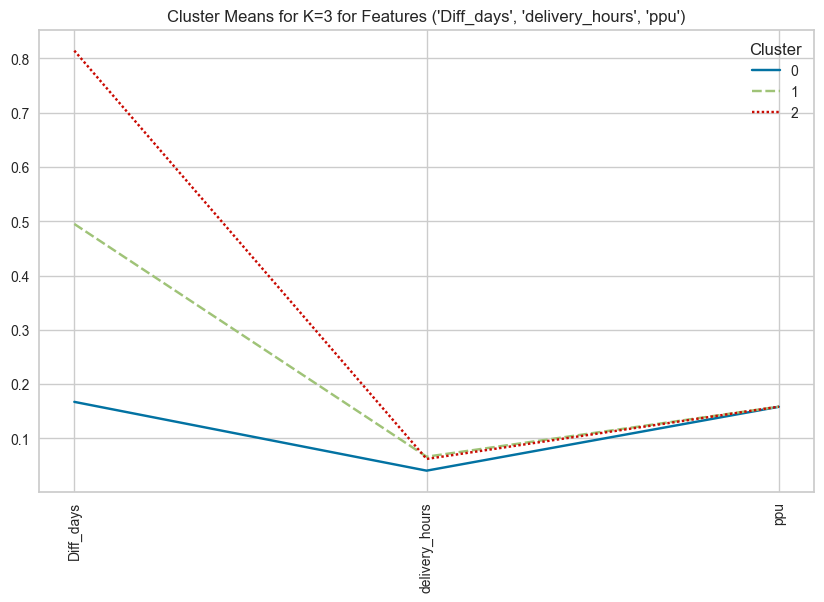

K=4에 대한 클러스터링 진행 중...


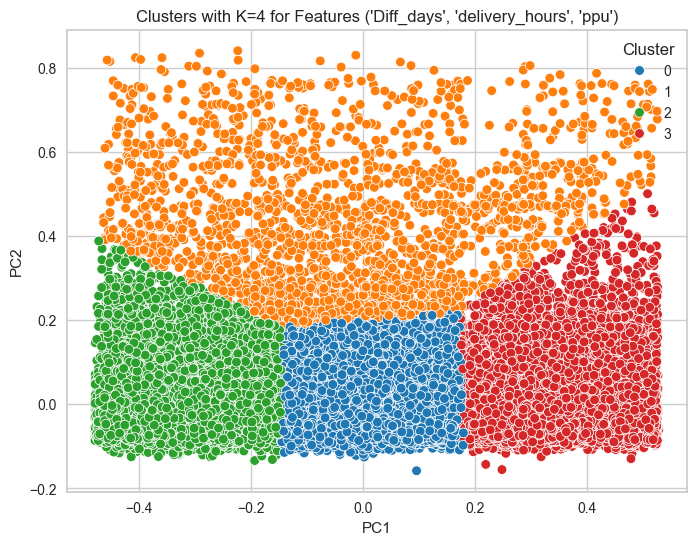

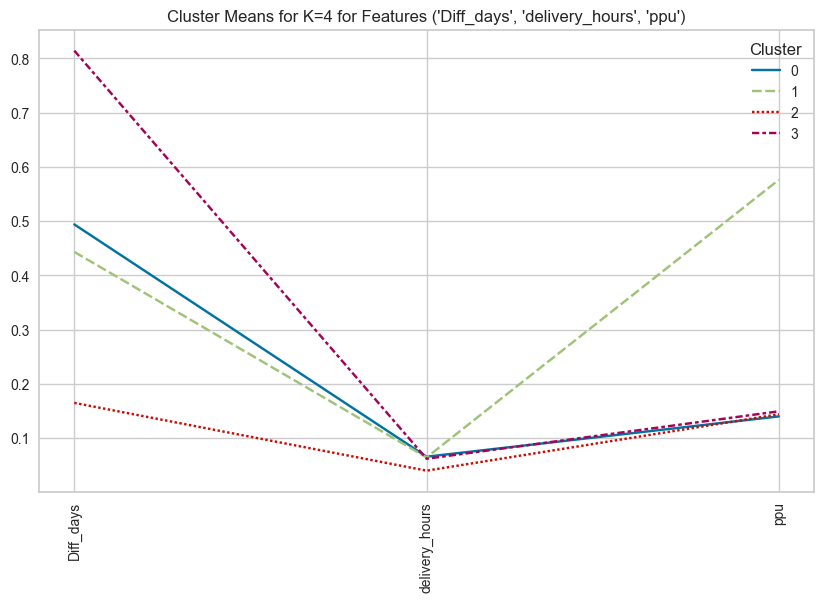

Features: ('product_weight_g', 'volume', 'delivery_hours')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


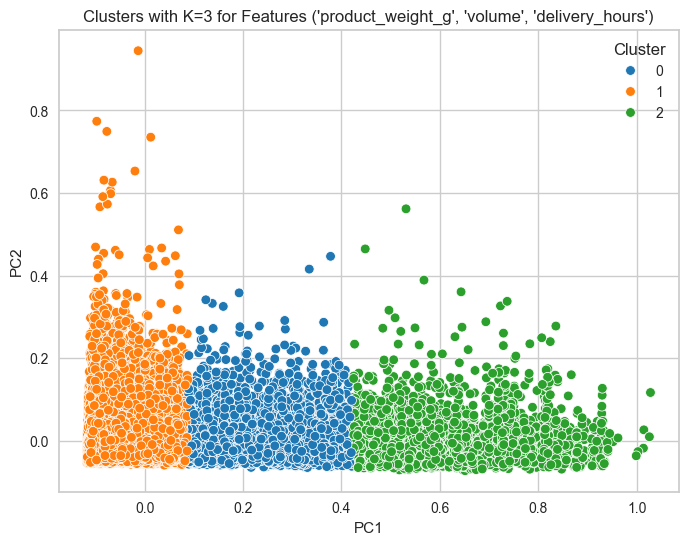

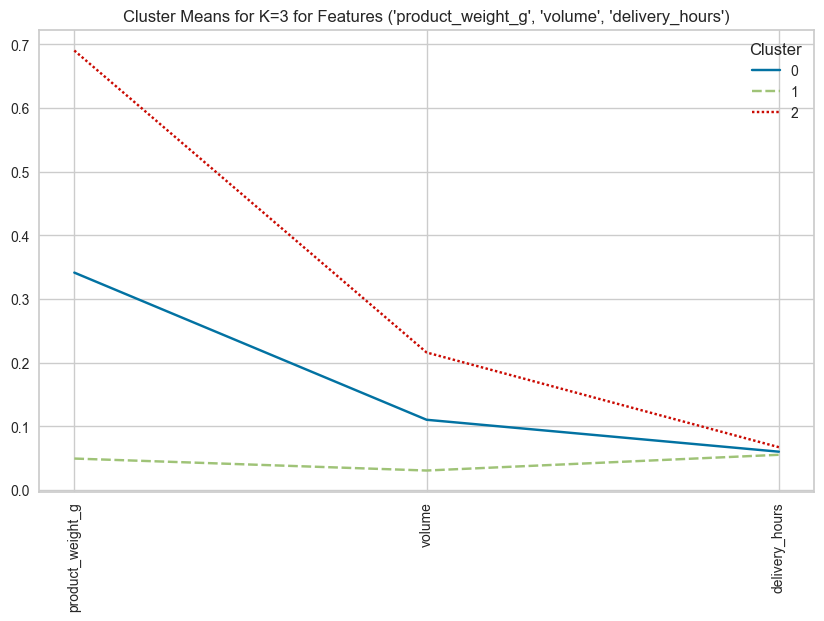

K=4에 대한 클러스터링 진행 중...


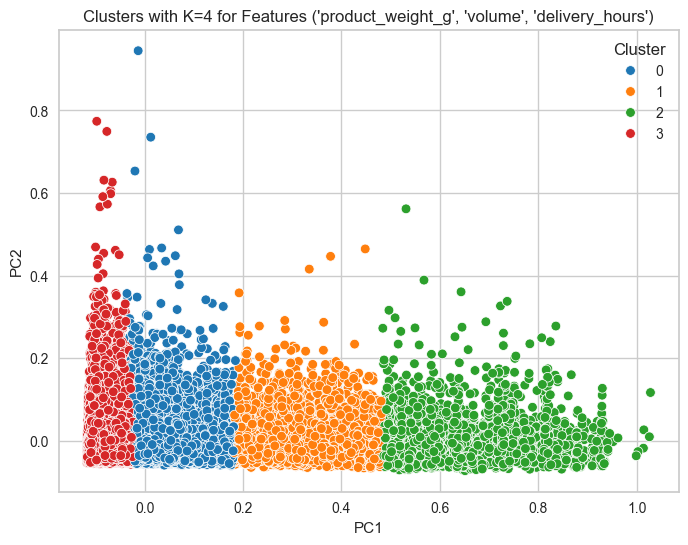

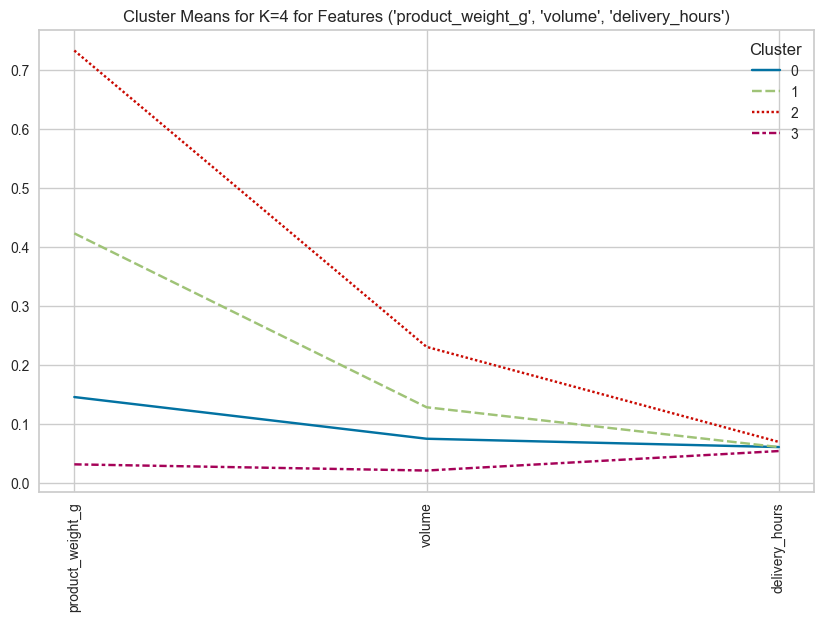

Features: ('product_weight_g', 'volume', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


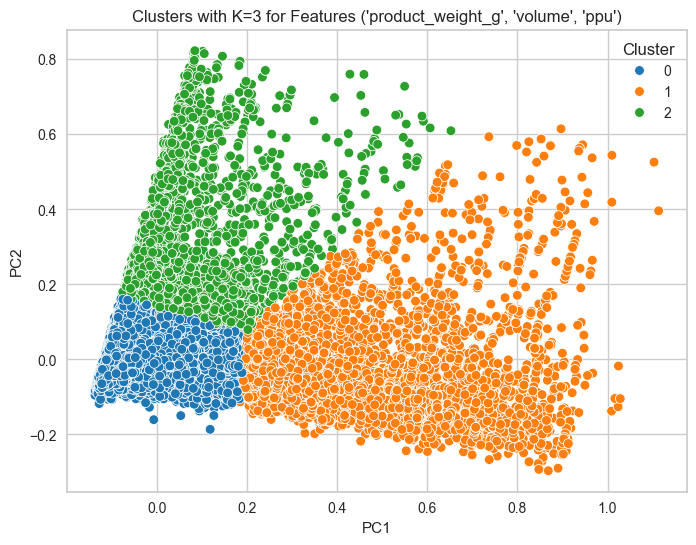

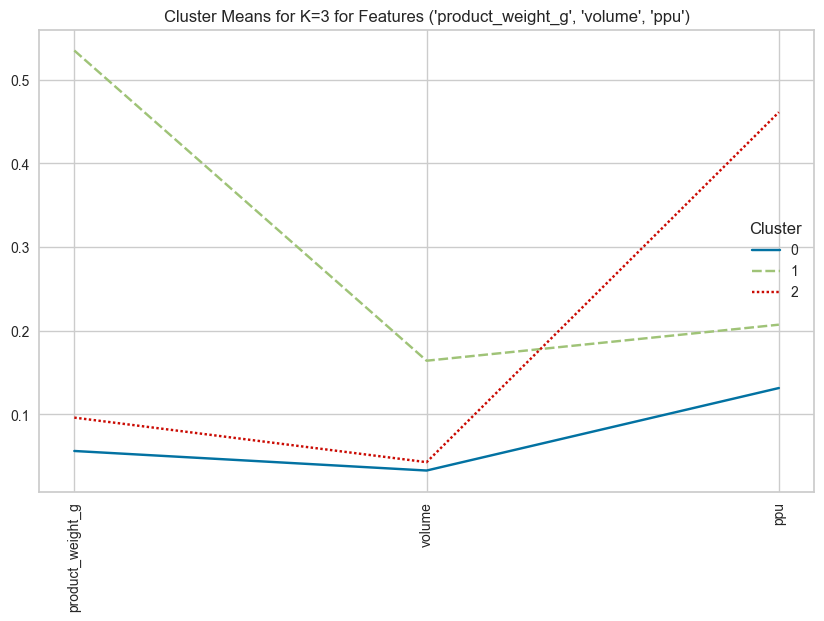

K=4에 대한 클러스터링 진행 중...


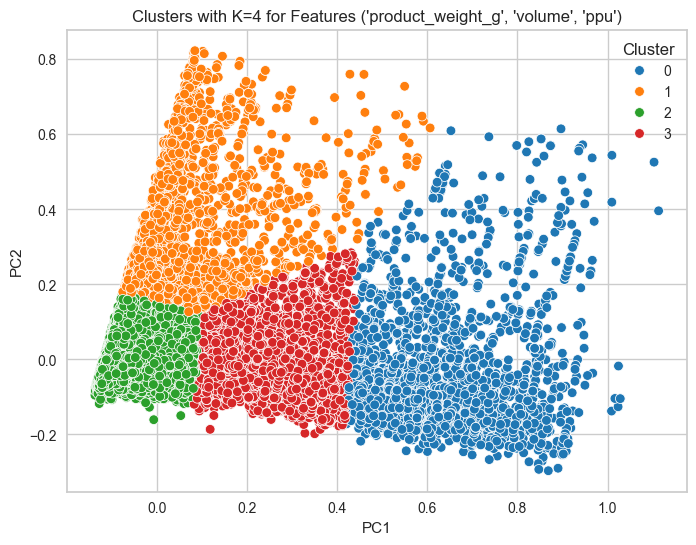

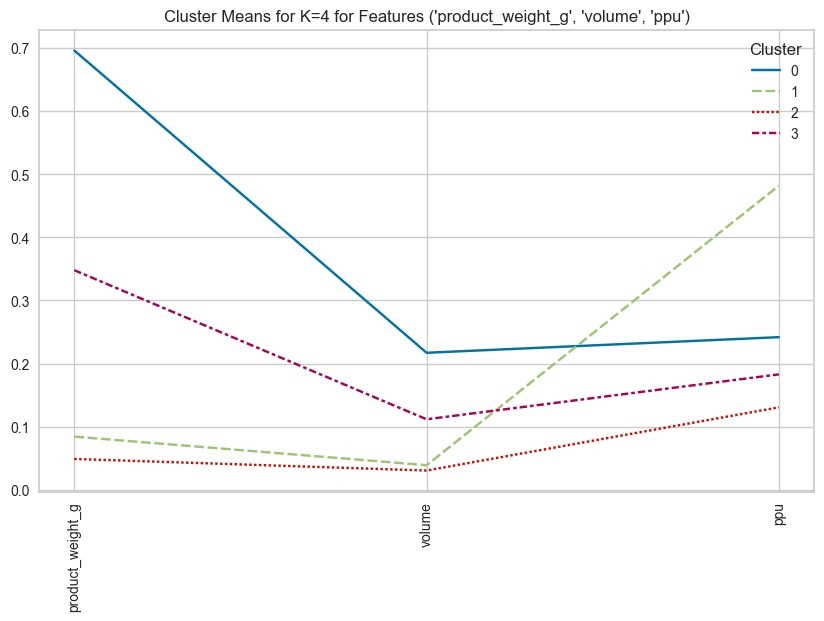

Features: ('product_weight_g', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


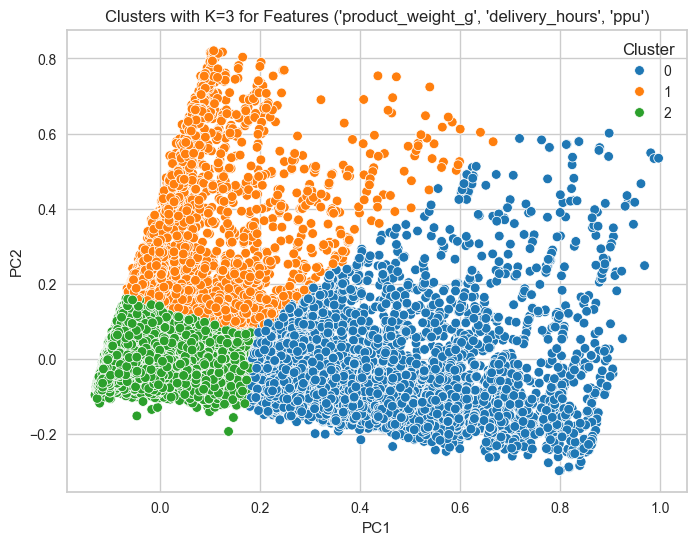

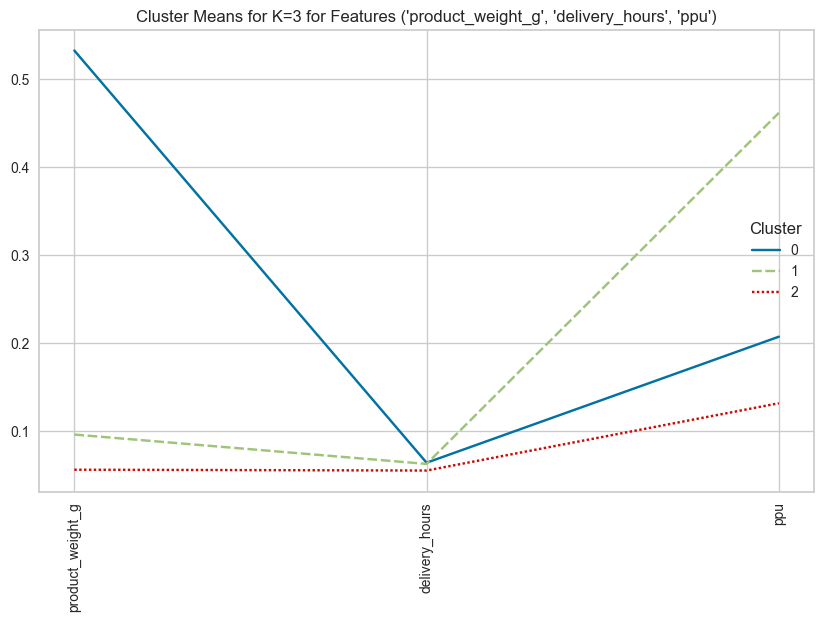

K=4에 대한 클러스터링 진행 중...


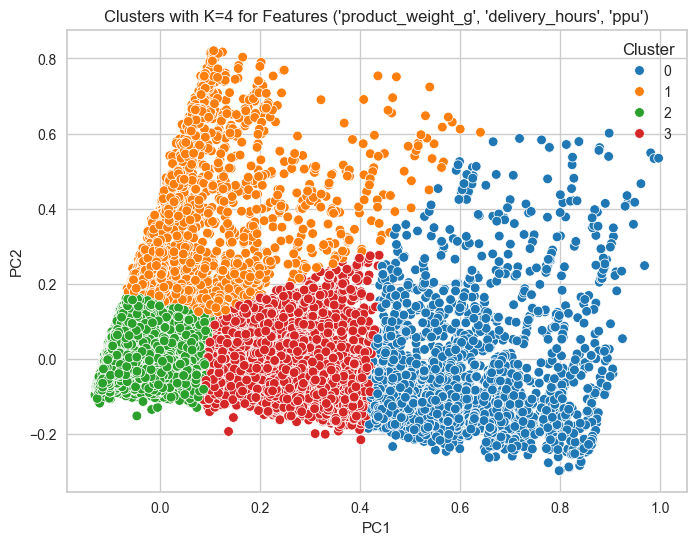

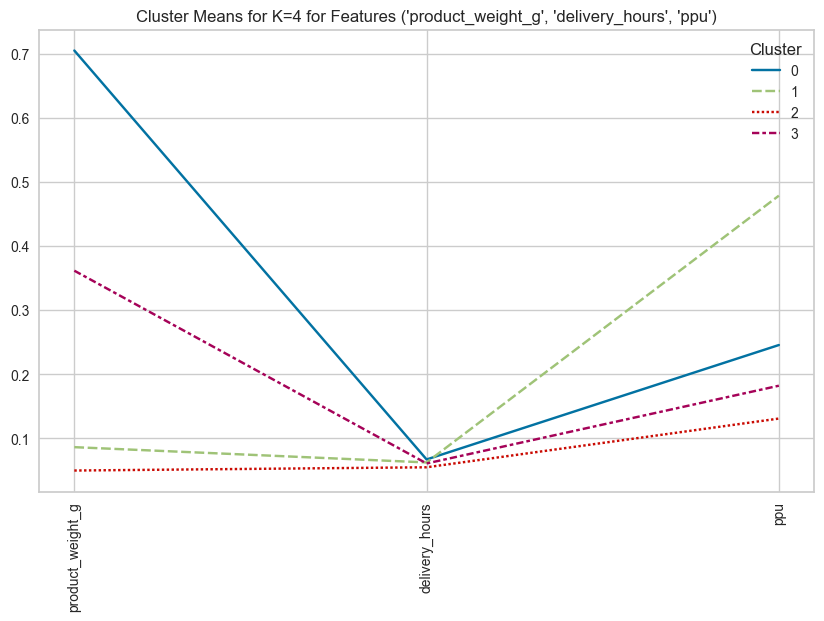

Features: ('volume', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


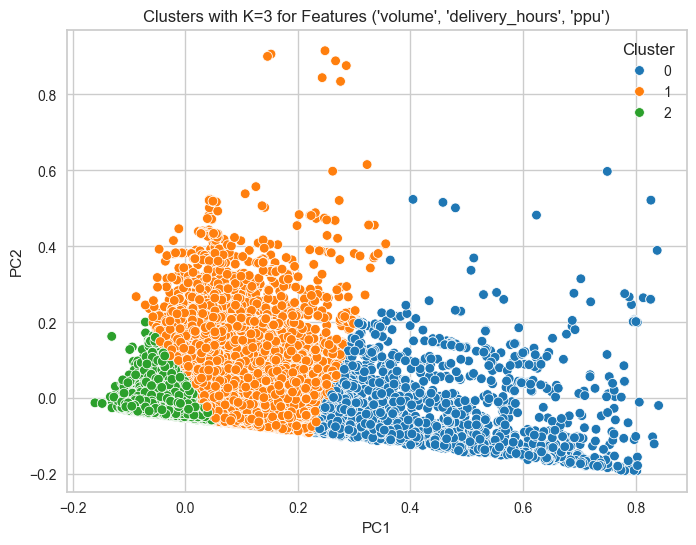

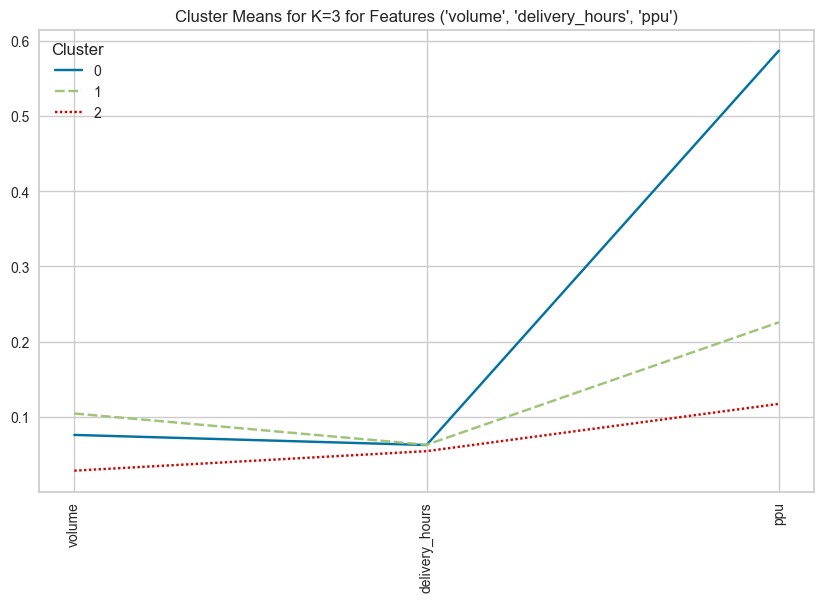

K=4에 대한 클러스터링 진행 중...


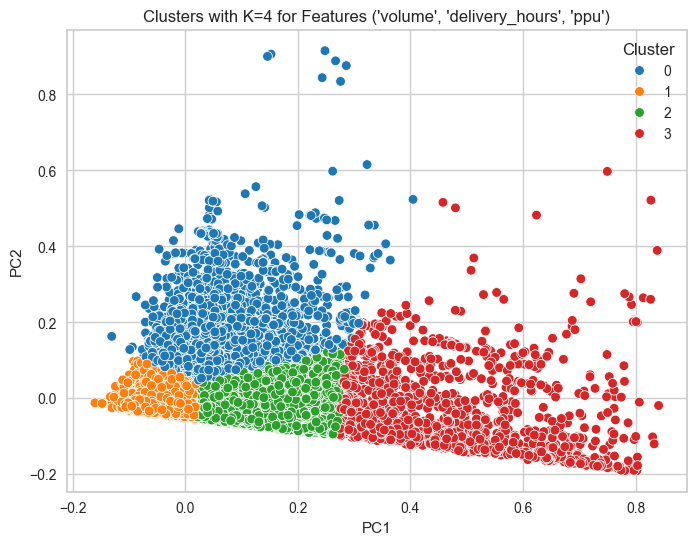

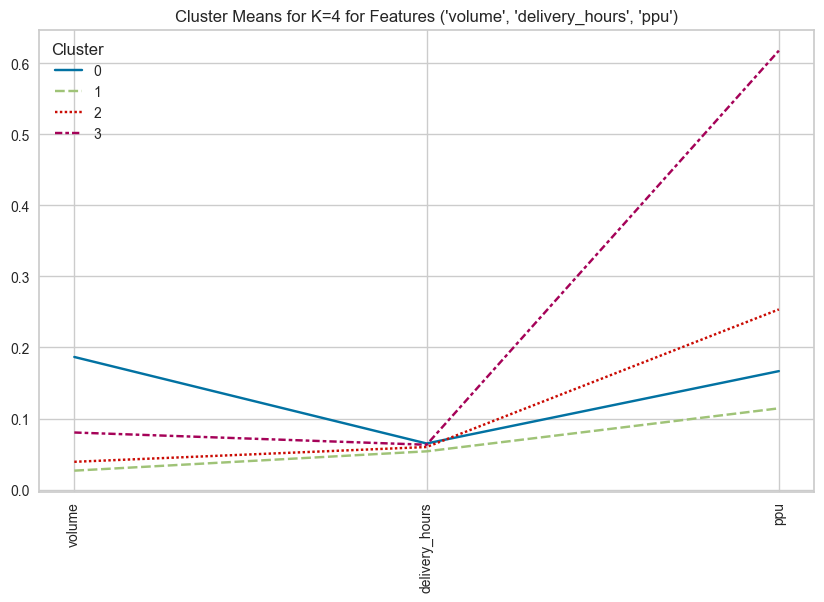

Features: ('Diff_days', 'product_weight_g', 'volume', 'delivery_hours')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


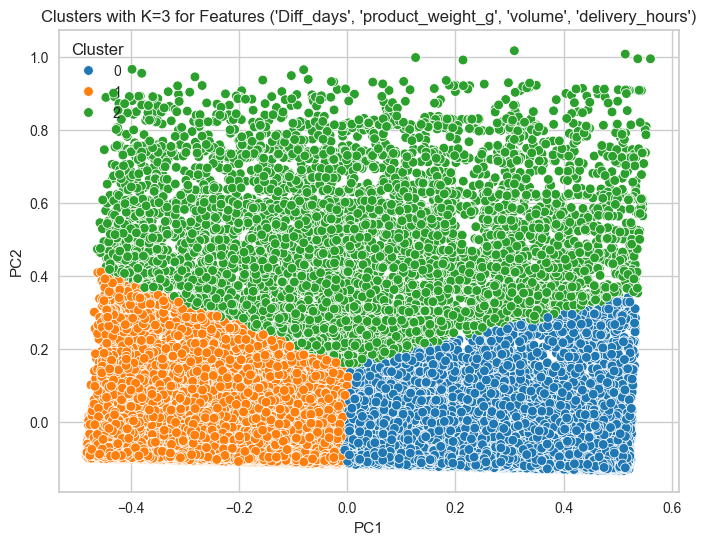

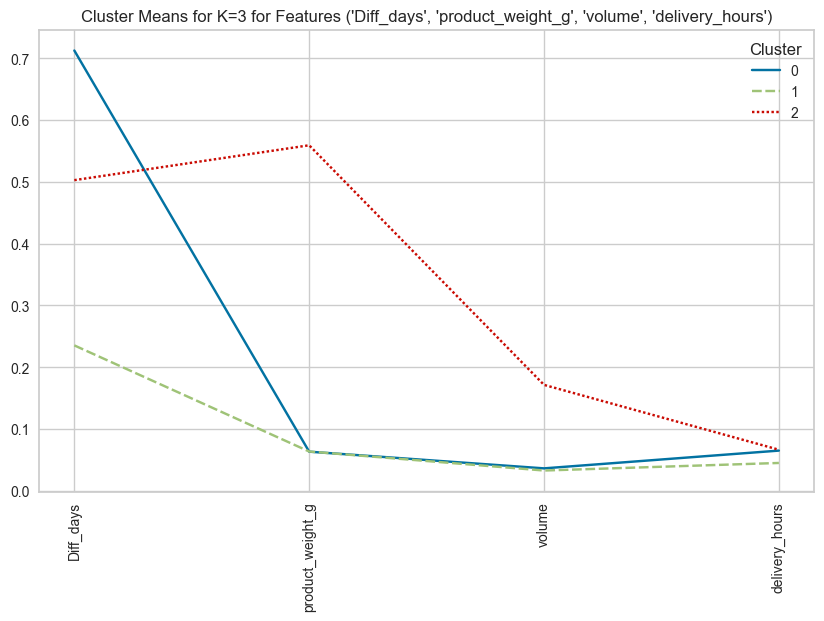

K=4에 대한 클러스터링 진행 중...


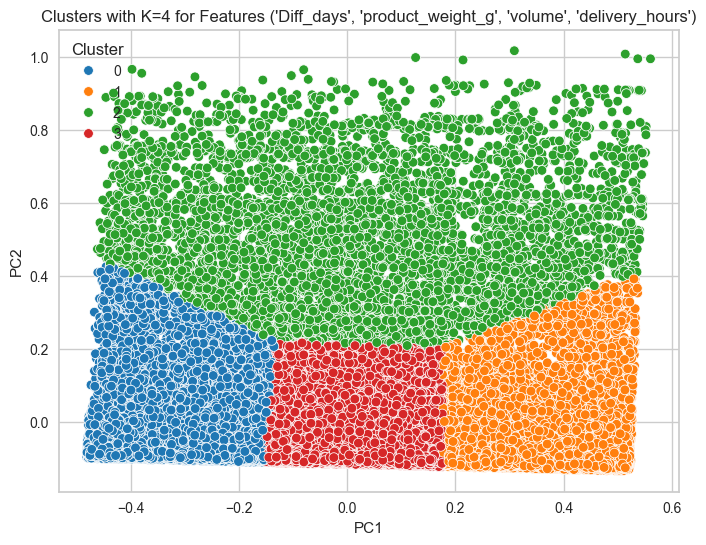

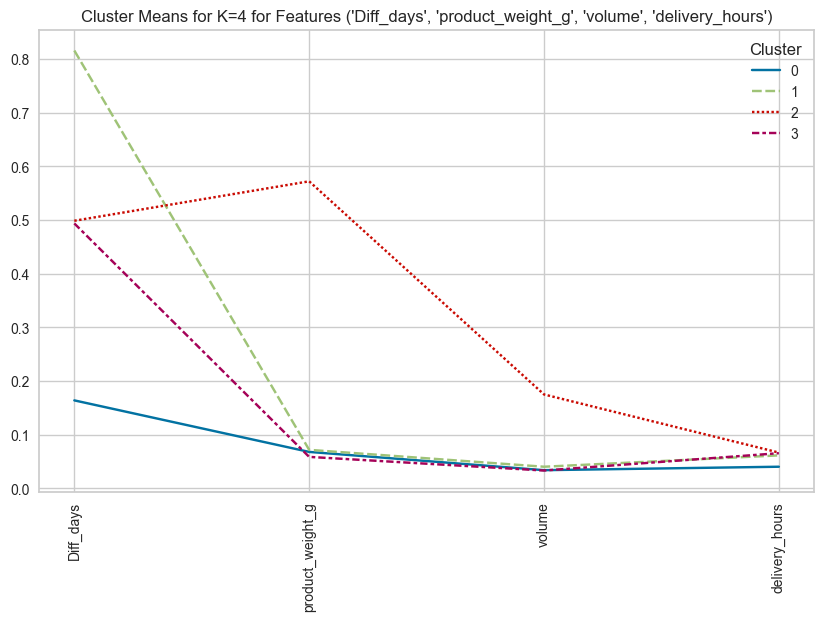

Features: ('Diff_days', 'product_weight_g', 'volume', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


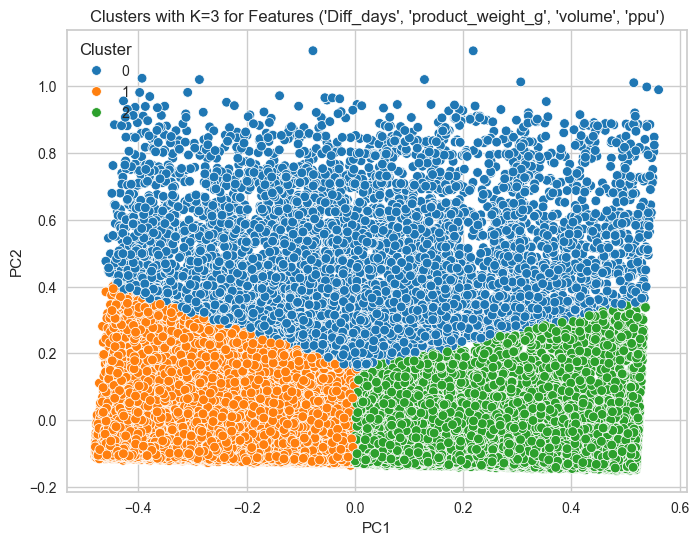

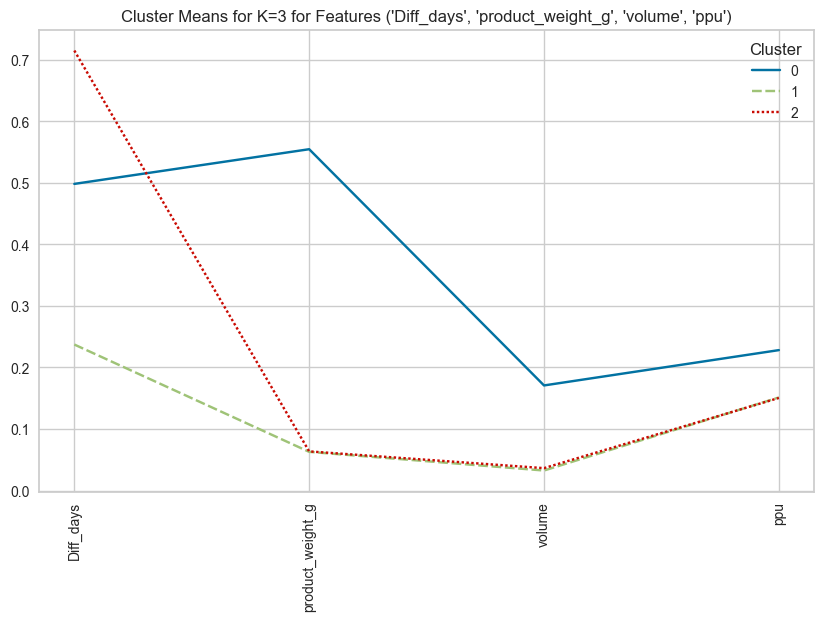

K=4에 대한 클러스터링 진행 중...


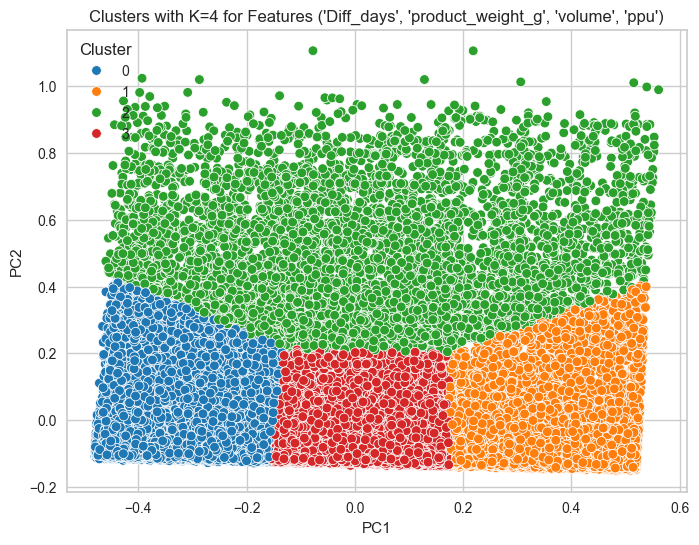

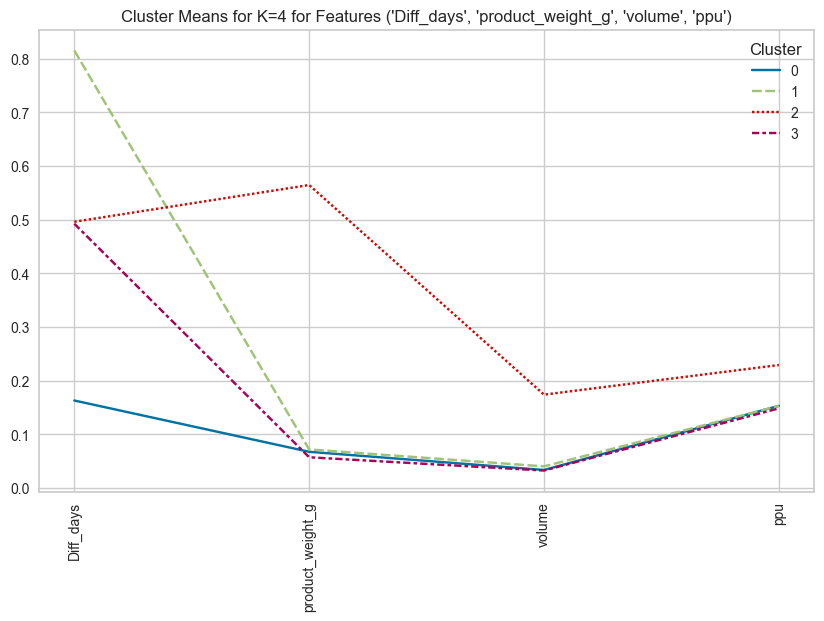

Features: ('Diff_days', 'product_weight_g', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


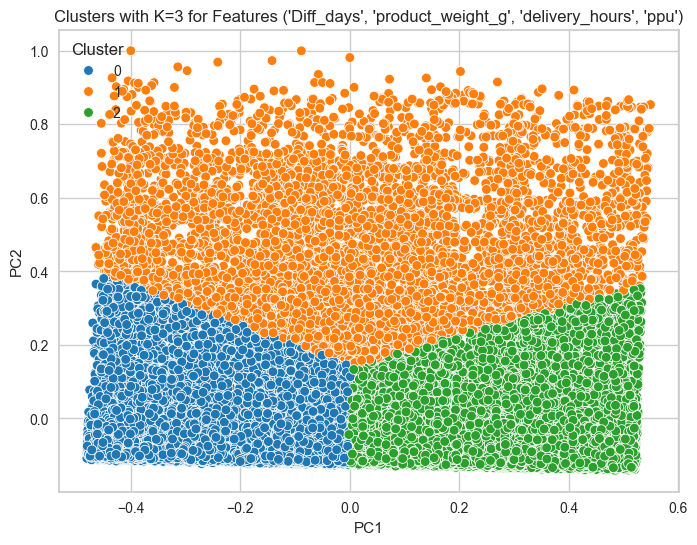

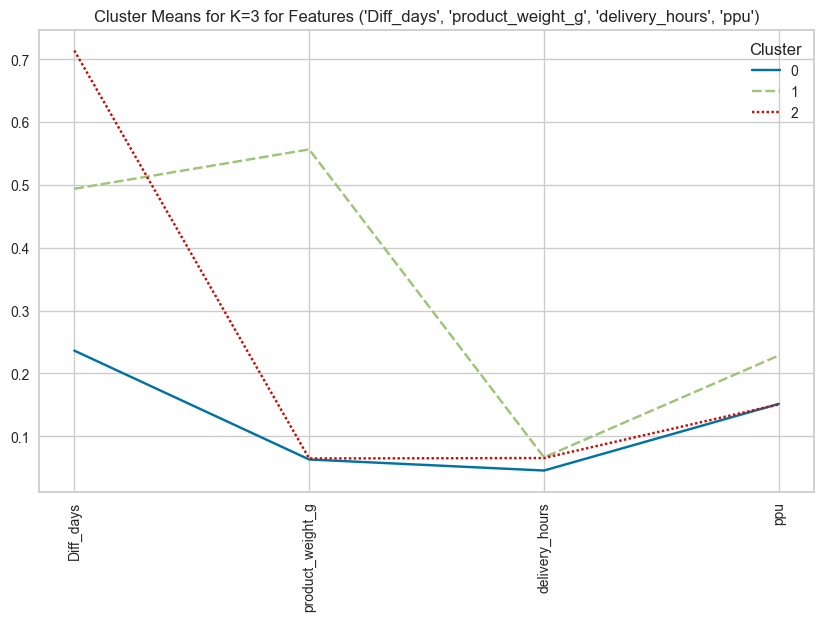

K=4에 대한 클러스터링 진행 중...


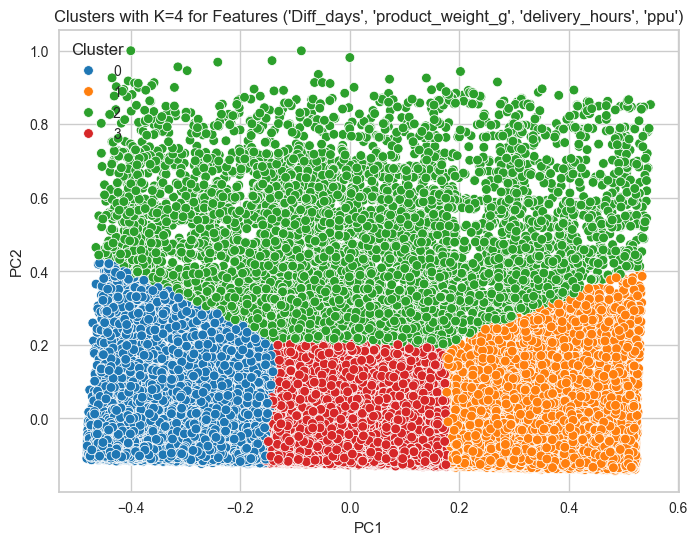

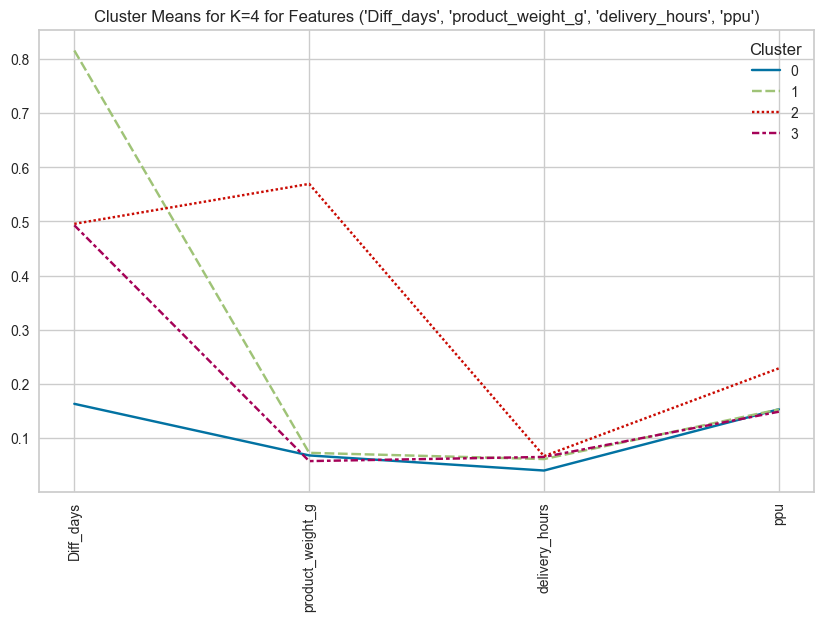

Features: ('Diff_days', 'volume', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


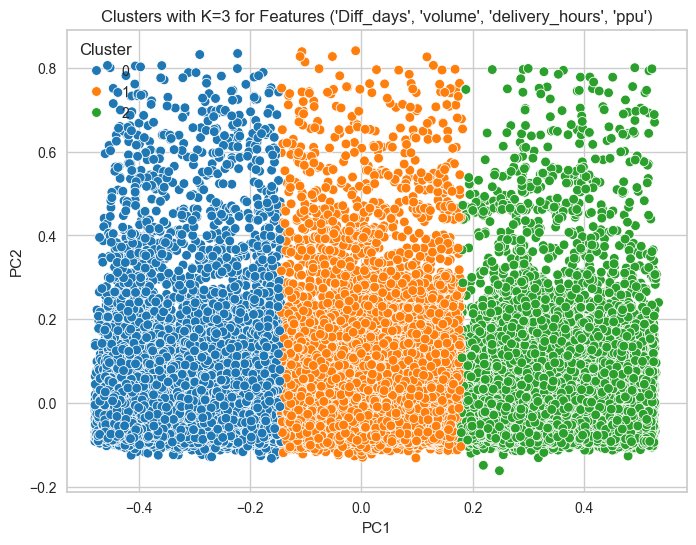

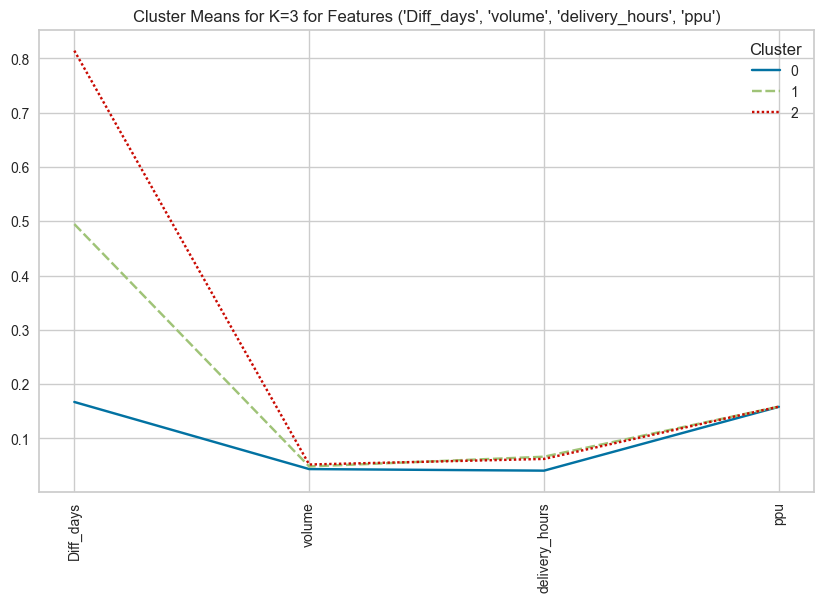

K=4에 대한 클러스터링 진행 중...


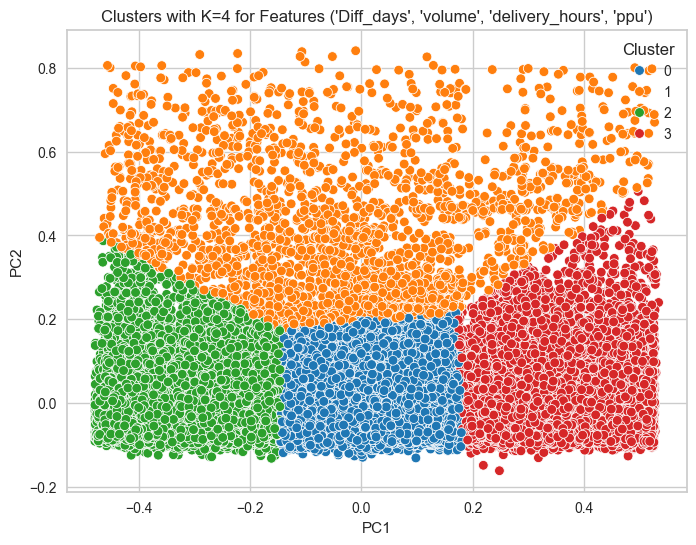

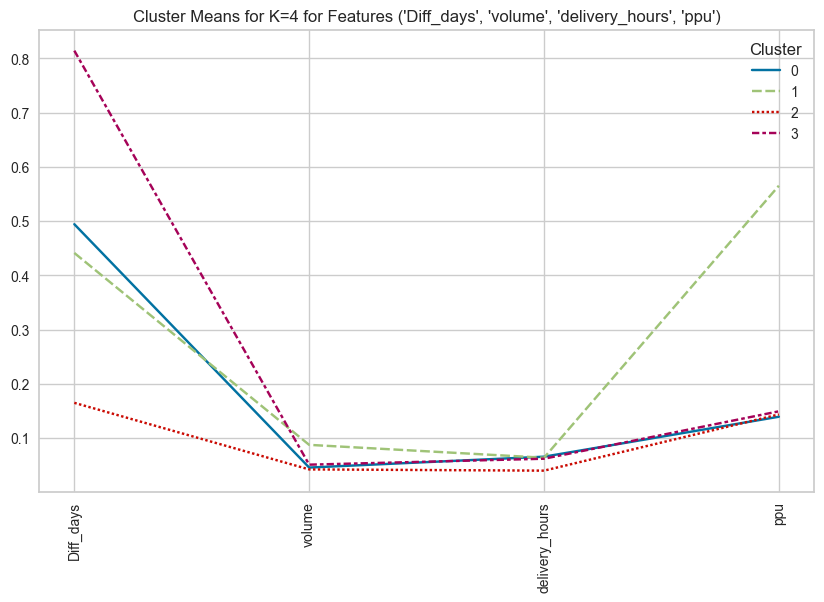

Features: ('product_weight_g', 'volume', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


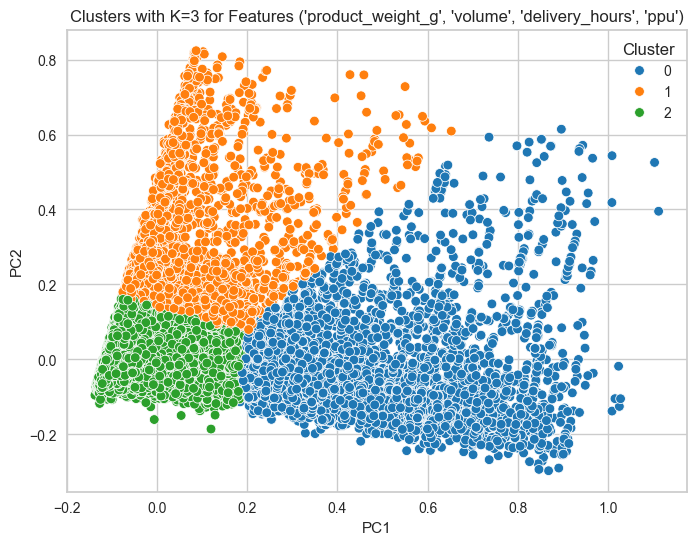

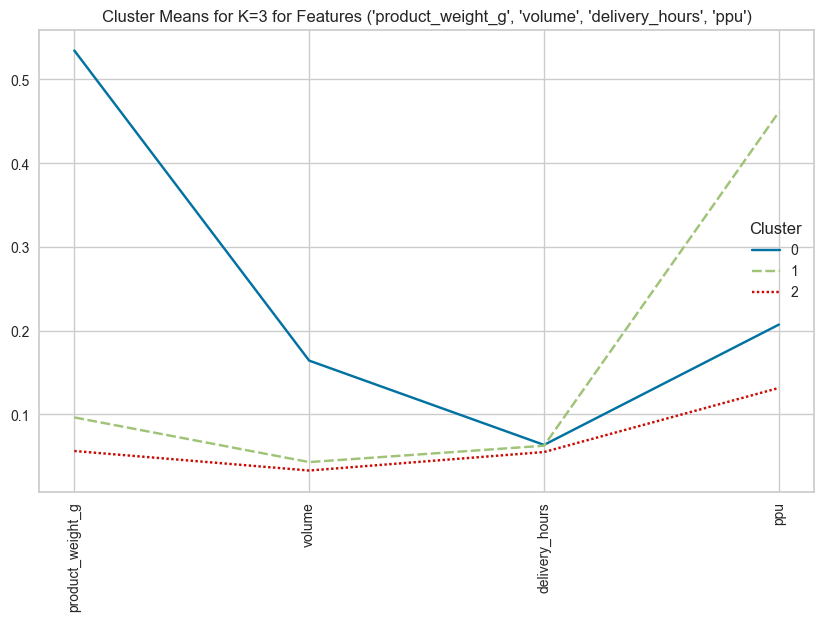

K=4에 대한 클러스터링 진행 중...


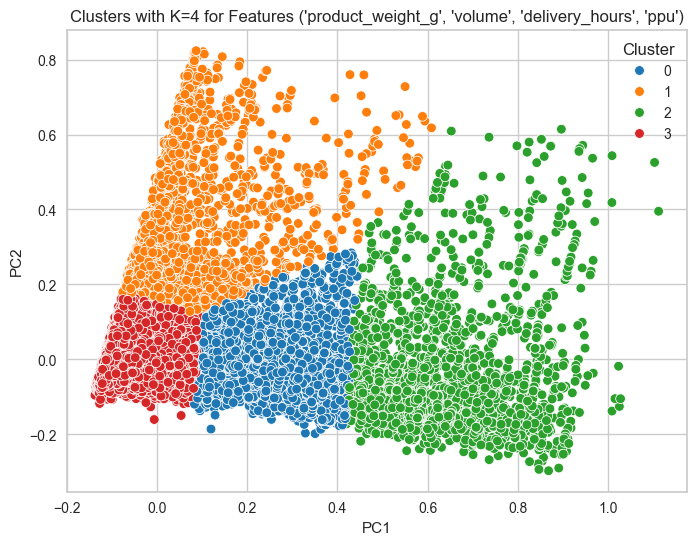

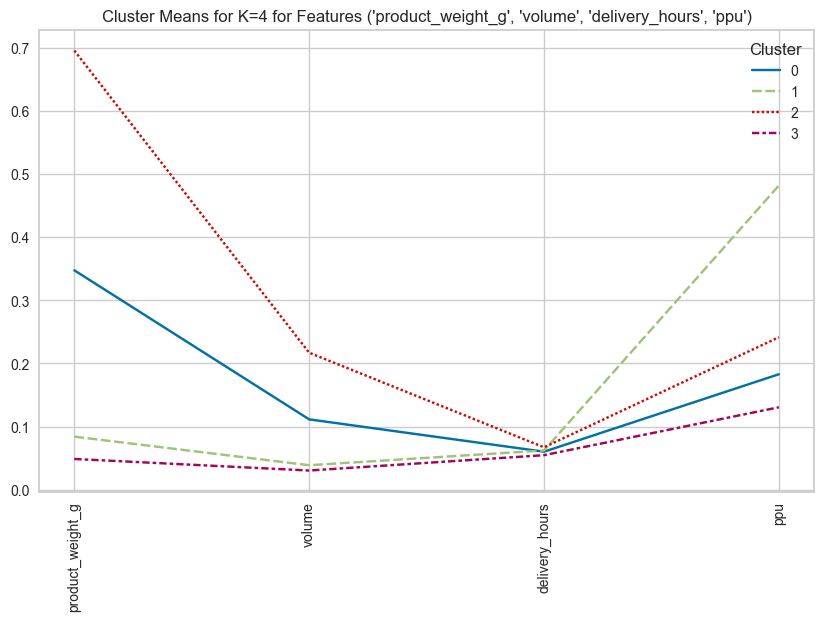

Features: ('Diff_days', 'product_weight_g', 'volume', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
K=3에 대한 클러스터링 진행 중...


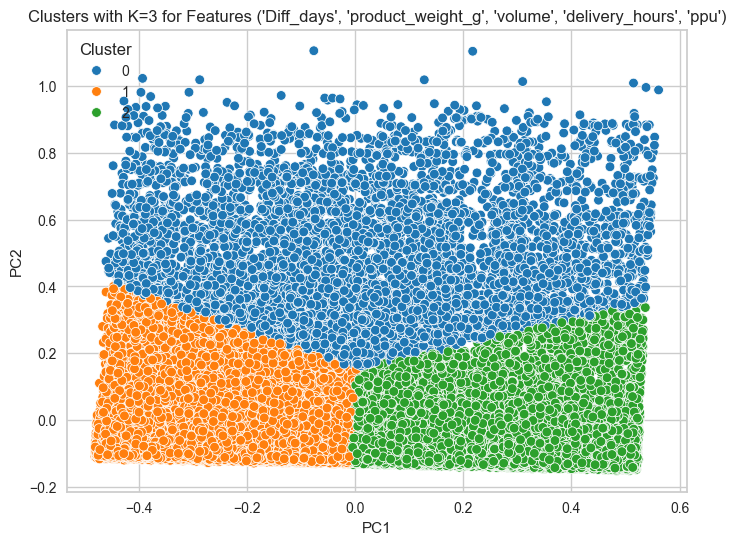

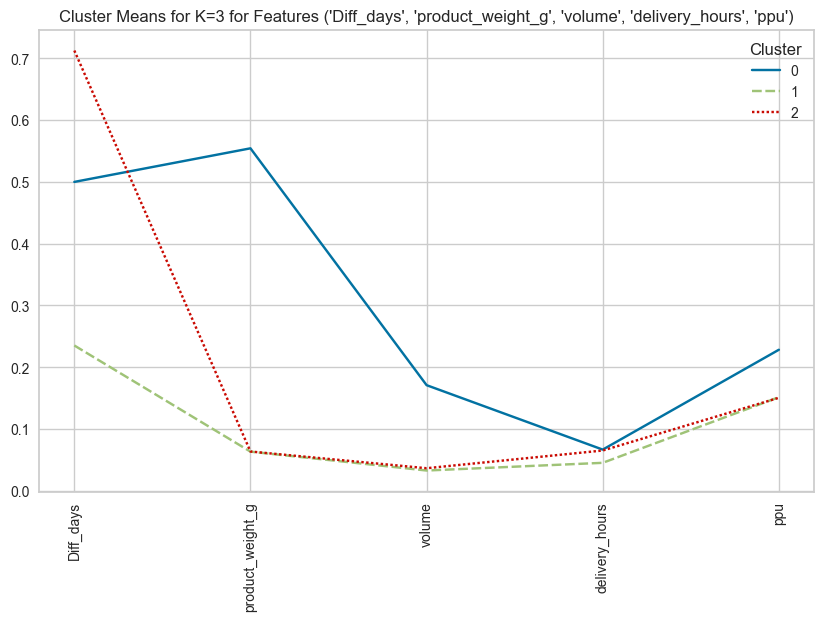

K=4에 대한 클러스터링 진행 중...


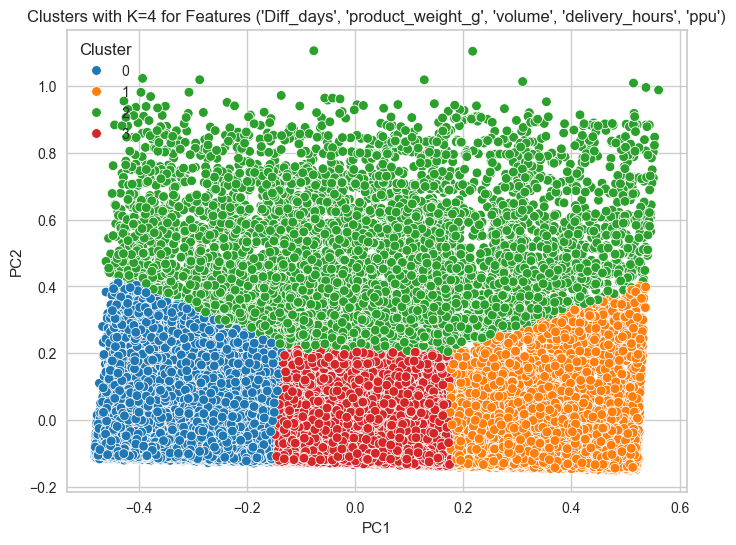

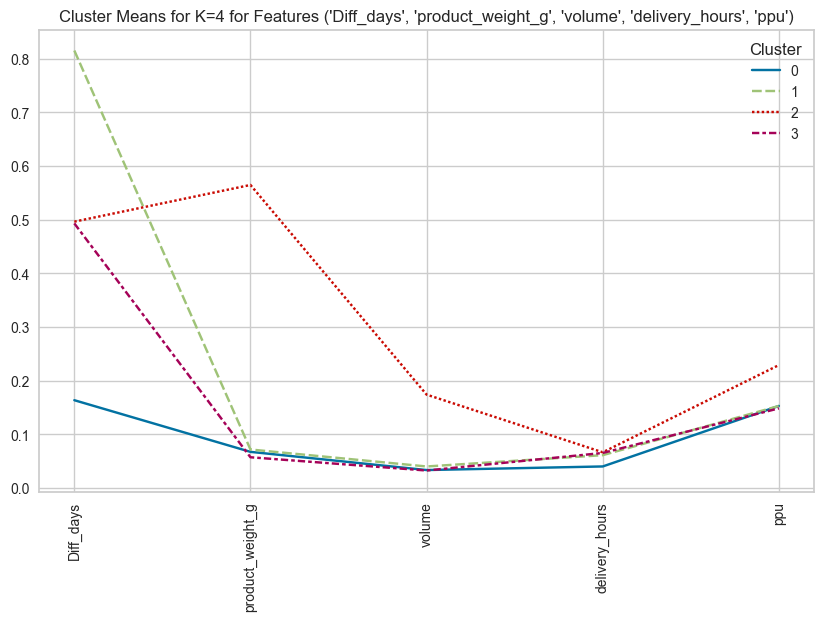

{('Diff_days',
  'product_weight_g',
  'volume'): {3: {'kmeans_model': KMeans(init='random', n_clusters=3, random_state=42),
   'labels': array([2, 2, 1, ..., 0, 2, 1], dtype=int32),
   'cluster_centers': array([[ 0.04307749,  0.46346188],
          [-0.24170118, -0.04100958],
          [ 0.23494608, -0.05676244]])}, 4: {'kmeans_model': KMeans(init='random', n_clusters=4, random_state=42),
   'labels': array([1, 3, 0, ..., 2, 1, 0], dtype=int32),
   'cluster_centers': array([[-0.3135449 , -0.03472894],
          [ 0.33813048, -0.05140776],
          [ 0.03871013,  0.47682335],
          [ 0.01566817, -0.05505647]])}},
 ('Diff_days',
  'product_weight_g',
  'delivery_hours'): {3: {'kmeans_model': KMeans(init='random', n_clusters=3, random_state=42),
   'labels': array([0, 0, 1, ..., 2, 0, 1], dtype=int32),
   'cluster_centers': array([[ 0.23553165, -0.05317831],
          [-0.24202342, -0.04014722],
          [ 0.03629578,  0.45056108]])}, 4: {'kmeans_model': KMeans(init='random', n_clu

In [288]:
perform_kmeans_clustering(merged_df, range(3, 5), feature_names = ['Diff_days', 'product_weight_g', 'volume', 'delivery_hours', 'ppu'], random_state=42)

In [248]:
final_result

,Diff_days,shipping_charges,volume,delivery_hours,Cluster
0,0.961538,0.320550,0.072914,0.221918,0
1,0.623626,0.431018,0.303568,0.232877,0
2,0.057692,0.308490,0.048435,0.173973,3
3,0.719780,0.285818,0.054946,0.249315,0
4,0.445055,0.280994,0.121349,0.300000,3
...,...,...,...,...,...
62910,0.837912,0.824650,0.049824,0.665753,2
62911,0.195055,0.483116,0.107461,0.509589,1
62912,0.126374,0.881090,0.961156,0.282192,1
62913,0.848901,0.408828,0.204158,0.130137,0


In [251]:
merged_result

,Diff_days,shipping_charges,volume,delivery_hours,Cluster
0,351,13.29,3528.0,182.0,0
1,228,17.87,14157.0,190.0,0
2,22,12.79,2400.0,147.0,3
3,263,11.85,2700.0,202.0,0
4,163,11.65,5760.0,239.0,3
...,...,...,...,...,...
62910,306,34.19,2464.0,506.0,2
62911,72,20.03,5120.0,392.0,1
62912,47,36.53,44460.0,226.0,1
62913,310,16.95,9576.0,115.0,0


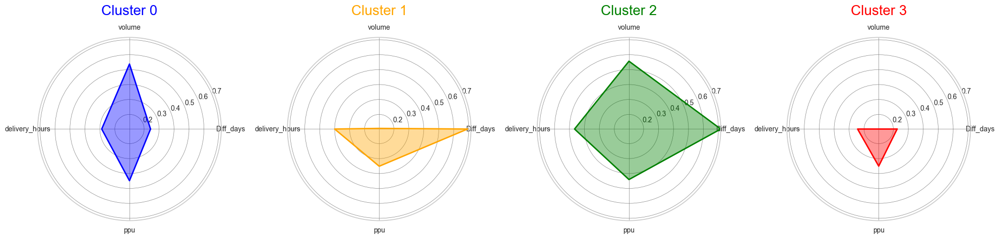

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

final_result

# 각 클러스터의 중심점 계산
cluster_centroids = final_result.groupby('Cluster').mean()

# 레이더 차트를 그리는 함수
def create_radar_chart(ax, angles, data, color, cluster, min_val, max_val):
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2, linestyle='solid')

    ax.set_ylim(min_val, max_val)  # 동일한 축 범위 적용
    ax.set_title(f'Cluster {cluster}', size=20, color=color, y=1.1)

# 레이블 설정
labels = np.array(cluster_centroids.columns)
num_vars = len(labels)

# 각 축의 각도 계산
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# 플롯이 원형이기 때문에 첫 번째 값을 끝에 추가하여 루프를 완성
labels = np.concatenate((labels, [labels[0]]))
angles += angles[:1]

# Find the min and max values across all clusters to set uniform axis range
min_val = cluster_centroids.min().min()  # 최소값
max_val = cluster_centroids.max().max()  # 최대값

# 그림 초기화
fig, ax = plt.subplots(figsize=(20, 10), subplot_kw=dict(polar=True), nrows=1, ncols=len(cluster_centroids))

# 각 클러스터에 대해 레이더 차트를 그리기
colors = ['blue', 'orange', 'green', 'red', 'purple']  # 클러스터 색상 정의

for i, color in enumerate(colors[:len(cluster_centroids)]):
    data = cluster_centroids.loc[i].tolist()
    data += data[:1]  # 루프를 완성
    create_radar_chart(ax[i], angles, data, color, i, min_val, max_val)

# 입력 데이터 추가
for a in ax:
    a.set_xticks(angles[:-1])
    a.set_xticklabels(labels[:-1])

# 그리드 추가
for a in ax:
    a.grid(color='grey', linewidth=0.5)

# 플롯 표시
plt.tight_layout()
plt.show()


In [290]:
pca_df

,PC1,PC2,Cluster
0,0.407220,-0.226623,1
1,0.125270,0.142751,2
2,-0.459588,-0.154997,3
3,0.186398,-0.232254,1
4,-0.039495,-0.028683,3
...,...,...,...
62731,-0.004367,-0.170677,1
62732,0.438379,-0.194386,1
62733,-0.205663,-0.004768,3
62734,0.285698,-0.069886,1


In [293]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from tabulate import tabulate

# Compute number of customers
num_observations = len(pca_df)

# Separate the features and the cluster labels
X = pca_df.drop('Cluster', axis=1)
clusters = pca_df['Cluster']

# Compute the metrics
sil_score = silhouette_score(X, clusters)
calinski_score = calinski_harabasz_score(X, clusters)
davies_score = davies_bouldin_score(X, clusters)

# Create a table to display the metrics and the number of observations
table_data = [
    ["Number of Observations", num_observations],
    ["Silhouette Score", sil_score],
    ["Calinski Harabasz Score", calinski_score],
    ["Davies Bouldin Score", davies_score]
]

# Print the table
print(tabulate(table_data, headers=["Metric", "Value"], tablefmt='pretty'))


+-------------------------+--------------------+
|         Metric          |       Value        |
+-------------------------+--------------------+
| Number of Observations  |       62736        |
|    Silhouette Score     | 0.4479709117802217 |
| Calinski Harabasz Score | 59240.22141068874  |
|  Davies Bouldin Score   | 0.814640110882281  |
+-------------------------+--------------------+


Clustering Quality Inference

- The Silhouette Score of approximately 0.236, although not close to 1, still indicates a fair amount of separation between the clusters. It suggests that the clusters are somewhat distinct, but there might be slight overlaps between them. Generally, a score closer to 1 would be ideal, indicating more distinct and well-separated clusters.
- The Calinski Harabasz Score is 1257.17, which is considerably high, indicating that the clusters are well-defined. A higher score in this metric generally signals better cluster definitions, thus implying that our clustering has managed to find substantial structure in the data.
- The Davies Bouldin Score of 1.37 is a reasonable score, indicating a moderate level of similarity between each cluster and its most similar one. A lower score is generally better as it indicates less similarity between clusters, and thus, our score here suggests a decent separation between the clusters.

    >In conclusion, the metrics suggest that the clustering is of good quality, with clusters being well-defined and fairly separated. However, there might still be room for further optimization to enhance cluster separation and definition, potentially by trying other clustering and dimensionality reduction algorithms.